Import Libraries

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
from PIL import Image
import torch
import random 
import segmentation_models_pytorch as smp
from segmentation_models_pytorch import utils
import albumentations as albu
%matplotlib inline
import cv2
import py7zr

c:\Users\hal3k\deeplabv3segmentation\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.16 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
from PIL import Image
import torch
import random 
import segmentation_models_pytorch as smp
from segmentation_models_pytorch import utils
import albumentations as albu
%matplotlib inline
import cv2
import py7zr
import zipfile
import statistics
import shutil

c:\Users\hal3k\deeplabv3segmentation\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
INFO:albumentations.check_version:A new version of Albumentations is available: 1.4.14 (you have 1.4.11). Upgrade using: pip install --upgrade albumentations


Hyperparameters

In [2]:
# Encoder architecture for the segmentation model
ENCODER = 'resnet18'

# Use ImageNet pretrained weights for the encoder initialization
ENCODER_WEIGHTS = 'imagenet'

# Activation function applied to the output layer
ACTIVATION = 'softmax2d'

# Determine device to use (GPU if available, otherwise CPU)
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Other hyperparameters
batch_size = 2
EPOCHS = 100
lr = 1e-4
INFER_HEIGHT = 640
INFER_WIDTH = 640
# Number of epochs after which to decrease the learning rate
LR_DECREASE_STEP = 15

# Factor by which to decrease the learning rate LR_DECREASE_STEP epochs
LR_DECREASE_COEF = 2

# step size for quality when training models
step_size = 5   

In [4]:
# GPU check
# Check if CUDA is available
print("CUDA available:", torch.cuda.is_available())

# Print the number of GPUs available
print("Number of GPUs:", torch.cuda.device_count())

# Print the name of the GPU
if torch.cuda.is_available():
    print("GPU Name:", torch.cuda.get_device_name(0))
print(torch.version.cuda)

CUDA available: True
Number of GPUs: 1
GPU Name: NVIDIA GeForce RTX 3050 Laptop GPU
11.7


Dataset preperation

In [23]:
# Unzip Dataset
zip_path = "Excavators.7z"
extract_path = "{}{}".format("excavator_dataset_w_masks2", os.sep)
with py7zr.SevenZipFile(zip_path, mode='r') as archive:
    archive.extractall(path=extract_path)

In [4]:
# general compression function
def compress(image_raw_path, status):
    base_folder = "{}{}{}".format("excavator_dataset_w_masks2", os.sep,"dataset")
    for quality_value in range(0,101,1):
        quality_dir = os.path.join(base_folder, str(quality_value))
        os.makedirs(quality_dir, exist_ok=True)
        for image_file_name in os.listdir(image_raw_path):
            image_path = os.path.join(image_raw_path, image_file_name)
            if not image_file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                print(f"Skipping {image_file_name}: Not a valid image file")
                continue

            image = cv2.imread(image_path)
            if image is None:
                print(f"Skipping {image_file_name}: Unable to read the image")
                continue

            # Define the output file path
            output_folder = os.path.join(base_folder, str(quality_value), status)
            os.makedirs(output_folder, exist_ok=True)
            output_file_path = os.path.join(output_folder, f"Compressed_{image_file_name}")
            
            # Write the image with the specified JPEG quality
            success = cv2.imwrite(output_file_path, image, [cv2.IMWRITE_JPEG_QUALITY, quality_value])
            
            if not success:
                print(f"Failed to save {output_file_path}")
            else:
                print(f"Saved {output_file_path} with quality {quality_value}")

In [7]:
# Dataset class and visualization functions
import os
from PIL import Image
import json
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from torch.utils.data import Dataset as BaseDataset
from torchvision import transforms
import matplotlib.pyplot as plt
from glob import glob
import cv2
CLASSES = [
            "background",    # Class 0: Background
            "bulldozer",     # Class 1: Bulldozer
            "car",           # Class 2: Car
            "caterpillar",   # Class 3: Caterpillar
            "crane",         # Class 4: Crane
            "crusher",       # Class 5: Crusher
            "driller",       # Class 6: Driller
            "excavator",     # Class 7: Excavator
            "human",         # Class 8: Human
            "roller",        # Class 9: Roller
            "tractor",       # Class 10: Tractor
            "truck"          # Class 11: Truck
         ] 
colors_imshow = {
    "background": np.array([0, 0, 0]),
    "bulldozer": np.array([0, 183, 235]),
    "car": np.array([255, 255, 0]),
    "caterpillar": np.array([0, 16, 235]),
    "crane": np.array([199, 252, 0]),
    "crusher": np.array([255, 0, 140]),
    "driller": np.array([14, 122, 254]),
    "excavator": np.array([255, 171, 171]),
    "human": np.array([254, 0, 86]),
    "roller": np.array([255, 0, 255]),
    "tractor": np.array([128, 128, 0]),
    "truck": np.array([134, 34, 255]),
}
def _colorize_mask(mask: np.ndarray):
    """Colorizes a single-channel mask into a multichannel mask using predefined colors.

    Args:
        mask (np.ndarray): Single-channel mask where each pixel denotes a class.

    Returns:
        np.ndarray: Colorized mask with RGB channels representing different classes.
        dict: Dictionary containing square ratios of each class in the mask.
    """
    mask = mask.squeeze()  # Ensure the mask is squeezed to remove singleton dimensions
    colored_mask = np.zeros((*mask.shape, 3), dtype=np.int64)  # Initialize an empty colored mask
    square_ratios = {}  # Dictionary to store square ratios of each class

    # Iterate over each class code and corresponding class name
    for cls_code, cls in enumerate(CLASSES):
        cls_mask = mask == cls_code  # Create a mask for the current class
        square_ratios[cls] = cls_mask.sum() / cls_mask.size  # Calculate square ratio for the class
        colored_mask += np.multiply.outer(cls_mask, colors_imshow[cls]).astype(np.int64)  # Colorize the mask

    return colored_mask, square_ratios  # Return the colorized mask and square ratios

def reverse_normalize(img, mean, std):
    """Reverse normalization of an image.

    Args:
        img (np.ndarray): Normalized image.
        mean (list): Mean values used for normalization.
        std (list): Standard deviation values used for normalization.

    Returns:
        np.ndarray: Unnormalized image.
    """
    img = img * np.array(std) + np.array(mean)  # Reverse normalization
    return img  # Return the unnormalized image

def visualize_predicts(img: np.ndarray, mask_gt: np.ndarray, mask_pred: np.ndarray, normalized=False):
    """Visualizes the original image, ground truth mask, and predicted mask.

    Args:
        img (np.ndarray): Original image.
        mask_gt (np.ndarray): Ground truth mask.
        mask_pred (np.ndarray): Predicted mask.
        normalized (bool, optional): Whether the image is normalized. Defaults to False.
    """
    _, axes = plt.subplots(1, 3, figsize=(10, 5))  # Create subplots for image, GT mask, and predicted mask
    img = img.transpose(1, 2, 0)  # Transpose image dimensions to match matplotlib's format

    if normalized:
        # Reverse the normalization to get the unnormalized image
        img = reverse_normalize(img, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

    axes[0].imshow(img)  # Plot the original image
    mask_gt, square_ratios = _colorize_mask(mask_gt)  # Colorize the ground truth mask
    title = "Areas:\n" + "\n".join([f"{cls}: {square_ratios[cls]*100:.1f}%" for cls in CLASSES])
    axes[1].imshow(mask_gt, cmap="twilight")  # Plot the colorized ground truth mask
    axes[1].set_title(f"GT mask\n" + title)  # Set title for ground truth mask subplot

    mask_pred, square_ratios = _colorize_mask(mask_pred)  # Colorize the predicted mask
    title = "Areas:\n" + "\n".join([f"{cls}: {square_ratios[cls]*100:.1f}%" for cls in CLASSES])
    axes[2].imshow(mask_pred, cmap="twilight")  # Plot the colorized predicted mask
    axes[2].set_title(f"PRED mask\n" + title)  # Set title for predicted mask subplot

    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()  # Display the plot

def visualize_multichannel_mask(image, multichannel_mask, class_names):
    # Dictionary mapping class names to RGB colors for visualization
    colors_imshow = {
        "background": np.array([0, 0, 0]),
        "bulldozer": np.array([0, 183, 235]),
        "car": np.array([255, 255, 0]),
        "caterpillar": np.array([0, 16, 235]),
        "crane": np.array([199, 252, 0]),
        "crusher": np.array([255, 0, 140]),
        "driller": np.array([14, 122, 254]),
        "excavator": np.array([255, 171, 171]),
        "human": np.array([254, 0, 86]),
        "roller": np.array([255, 0, 255]),
        "tractor": np.array([128, 128, 0]),
        "truck": np.array([134, 34, 255]),
    }

    # Helper function to convert multichannel mask to single channel and calculate class ratios
    def _convert_multichannel2singlechannel(mc_mask):
        sc_mask = np.zeros((mc_mask.shape[0], mc_mask.shape[1], 3), dtype=np.int64)
        square_ratios = {}

        # Iterate over each channel in the multichannel mask
        for i, singlechannel_mask in enumerate(mc_mask.transpose(2, 0, 1)):
            cls = class_names[i]  # Get the class name from class_names list
            singlechannel_mask = singlechannel_mask.squeeze()  # Remove singleton dimensions if any

            # Calculate ratio of pixels belonging to the class
            square_ratios[cls] = singlechannel_mask.sum() / singlechannel_mask.size

            # Generate the single channel mask by multiplying the mask with the color and adding to sc_mask
            sc_mask += np.multiply.outer(singlechannel_mask > 0, colors_imshow[cls]).astype(np.int64)

        # Generate the title for the visualization based on class ratios
        title = "Areas: " + "\n".join([f"{cls}: {square_ratios[cls]*100:.1f}%" for cls in class_names])
        return sc_mask, title

    # Create subplots for image and mask visualization
    _, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    # Display the original image
    axes[0].imshow(image)
    
    # Convert multichannel mask to single channel and display alongside the image
    mask_to_show, title = _convert_multichannel2singlechannel(multichannel_mask)
    axes[1].imshow(mask_to_show.astype(np.uint8))  # Convert mask to uint8 for display
    axes[1].set_title(title)  # Set title displaying class ratios
    
    # Adjust layout for better visualization
    plt.tight_layout()
    plt.show()



            
# create class for dataset
class Excavators(BaseDataset):
    def __init__(self, images_dir, masks_dir, labels_dir, augmentation=None, preprocessing=None, compression=None):
        """
        Initializes the Dataset object.

        Args:
            images_dir (str): Directory containing the input images.
            masks_dir (str): Directory containing the corresponding masks.
            augmentation (callable, optional): Optional augmentation function to be applied to images and masks.
            preprocessing (callable, optional): Optional preprocessing function to be applied to images and masks.
        """
        # Load and sort paths to images and masks
        self.images_paths, self.masks_paths = self._get_sorted_paths(images_dir, masks_dir)
        print(f"Loaded {len(self.images_paths)} images from {images_dir}")
        print(f"Loaded {len(self.masks_paths)} masks from {masks_dir}")

        # Load class colors from a file
        self.cls_colors = self._get_classes_colors(labels_dir)

        # Store augmentation and preprocessing functions
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        self.compression = compression

    def _get_sorted_paths(self, images_dir, masks_dir):
        """
        Retrieves and sorts paths to images and masks.

        Args:
            images_dir (str): Directory containing the input images.
            masks_dir (str): Directory containing the corresponding masks.

        Returns:
            tuple: Two lists containing sorted paths to images and masks.
        """
        # Retrieve paths using glob and sort them based on filenames
        images_paths = glob("{}{}{}".format(images_dir,os.sep,"*"))
        masks_paths = glob("{}{}{}".format(masks_dir,os.sep,"*"))
        
        images_paths.sort(key=lambda x: os.path.basename(x))
        masks_paths.sort(key=lambda x: os.path.basename(x))
        
        return images_paths, masks_paths

    def _get_classes_colors(self, label_colors_dir):
        """
        Loads class colors from a text file.

        Args:
            label_colors_dir (str): Path to the file containing class colors.

        Returns:
            dict: Dictionary mapping class names to RGB color tuples.
        """
        cls_colors = {}
        with open(label_colors_dir) as file:
            while line := file.readline():
                B, G, R, label = line.rstrip().split()
                cls_colors[label] = (int(R), int(G), int(B))  # Store colors as RGB tuple
        CLASSES = [
            "background",    # Class 0: Background
            "bulldozer",     # Class 1: Bulldozer
            "car",           # Class 2: Car
            "caterpillar",   # Class 3: Caterpillar
            "crane",         # Class 4: Crane
            "crusher",       # Class 5: Crusher
            "driller",       # Class 6: Driller
            "excavator",     # Class 7: Excavator
            "human",         # Class 8: Human
            "roller",        # Class 9: Roller
            "tractor",       # Class 10: Tractor
            "truck"          # Class 11: Truck
        ] 
        # Order colors according to predefined class order (CLASSES)
        keyorder = CLASSES
        cls_colors_ordered = {}
        for k in keyorder:
            if k in cls_colors:
                cls_colors_ordered[k] = cls_colors[k]
            elif k == "background":
                cls_colors_ordered[k] = (0, 0, 0)  # Black background if not specified
            else:
                raise ValueError(f"Unexpected label {k}, cls colors: {cls_colors}")

        return cls_colors_ordered

    def __getitem__(self, i):
        """
        Retrieves an image and its corresponding masks from the dataset.

        Args:
            i (int): Index of the image and mask pair to retrieve.

        Returns:
            tuple: Processed image and masks as NumPy arrays.
        """
        # Load image and mask from the paths
        image_path = self.images_paths[i]
        mask_path = self.masks_paths[i]
        image = np.array(Image.open(image_path).convert('RGB'))
        mask = np.array(Image.open(mask_path).convert('RGB'))

        # Initialize multichannel masks
        masks = np.zeros((mask.shape[0], mask.shape[1], len(self.cls_colors)), dtype=np.float32)
        
        # Generate masks for each class based on color
        for idx, (cls_name, color) in enumerate(self.cls_colors.items()):
            # Define lower boundary for the color (in RGB)
            lower = np.array(color, dtype=np.uint8)
            
            # Create a mask for the current class
            class_mask = np.all(mask == lower, axis=-1)
            
            # Convert to binary mask (0 or 1 values)
            class_mask = class_mask.astype(np.float32)
            
            # Assign the mask to the corresponding channel in masks
            masks[:, :, idx] = class_mask
        
        # Apply augmentations if provided
        if self.augmentation:
            sample = self.augmentation(image=image, mask=masks)
            image, masks = sample["image"], sample["mask"]

        # Apply preprocessing if provided
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=masks)
            image, masks = sample["image"], sample["mask"]

        return image, masks

    def __len__(self):
        """
        Returns the number of images in the dataset.

        Returns:
            int: Number of images in the dataset.
        """
        return len(self.images_paths)

In [8]:
# create instances of classes
# define relevant directories for the dataset class
training_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Train",os.sep)
training_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Trainannot",os.sep)
labels_directory = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"label_colors.txt")
val_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validation",os.sep)
val_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validationannot",os.sep)
test_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Test",os.sep)
test_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Testannot",os.sep)

#create instances of training and validation datasets
training_dataset = Excavators(training_data_directory, training_masks_directory, labels_directory)
validation_dataset = Excavators(val_data_directory, val_masks_directory, labels_directory)

Loaded 616 images from excavator_dataset_w_masks2\dataset\Train\
Loaded 616 masks from excavator_dataset_w_masks2\dataset\Trainannot\
Loaded 116 images from excavator_dataset_w_masks2\dataset\Validation\
Loaded 116 masks from excavator_dataset_w_masks2\dataset\Validationannot\


Compress Datasets

In [27]:
# directories for image_raw_path
train_data_directory ="{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Train",os.sep)
val_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validation",os.sep)
# compress training and validation datasets
compress(train_data_directory, 'Train')
compress(val_data_directory, 'Validation')

Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_002800_jpg.rf.5f4d7954bdc2b8be622a921b8b3cd917.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_425f8f79df14bf65f3cb0036d2429182_jpg.rf.176ca910d4eb5056a04283e1c77c237c.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_002733_jpg.rf.1260d44e892e20421cfbd79efffb5397.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_002786_jpg.rf.40ac12e94bbe394df36da847f2b013e6.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_0040103_jpg.rf.17447a600619e08f48a3aa133fda7d24.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_c84e9cfa8a049bc23b51d37e2e740f7e_jpg.rf.2a2f00283f3736d57ec3e824de0c6dfc.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset/0/Train/Compressed_2addeaa994d98de7ce3af88347271abc_jpeg_jpg.rf.a66ae0b63841503b8fa19809e716e337.jpg with quality 0
Saved excavator_dataset_w_masks2\d

Augmentation of Datasets

In [9]:
def get_training_augmentation():
    """
    Returns augmentation pipeline for training images.
    """
    train_transform = [
        albu.HorizontalFlip(p=0.5),  # Horizontal flip with 50% probability

        albu.LongestMaxSize(max_size=INFER_HEIGHT, always_apply=True),  # Resize the longest side of the image to INFER_HEIGHT
        albu.PadIfNeeded(min_height=int(INFER_HEIGHT*1.1), min_width=int(INFER_WIDTH*1.1), border_mode=2, always_apply=True),  # Pad the image if needed to ensure the minimum height and width
        albu.RandomCrop(height=INFER_HEIGHT, width=INFER_WIDTH, always_apply=True),  # Randomly crop the image to INFER_HEIGHT x INFER_WIDTH

        albu.OneOf(
            [
                albu.Sharpen(alpha=(0.1, 0.2), lightness=(0.1, 0.2), p=0.5),  # Apply sharpening with probability 50%
                albu.Blur(blur_limit=[1, 3], p=0.5),  # Apply blurring with probability 50%
                albu.GaussNoise(var_limit=(1, 5), p=0.5),  # Apply Gaussian noise with probability 50%
            ],
            p=0.7,  # Probability of applying any augmentation from the OneOf list
        ),
        albu.OneOf(
            [
                albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),  # Random brightness/contrast adjustment with probability 50%
                albu.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=10, val_shift_limit=5, p=0.5),  # Random hue/saturation/value adjustment with probability 50%
                albu.RGBShift(r_shift_limit=10, g_shift_limit=10, b_shift_limit=10, p=0.5),  # Random RGB shift with probability 50%
            ],
            p=0.7,  # Probability of applying any color augmentation from the OneOf list
        ),
    ]
    return albu.Compose(train_transform)


def get_validation_augmentation():
    """
    Returns augmentation pipeline for validation/testing images.
    """
    test_transform = [
        albu.LongestMaxSize(max_size=INFER_HEIGHT, always_apply=True),  # Resize the longest side of the image to INFER_HEIGHT
        albu.PadIfNeeded(min_height=INFER_HEIGHT, min_width=INFER_WIDTH, border_mode=2, always_apply=True),  # Pad the image if needed to ensure height=INFER_HEIGHT and width=INFER_WIDTH
        albu.CenterCrop(height=INFER_HEIGHT, width=INFER_WIDTH, always_apply=True),  # Crop the center of the image to INFER_HEIGHT x INFER_WIDTH
    ]
    return albu.Compose(test_transform)


def to_tensor(x, **kwargs):
    """
    Convert image/mask to tensor format.
    
    Args:
        x (numpy.ndarray): Input image or mask.
        kwargs: Additional arguments (not used in this function).

    Returns:
        numpy.ndarray: Transposed and converted to float32 tensor.
    """
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn):
    """
    Constructs preprocessing transform.

    Args:
        preprocessing_fn (callable): Data normalization function.

    Returns:
        albumentations.Compose: Preprocessing transform.
    """
    _transform = [
        albu.Lambda(image=preprocessing_fn),  # Apply preprocessing function to image
        albu.Lambda(image=to_tensor, mask=to_tensor),  # Convert image and mask to tensor format
    ]
    return albu.Compose(_transform)

In [10]:
# define preprocessing
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)
# Classic approach: divide pixel values by 255 to normalize between [0, 1]
# preprocessing_fn = lambda img, **kwargs: img.astype("float32") / 255
preprocessing_fn

functools.partial(<function preprocess_input at 0x000001B0102EAD40>, input_space='RGB', input_range=[0, 1], mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

TRAINING LOOP for a single model variant

In [9]:
# training loop for a single model
# define training loop function
def training_loop(model, optimizer, train_loader,val_loader, train_epoch, valid_epoch, save_path, jit_save_path):
    #TRAININGTYME
    max_score = 0

    loss_logs = {"train": [], "val": []}
    metric_logs = {"train": [], "val": []}
    for i in range(0, EPOCHS):
        
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        train_loss, train_metric_IOU = list(train_logs.values())
        loss_logs["train"].append(train_loss)
        metric_logs["train"].append(train_metric_IOU)

        valid_logs = valid_epoch.run(val_loader)
        val_loss, val_metric_IOU = list(valid_logs.values())
        loss_logs["val"].append(val_loss)
        metric_logs["val"].append(val_metric_IOU)
        
        # do something (save model, change lr, etc.)
        if max_score < valid_logs['iou_score']:
            max_score = valid_logs['iou_score']
            torch.save(model, save_path)
            # Save the model with JIT
            # Create a tensor with the specified dimensions
            trace_image = torch.randn(batch_size, 3, INFER_HEIGHT, INFER_WIDTH)
            # Trace the model using the example input
            traced_model = torch.jit.trace(model, trace_image.to(DEVICE))
            torch.jit.save(traced_model, jit_save_path)
            print('Model saved!')

        print("LR:", optimizer.param_groups[0]['lr'])
        if i > 0 and i % LR_DECREASE_STEP == 0:
            print('Decrease decoder learning rate')
            optimizer.param_groups[0]['lr'] /= LR_DECREASE_COEF
    return loss_logs, metric_logs

Loop over all qualities

DLV3

In [10]:
def DLV3_training_loop():
    DLV3_directory = 'models/best_models_DLV3/'
    os.makedirs(DLV3_directory, exist_ok=True)
    for q in range (0, 101, step_size):
        model_DLV3 = smp.DeepLabV3(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
        # datasets for training
        training_data_directory = "{}{}{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,q,os.sep,"Train",os.sep)
        training_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Trainannot",os.sep)

        val_data_directory = "{}{}{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,q,os.sep,"Validation",os.sep)
        val_masks_directory= "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validationannot",os.sep)
        labels_directory = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"label_colors.txt")
        # Create a training dataset using images from X_TRAIN_DIR and masks from Y_TRAIN_DIR.
        # Add augmentations defined by get_training_augmentation() and apply preprocessing defined by get_preprocessing(preprocessing_fn).
        training_dataset = Excavators(
            training_data_directory, 
            training_masks_directory, 
            labels_directory,
            augmentation=get_training_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # Create a validation dataset using images from X_VALID_DIR and masks from Y_VALID_DIR.
        # Add validation augmentations defined by get_validation_augmentation() and apply the same preprocessing function as the training dataset.
        valid_dataset = Excavators(
            val_data_directory, 
            val_masks_directory, 
            labels_directory,
            augmentation=get_validation_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # create training and validation dataloaders
        train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(valid_dataset, batch_size= 1, shuffle=False)
        
        # Define the criterion, metric and optimizer for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()]
        optimizer = torch.optim.Adam([ 
            dict(params=model_DLV3.parameters(), lr=lr),  # Use Adam optimizer with initial learning rate INIT_LR
        ])

        # define train and valid epoch for 1 model
        train_epoch = utils.train.TrainEpoch(
            model_DLV3,                    # Model to be trained
            loss= criterion,                # Loss function to compute during training
            metrics=metric,          # Metrics to compute during training (e.g., F-score, IoU)
            optimizer=optimizer,      # Optimizer used to update model parameters
            device=DEVICE,            # Device (CPU or GPU) where the training takes place
            verbose=True,             # Print training progress (verbose mode)
        )

        # Create an epoch runner for validation.
        # This object encapsulates the validation loop over the samples in the dataloader.
        valid_epoch = utils.train.ValidEpoch(
            model_DLV3,                    # Model to be evaluated
            loss= criterion,                # Loss function to compute during validation
            metrics= metric,          # Metrics to compute during validation
            device=DEVICE,            # Device (CPU or GPU) where the validation takes place
            verbose=True,             # Print validation progress (verbose mode)
        )

        # train and define save directories for one model
        DLV3_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3",os.sep,q,".pth")
        DLV3_jit_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3",os.sep,q,".pt") 
        loss_logs_DLV3, metric_logs_DLV3 = training_loop(model_DLV3, optimizer, train_loader,val_loader, train_epoch, valid_epoch, DLV3_save_dir, DLV3_jit_save_dir)
        # Plotting training and validation losses and metrics
        fig, axes = plt.subplots(1, 2, figsize=(10,4))
        axes[0].plot(loss_logs_DLV3["train"], label = "train")
        axes[0].plot(loss_logs_DLV3["val"], label = "val")
        axes[0].set_title(f"losses - Dice")

        axes[1].plot(metric_logs_DLV3["train"], label = "train")
        axes[1].plot(metric_logs_DLV3["val"], label = "val")
        axes[1].set_title(f"IOU")

        # Adding a main title for both plots
        plt.suptitle(f"DLV3 model trained on quality = {q} ", fontsize=16)

        # Adjusting layout to make room for the main title
        plt.tight_layout(rect=[0, 0, 1, 0.95])

        # [ax.legend() for ax in axes]

In [11]:
# Run training loop
DLV3_training_loop()

Loaded 616 images from excavator_dataset_w_masks2\dataset\0\Train\
Loaded 616 masks from excavator_dataset_w_masks2\dataset\Trainannot\
Loaded 116 images from excavator_dataset_w_masks2\dataset\0\Validation\
Loaded 116 masks from excavator_dataset_w_masks2\dataset\Validationannot\


KeyboardInterrupt: 

: 

DLV3 Evaluation

In [13]:
# create compressed testing dataset:
test_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Test",os.sep)
test_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Testannot",os.sep)
# create dataset object
test_dataset = Excavators(
    test_data_directory,  # Directory containing test images
    test_masks_directory,  # Directory containing test masks
    labels_directory,
    augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
    preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
)
# create dataloader
test_dataloader = DataLoader(test_dataset)

# function to create compressed test images in a seperate folder as we'll compress them with a quality factor (0,101,1)
# general compression function
def compress_test_images(image_raw_path):
    base_folder = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"TestCompressed")
    for quality_value in range(0,101,1):
        quality_dir = os.path.join(base_folder, str(quality_value))
        os.makedirs(quality_dir, exist_ok=True)
        for image_file_name in os.listdir(image_raw_path):
            image_path = os.path.join(image_raw_path, image_file_name)
            if not image_file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                print(f"Skipping {image_file_name}: Not a valid image file")
                continue

            image = cv2.imread(image_path)
            if image is None:
                print(f"Skipping {image_file_name}: Unable to read the image")
                continue

            # Define the output file path
            output_folder = os.path.join(base_folder, str(quality_value))
            os.makedirs(output_folder, exist_ok=True)
            output_file_path = os.path.join(output_folder, f"Compressed_{image_file_name}")
            
            # Write the image with the specified JPEG quality
            success = cv2.imwrite(output_file_path, image, [cv2.IMWRITE_JPEG_QUALITY, quality_value])
            
            if not success:
                print(f"Failed to save {output_file_path}")
            else:
                print(f"Saved {output_file_path} with quality {quality_value}")
                
compress_test_images(test_data_directory)

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002576_jpg.rf.2adbb0ac859f891afc1571593d0ffb73.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002584_jpg.rf.df7de4720f9fe5ab3d1ab2c8beae10aa.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002588_jpg.rf.c15adcfef31164e442dac07f4446f4c5.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002596_jpg.rf.923de0d457c9ad49c78fe0c936d1a7c3.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002599_jpg.rf.01c95c8b0b6ccdd565e68c2bd538e895.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Compressed_002619_jpg.rf.c443b7e27337b81202ace674159f0268.jpg with quality 0
Saved excavator_dataset_w_masks2\dataset\TestCompressed\0\Co

In [15]:
# define MSE function to compare compressed and non compressed images
def calculate_mse(original, compressed):
    # Ensure the images have the same shape
    if original.shape != compressed.shape:
        raise ValueError("Original and compressed images must have the same dimensions.")
    
    # Convert inputs to np arrays
    original_np = np.array(original)
    compressed_np = np.array(compressed)
    # Calculate the Mean Squared Error
    mse = np.mean((original_np - compressed_np) ** 2)
    return mse


def calc_avg_mse(mse_values):
    # Convert to NumPy array if it's a list
    mse_array = np.array(mse_values)
    
    # Calculate the average MSE
    average_mse = np.mean(mse_array)
    
    return average_mse

In [17]:
import os

current_directory = os.getcwd()
print("Current Directory:", current_directory)

Current Directory: c:\Users\hal3k\deeplabv3segmentation


In [19]:
# Unzip trained models folder 
zip_path = "{}{}{}".format( "models", os.sep, "best_models_DLV3.zip")
extract_path = "{}{}{}".format( "models", os.sep,"best_models_DLV3")
# Create the extraction directory if it doesn't exist
os.makedirs(extract_path, exist_ok=True)

# Open the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    # Extract all contents
    zip_ref.extractall(extract_path)

print(f"Extracted to {extract_path}")

Extracted to models\best_models_DLV3


In [26]:
models_path = "{}{}{}{}".format("models",os.sep,"best_models_DLV3",os.sep)
files = os.listdir(models_path)
pth_files = [file for file in files if file.endswith('.pth')]

# Sort by the numeric part of the filename
pth_files_sorted = sorted(pth_files, key=lambda x: int(x.split('.')[0]))
def test_DLV3():
    for file in pth_files_sorted:
        number = file.split('.')[0]
        q = int(number)
        # load best instance of model
        model_path = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3",os.sep,q,".pth")
        model_DLV3 = torch.load(model_path)
        model_DLV3.eval()

        # Define the criterion and metric for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()] 

        # define evaluation epochs
        eval_epoch = utils.train.ValidEpoch(
            model=model_DLV3,            # Model to be evaluated
            loss=criterion,         # Loss function
            metrics=metric,        # List of metrics
            device=DEVICE,          # Device (CPU or GPU)
            verbose=True            # Print evaluation progress
        )

        base_test_dir = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"TestCompressed")
        cor_mse = {} # quality:MSE dictionary
        IOU_scores ={} # quality: IOU dictionary
        for i in range(0, 101, 1):
            comp_test_dir = os.path.join(base_test_dir,str(i))
            print(comp_test_dir)
            # create test dataset
            comp_test_dataset = Excavators(
                comp_test_dir,  # Directory containing test images
                test_masks_directory,  # Directory containing test masks
                labels_directory,
                augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
                preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
                )
            mse_values =[]
            for j in range(len(comp_test_dataset)):
                comp_image,_ = comp_test_dataset[j]
                original_image, _ = test_dataset[j]
                mse = calculate_mse(original_image, comp_image)
                mse_values.append(mse)
            cor_mse[i] = calc_avg_mse(mse_values)
            print('MSE: ', cor_mse[i])

            

            test_loader = DataLoader(comp_test_dataset)
            eval_logs = eval_epoch.run(test_loader)
            eval_loss, eval_metric_IOU = list(eval_logs.values())
            IOU_scores[i] = eval_metric_IOU

            # Print evaluation results
            print(f"Evaluation Loss: {eval_loss}")
            print(f"Evaluation IoU: {eval_metric_IOU}")  

        mse_iou_dictionary = {value: IOU_scores[key] for key, value in cor_mse.items()}
        # Sort the dictionary by its keys (x values) in ascending order
        sorted_mse_iou_dict = {k: v for k, v in sorted(mse_iou_dictionary.items())}

        # create a graph
        x1 = list(sorted_mse_iou_dict.keys()) # MSE VALUES
        y1 = list(sorted_mse_iou_dict.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.ylim(0, 1)
        plt.plot(x1, y1)  # Plot with markers
        plt.xlabel('Mean-Squared-Error')  # Label for X-axis
        plt.ylabel('IOU')  # Label for Y-axis
        plt.title(f'MSE-IOU Graph using a DLV3 model trained on a dataset of quality ={q}')  # Title of the graph
        plt.grid(True)  # Show grid
        plt.show() 

        # plot quality over IOU
        x2 = list(IOU_scores.keys()) # quality VALUES
        y2 = list(IOU_scores.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.plot(x2, y2)  
        plt.xlabel('Quality Factor')
        plt.ylabel('IOU')
        plt.title(f'IOU-Quality using a DLV3 model trained on a dataset of quality ={q}')
        plt.grid(True)
        plt.show()

        # Test on normal dataset
        test_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Test",os.sep)
        normal_test_dataset = Excavators(
            test_data_directory,  # Directory containing test images
            test_masks_directory,  # Directory containing test masks
            labels_directory,
            augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
            preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
            )
        normal_test_loader = DataLoader(normal_test_dataset)
        eval_logs = eval_epoch.run(normal_test_loader)
        eval_loss, eval_metric_IOU = list(eval_logs.values())

        # Print evaluation results
        print(f"DLV3 model trained on dataset of quality= {q} \ntest on uncompressed dataset")
        print(f"Evaluation Loss: {eval_loss}")
        print(f"Evaluation IoU: {eval_metric_IOU}")

excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:21<00:00,  2.39it/s, dice_loss - 0.1018, iou_score - 0.8284]
Evaluation Loss: 0.10184664118523691
Evaluation IoU: 0.8284242287570355
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.1018, iou_score - 0.8284]
Evaluation Loss: 0.10184664118523691
Evaluation IoU: 0.8284242287570355
excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.135991
valid: 100%|██████████| 51/51 [00:15<00:

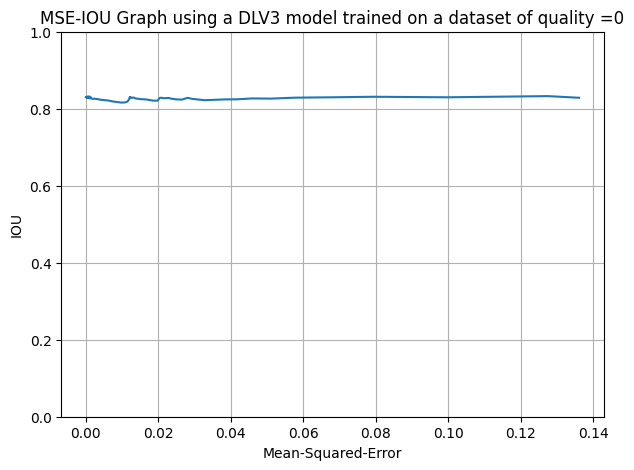

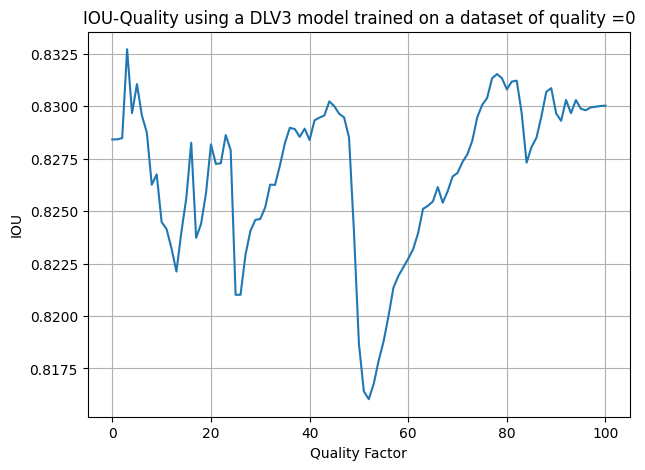

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.1001, iou_score - 0.8301]
DLV3 model trained on dataset of quality= 0 
test on uncompressed dataset
Evaluation Loss: 0.10007650244469739
Evaluation IoU: 0.8300894492981482
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.07807, iou_score - 0.8615]
Evaluation Loss: 0.07806651732500863
Evaluation IoU: 0.8614605162657942
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

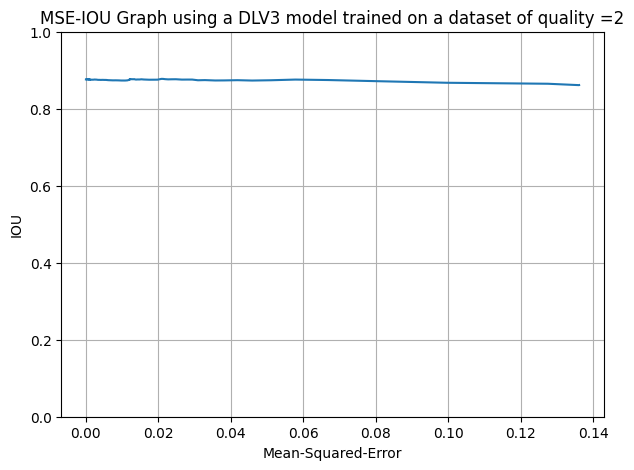

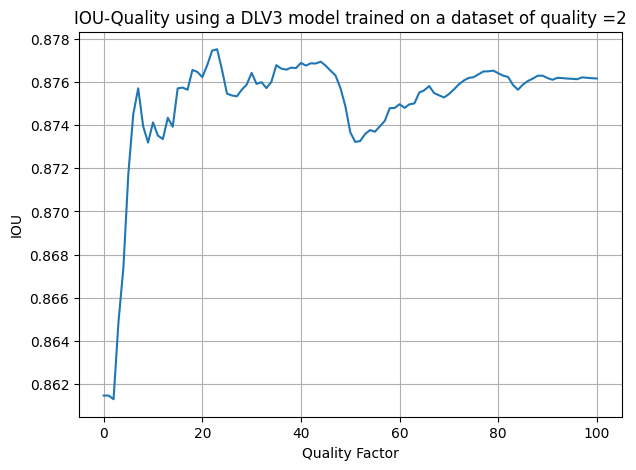

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.06888, iou_score - 0.8763]
DLV3 model trained on dataset of quality= 2 
test on uncompressed dataset
Evaluation Loss: 0.06888403728896496
Evaluation IoU: 0.8762721524519079
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.07978, iou_score - 0.8589]
Evaluation Loss: 0.07978181511748068
Evaluation IoU: 0.8588658676427953
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

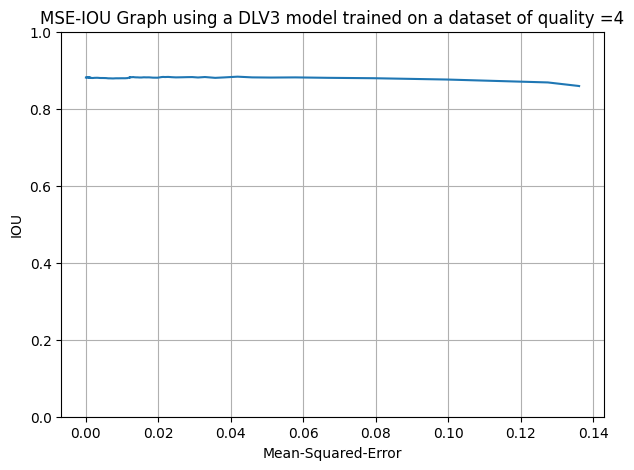

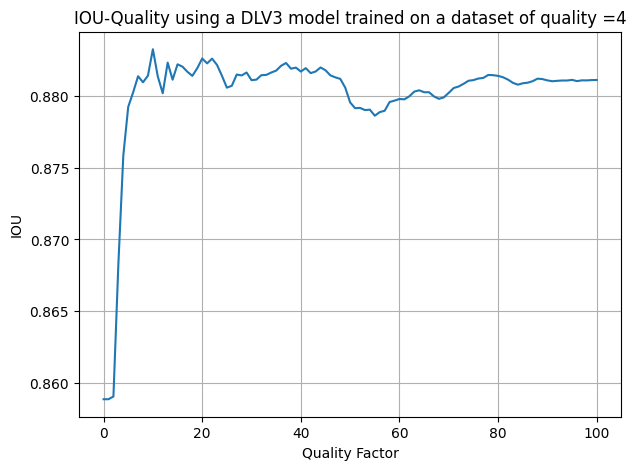

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.06635, iou_score - 0.8811]
DLV3 model trained on dataset of quality= 4 
test on uncompressed dataset
Evaluation Loss: 0.06635245972988654
Evaluation IoU: 0.8811113927878584
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.08866, iou_score - 0.8452]
Evaluation Loss: 0.08866162393607346
Evaluation IoU: 0.8452475444943298
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

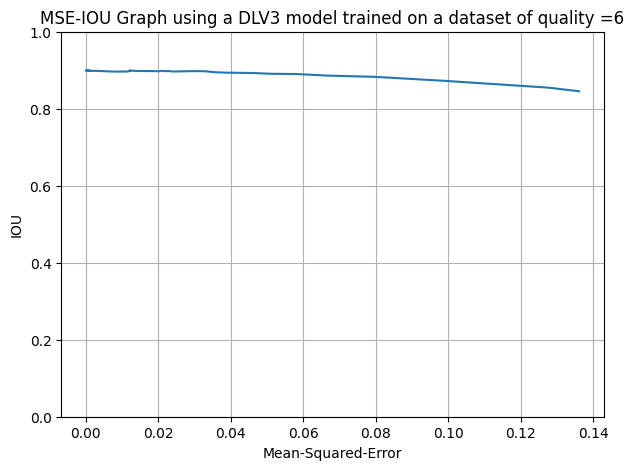

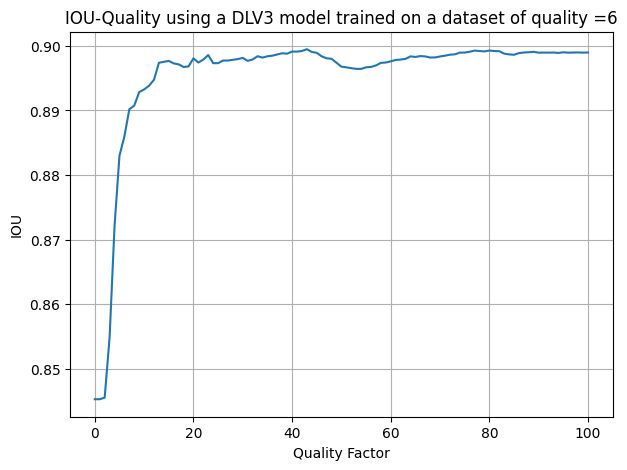

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.45it/s, dice_loss - 0.05554, iou_score - 0.899] 
DLV3 model trained on dataset of quality= 6 
test on uncompressed dataset
Evaluation Loss: 0.05554488242841233
Evaluation IoU: 0.898972159507228
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.1046, iou_score - 0.8225]
Evaluation Loss: 0.10458257385328704
Evaluation IoU: 0.8225291096696667
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00, 

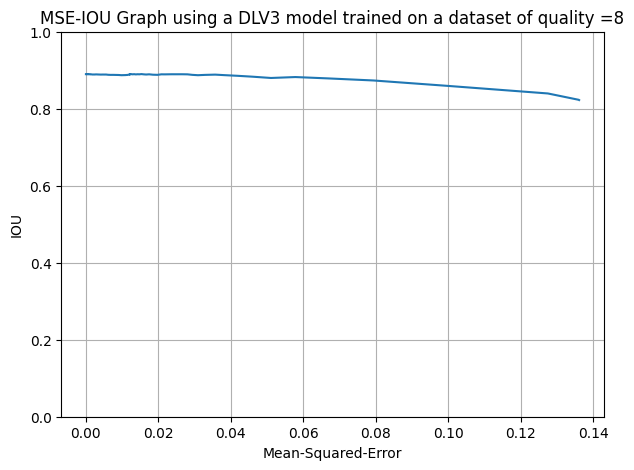

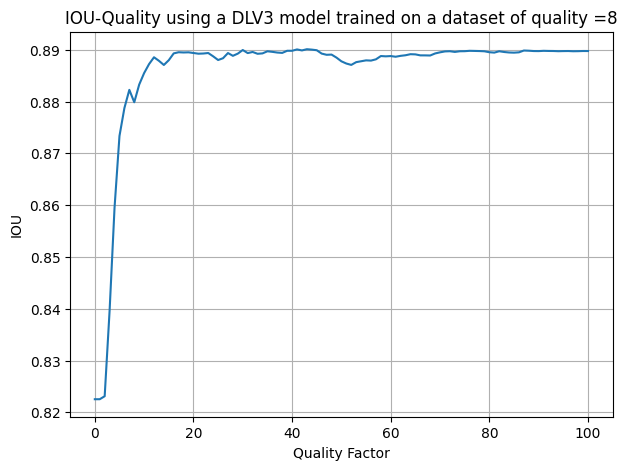

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.06151, iou_score - 0.8897]
DLV3 model trained on dataset of quality= 8 
test on uncompressed dataset
Evaluation Loss: 0.06150960688497504
Evaluation IoU: 0.8897402602083542
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1073, iou_score - 0.8187]
Evaluation Loss: 0.10729837300730688
Evaluation IoU: 0.8187153473788615
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

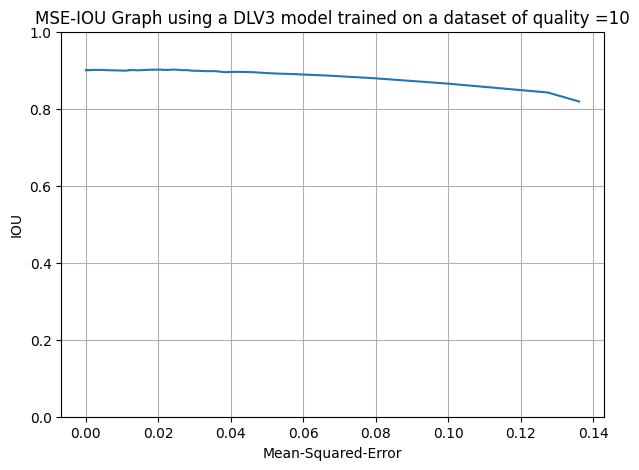

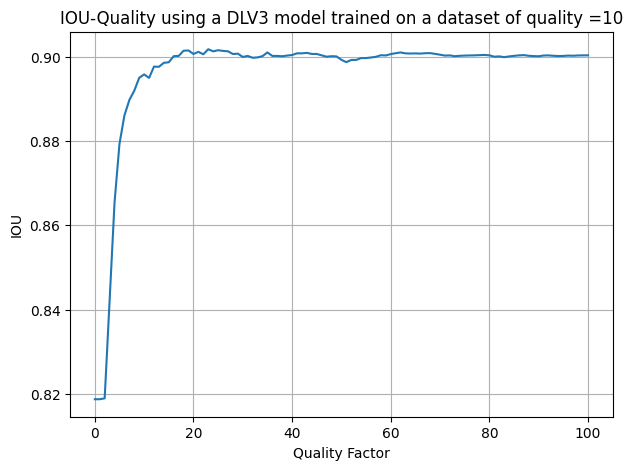

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05533, iou_score - 0.9003]
DLV3 model trained on dataset of quality= 10 
test on uncompressed dataset
Evaluation Loss: 0.05532831888572841
Evaluation IoU: 0.9003049964998281
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.1256, iou_score - 0.792] 
Evaluation Loss: 0.12563691887201053
Evaluation IoU: 0.7919843670199901
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

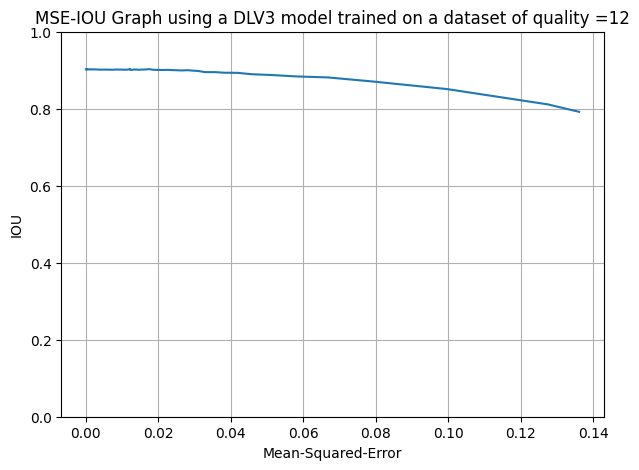

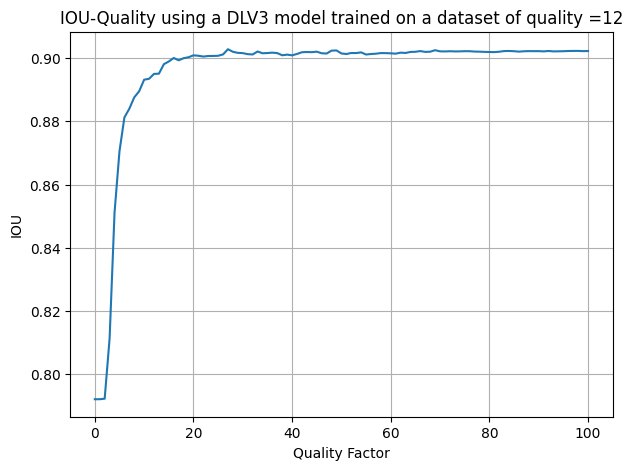

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05361, iou_score - 0.9023]
DLV3 model trained on dataset of quality= 12 
test on uncompressed dataset
Evaluation Loss: 0.05360572595222325
Evaluation IoU: 0.9022508310336693
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1266, iou_score - 0.7901]
Evaluation Loss: 0.12664610030604342
Evaluation IoU: 0.7901212923667011
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

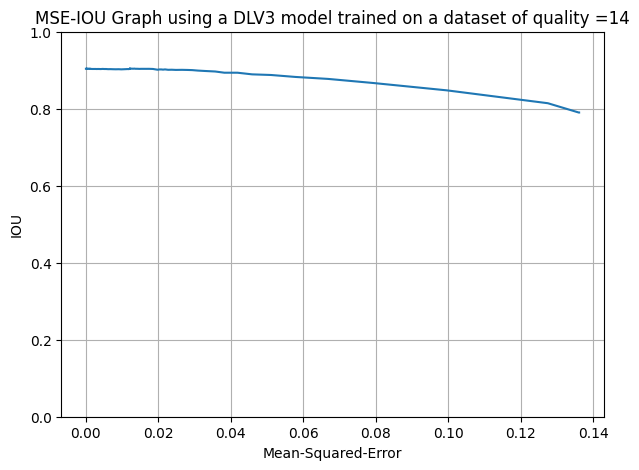

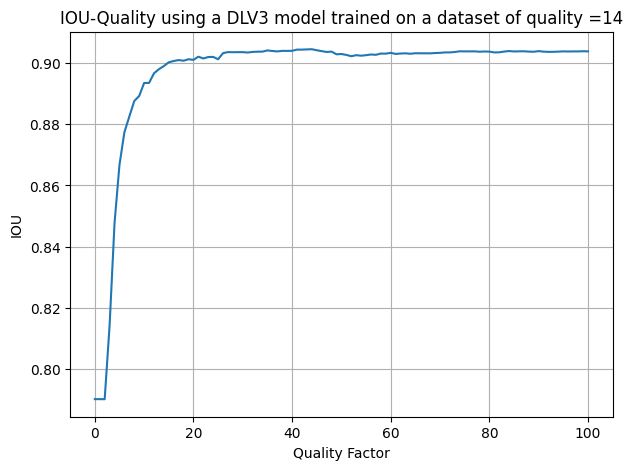

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.05253, iou_score - 0.9039]
DLV3 model trained on dataset of quality= 14 
test on uncompressed dataset
Evaluation Loss: 0.0525277105032229
Evaluation IoU: 0.9038624716740027
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.1265, iou_score - 0.7926]
Evaluation Loss: 0.12645751588484822
Evaluation IoU: 0.7925546274465674
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

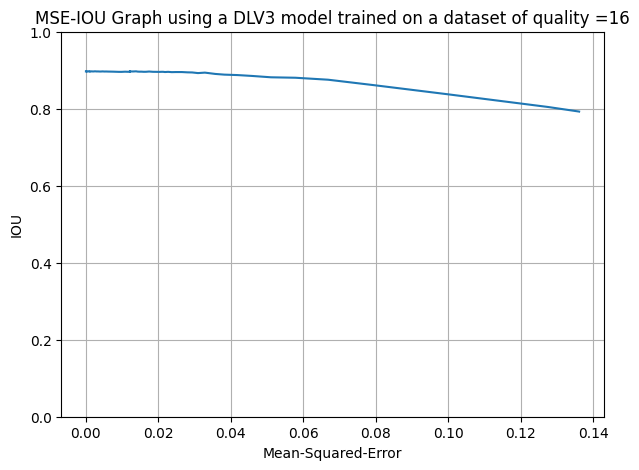

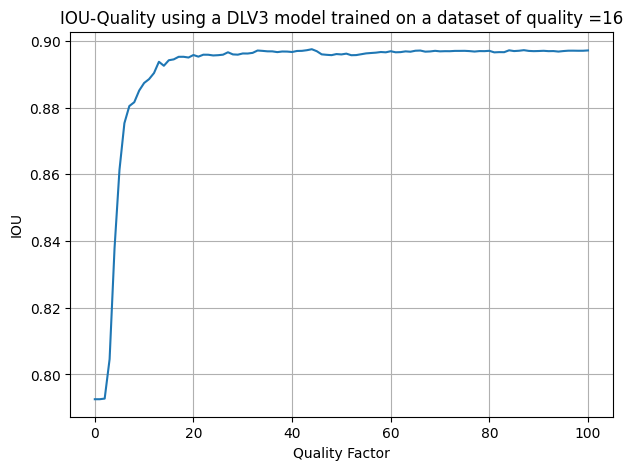

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.05714, iou_score - 0.8971]
DLV3 model trained on dataset of quality= 16 
test on uncompressed dataset
Evaluation Loss: 0.05713866504968384
Evaluation IoU: 0.8970502100738822
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.1375, iou_score - 0.7747]
Evaluation Loss: 0.13753926520254095
Evaluation IoU: 0.7746943194492191
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

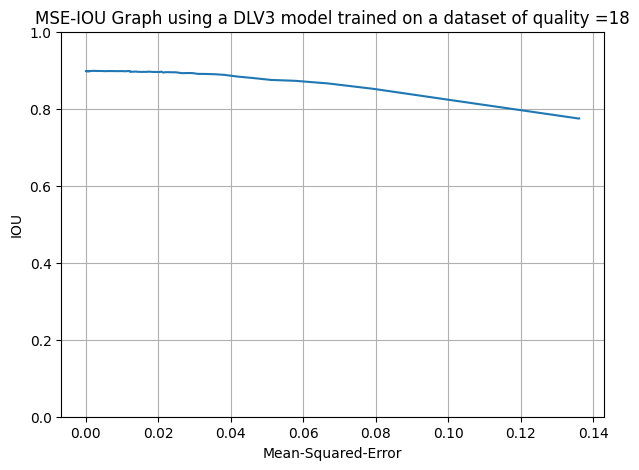

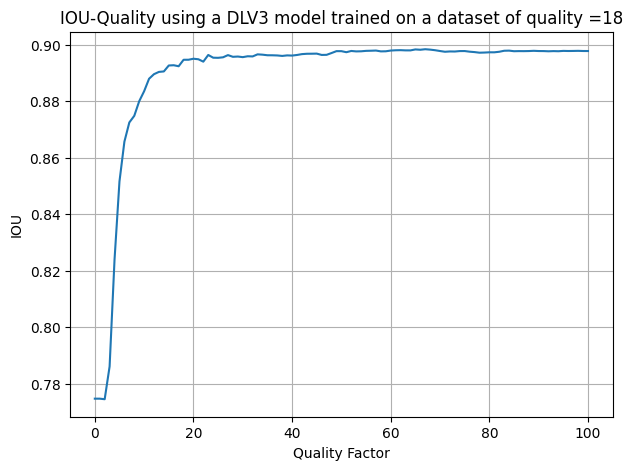

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05667, iou_score - 0.8977]
DLV3 model trained on dataset of quality= 18 
test on uncompressed dataset
Evaluation Loss: 0.05667387854819204
Evaluation IoU: 0.897736421987122
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1278, iou_score - 0.7891]
Evaluation Loss: 0.12781081597010294
Evaluation IoU: 0.7890655299027761
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

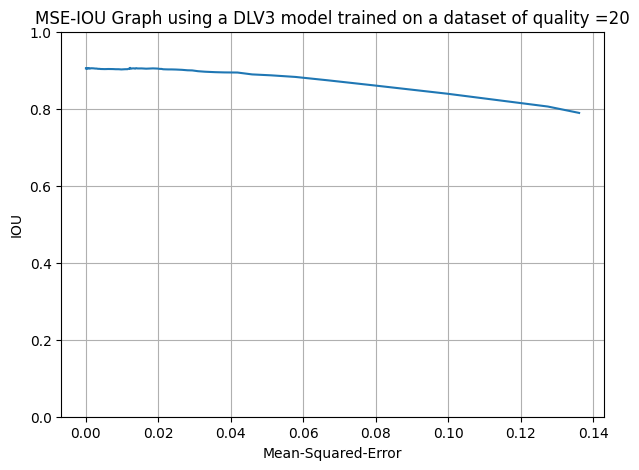

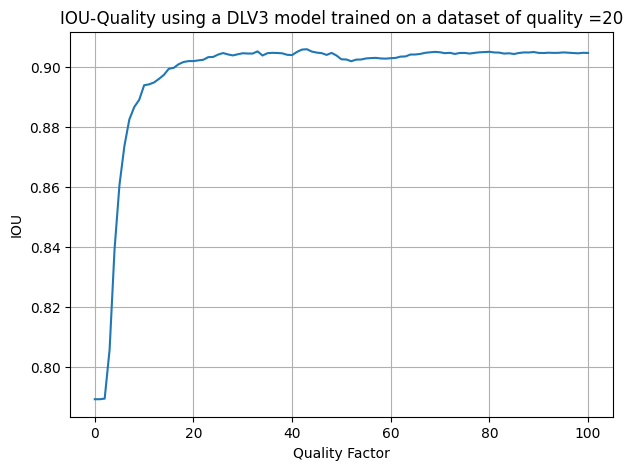

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.05213, iou_score - 0.9049]
DLV3 model trained on dataset of quality= 20 
test on uncompressed dataset
Evaluation Loss: 0.052125621075723695
Evaluation IoU: 0.9048560320162304
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.131, iou_score - 0.7832] 
Evaluation Loss: 0.13102565442814548
Evaluation IoU: 0.7831862720788693
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

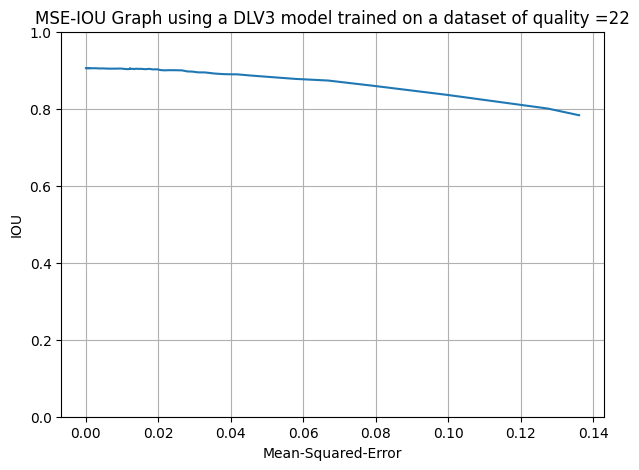

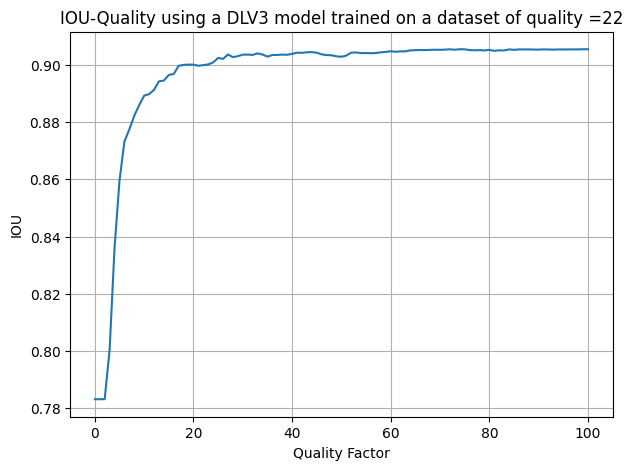

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05202, iou_score - 0.9054]
DLV3 model trained on dataset of quality= 22 
test on uncompressed dataset
Evaluation Loss: 0.05202185055788826
Evaluation IoU: 0.9054151679955278
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.1381, iou_score - 0.7733]
Evaluation Loss: 0.13809288950527412
Evaluation IoU: 0.773326876116734
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

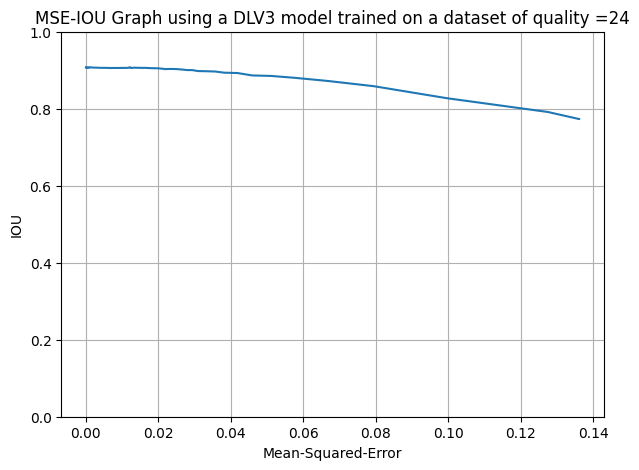

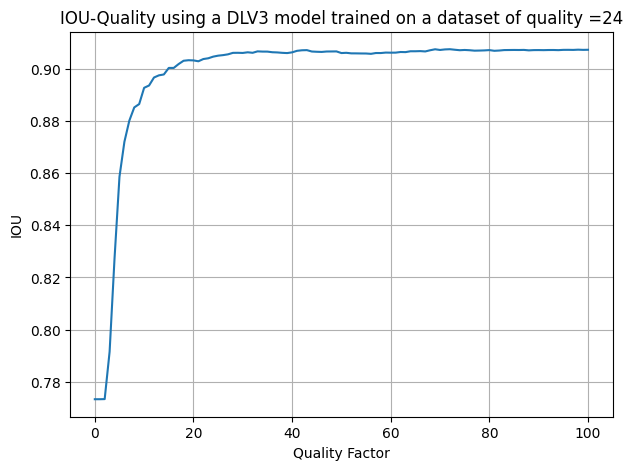

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05087, iou_score - 0.9072]
DLV3 model trained on dataset of quality= 24 
test on uncompressed dataset
Evaluation Loss: 0.05087453828138463
Evaluation IoU: 0.9072354833285013
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.1338, iou_score - 0.7794]
Evaluation Loss: 0.13377707495408894
Evaluation IoU: 0.7794059246194129
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

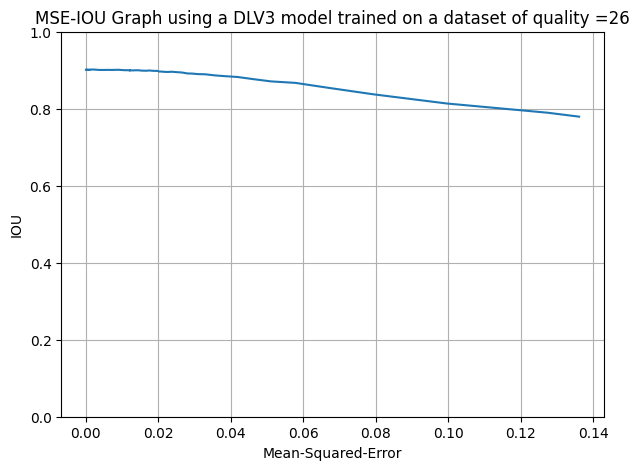

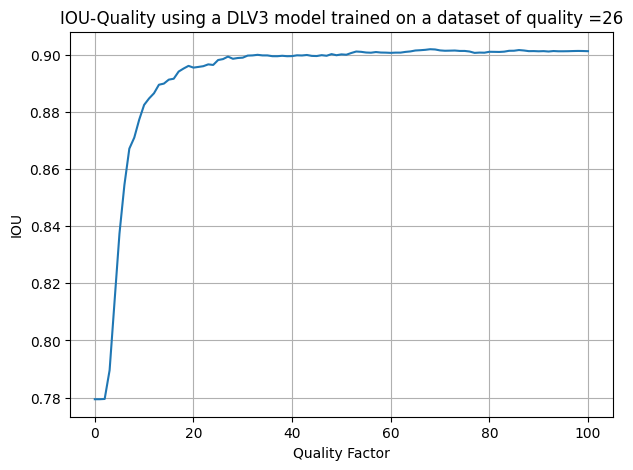

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.05458, iou_score - 0.9014]
DLV3 model trained on dataset of quality= 26 
test on uncompressed dataset
Evaluation Loss: 0.05458364299699372
Evaluation IoU: 0.9013614993469388
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1403, iou_score - 0.77]  
Evaluation Loss: 0.1402597263747571
Evaluation IoU: 0.7699521423554888
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

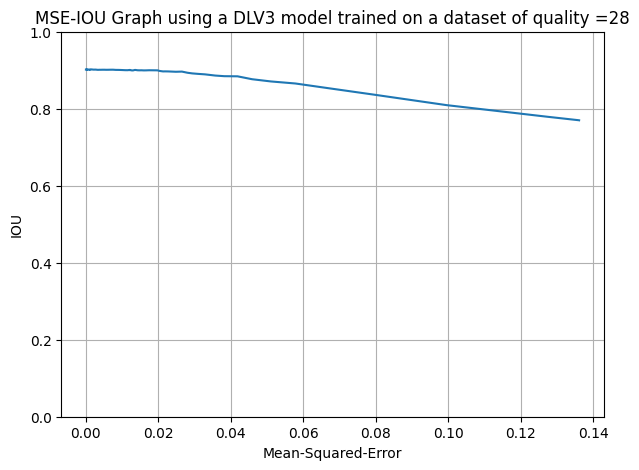

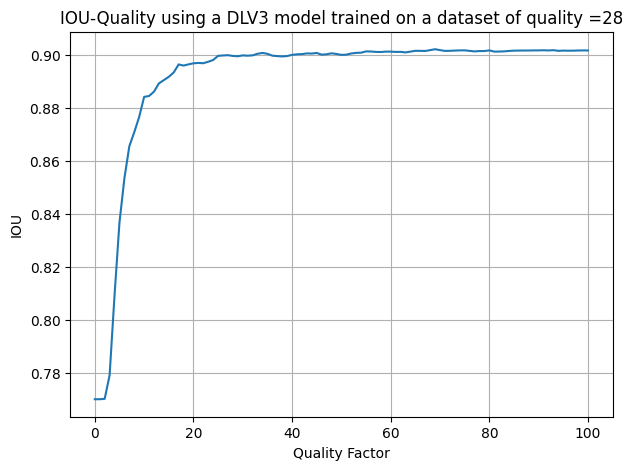

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.05437, iou_score - 0.9018]
DLV3 model trained on dataset of quality= 28 
test on uncompressed dataset
Evaluation Loss: 0.054365057571261526
Evaluation IoU: 0.9017656936365017
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.1461, iou_score - 0.7616]
Evaluation Loss: 0.14611113422057206
Evaluation IoU: 0.7615945327515694
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

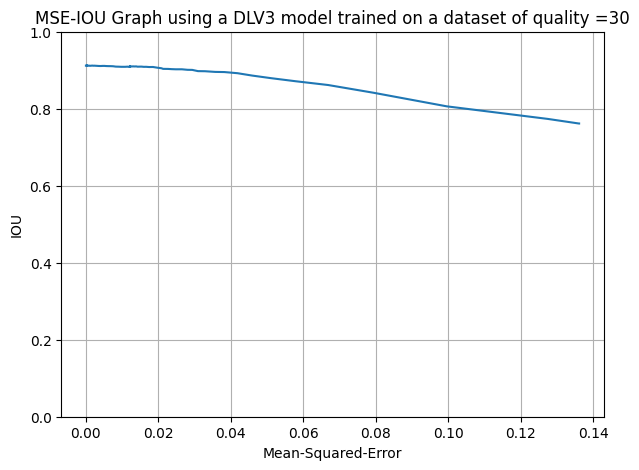

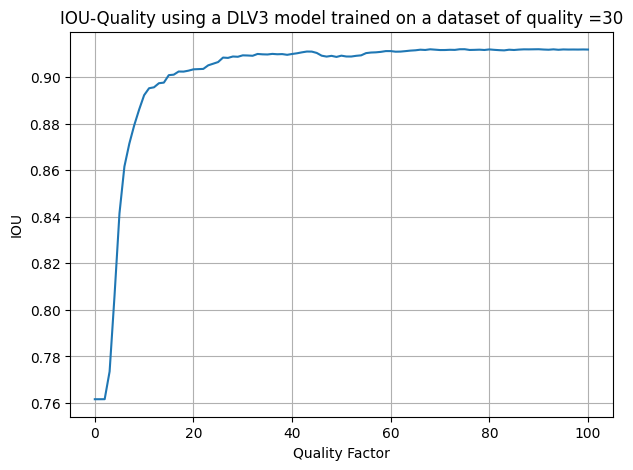

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.04809, iou_score - 0.912] 
DLV3 model trained on dataset of quality= 30 
test on uncompressed dataset
Evaluation Loss: 0.04809031416388118
Evaluation IoU: 0.9120122439721052
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.1387, iou_score - 0.7724]
Evaluation Loss: 0.13867764379463945
Evaluation IoU: 0.7724061789465884
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

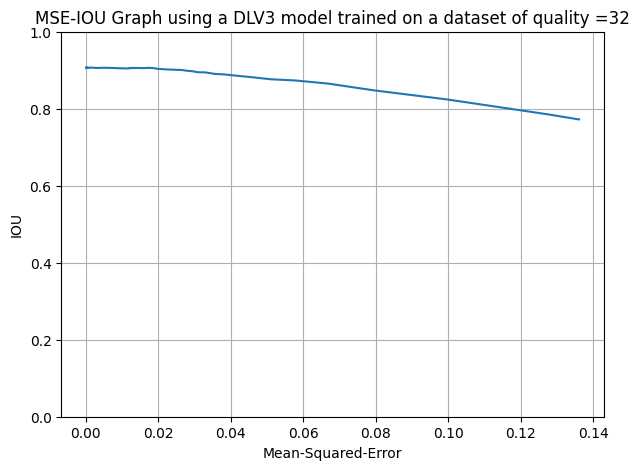

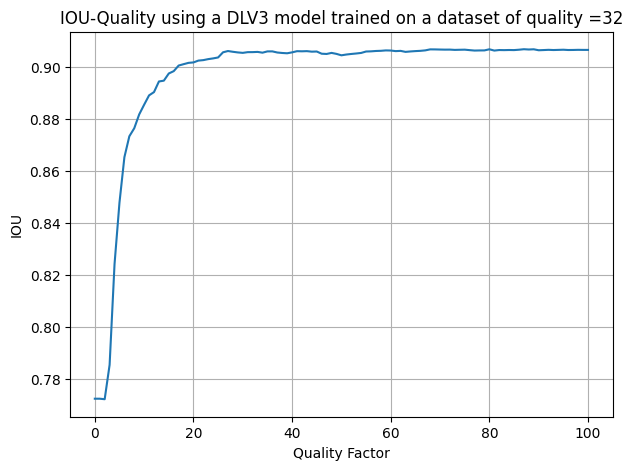

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05132, iou_score - 0.9067]
DLV3 model trained on dataset of quality= 32 
test on uncompressed dataset
Evaluation Loss: 0.05132477657467711
Evaluation IoU: 0.9066827472518472
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1367, iou_score - 0.7746]
Evaluation Loss: 0.13669308844734643
Evaluation IoU: 0.7746115917084265
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

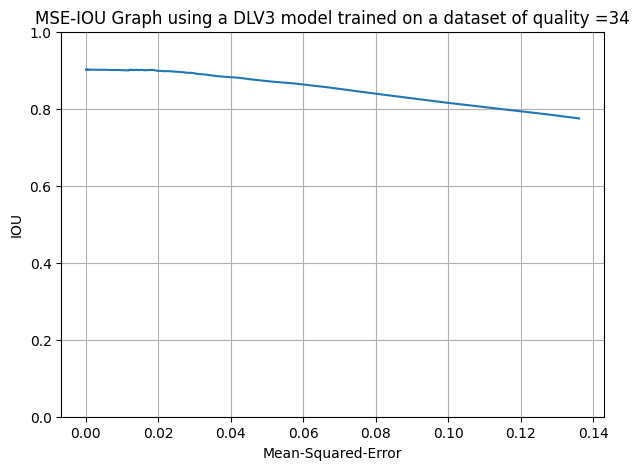

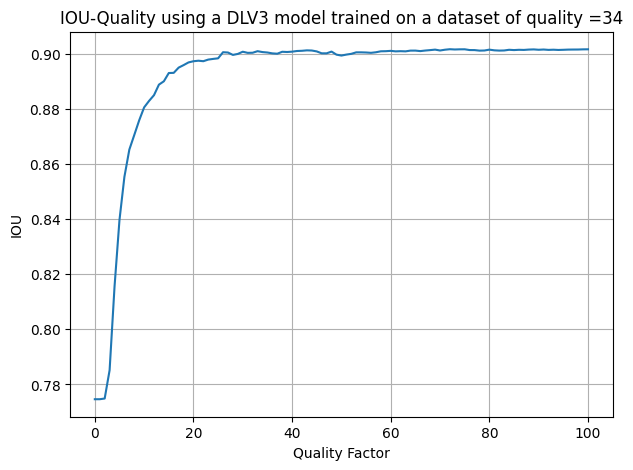

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05408, iou_score - 0.9018]
DLV3 model trained on dataset of quality= 34 
test on uncompressed dataset
Evaluation Loss: 0.0540771531123741
Evaluation IoU: 0.9017927623262592
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.143, iou_score - 0.7653] 
Evaluation Loss: 0.1430404279746261
Evaluation IoU: 0.7652678682523614
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00, 

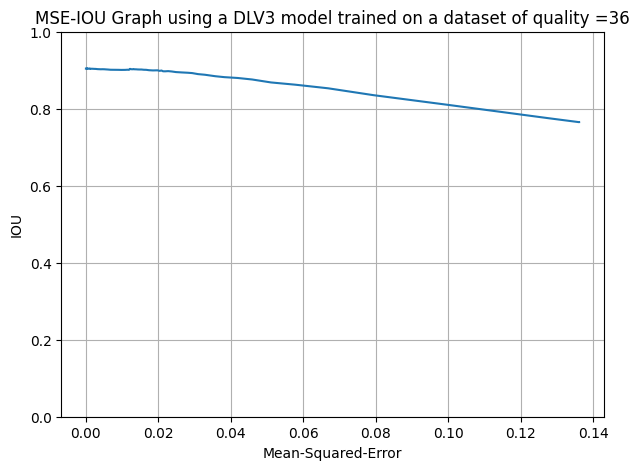

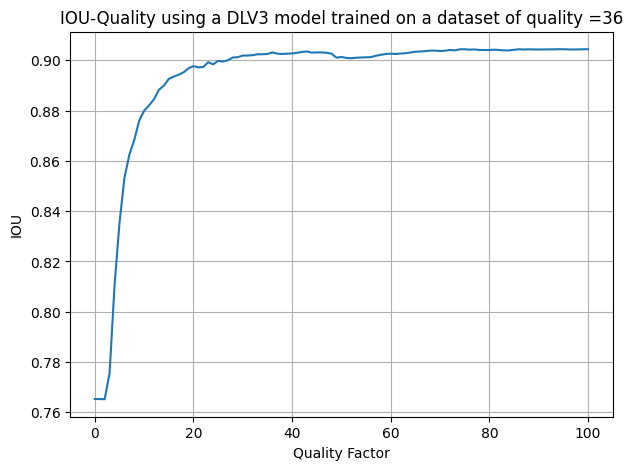

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05234, iou_score - 0.9043]
DLV3 model trained on dataset of quality= 36 
test on uncompressed dataset
Evaluation Loss: 0.05233535112119189
Evaluation IoU: 0.904326535907446
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.1381, iou_score - 0.7725]
Evaluation Loss: 0.13814569571438956
Evaluation IoU: 0.7725497279681411
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

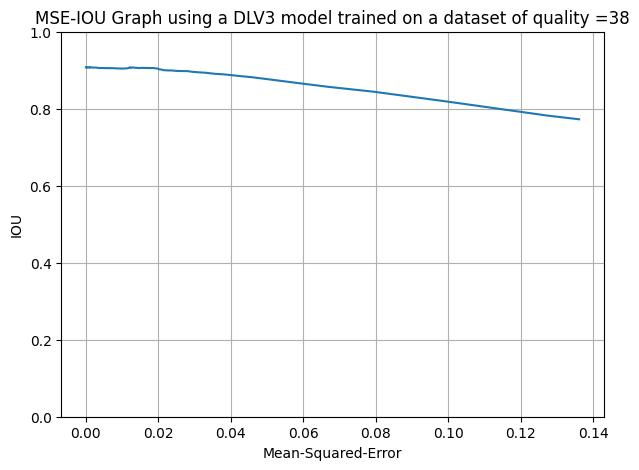

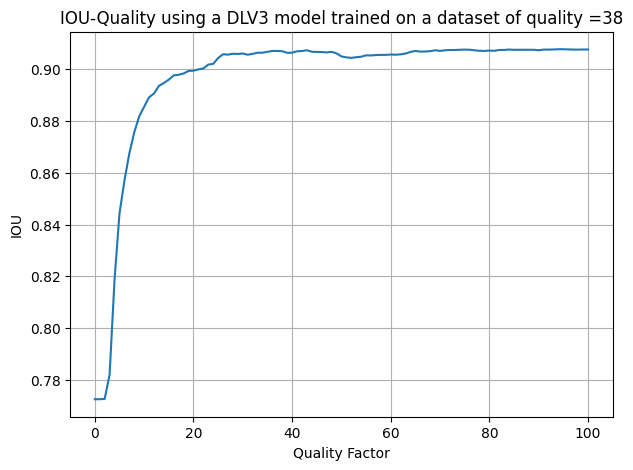

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.05083, iou_score - 0.9076]
DLV3 model trained on dataset of quality= 38 
test on uncompressed dataset
Evaluation Loss: 0.05082867192287072
Evaluation IoU: 0.9076081561107262
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1315, iou_score - 0.7824]
Evaluation Loss: 0.13152775811214074
Evaluation IoU: 0.7823598133582697
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

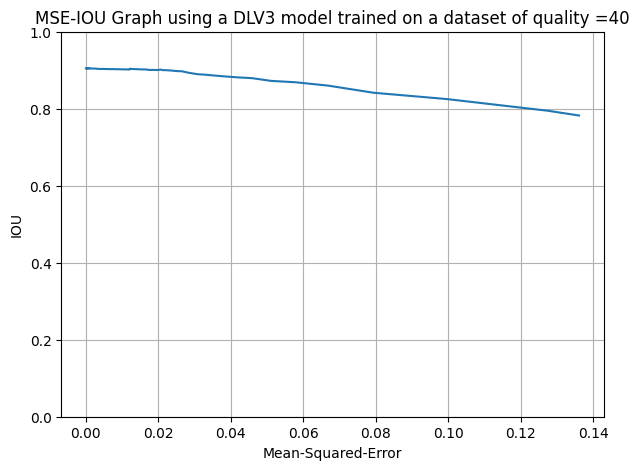

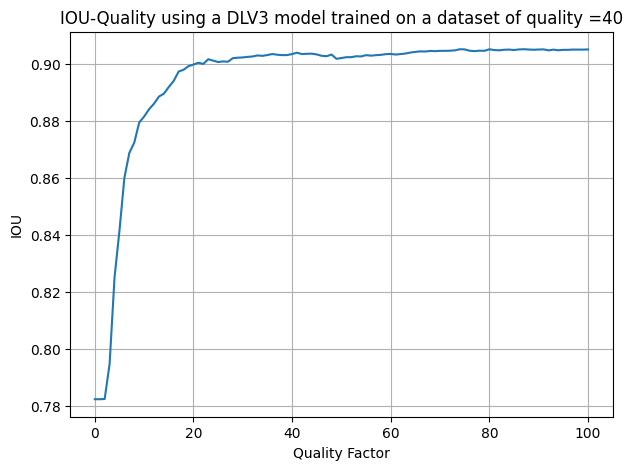

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05196, iou_score - 0.905] 
DLV3 model trained on dataset of quality= 40 
test on uncompressed dataset
Evaluation Loss: 0.051959687588261624
Evaluation IoU: 0.9049851298332214
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1289, iou_score - 0.7865]
Evaluation Loss: 0.12889624810686298
Evaluation IoU: 0.7864658698147418
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

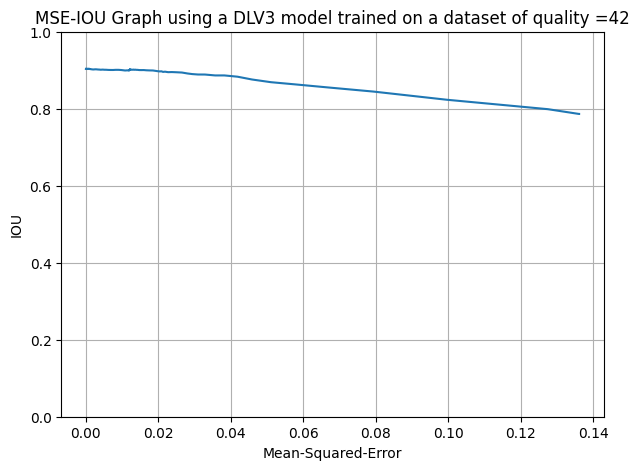

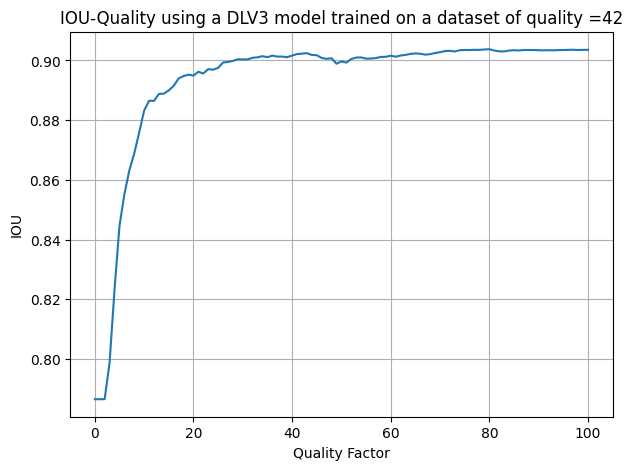

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05277, iou_score - 0.9035]
DLV3 model trained on dataset of quality= 42 
test on uncompressed dataset
Evaluation Loss: 0.052770537488600784
Evaluation IoU: 0.9035382165628321
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1449, iou_score - 0.7631]
Evaluation Loss: 0.14493572361329018
Evaluation IoU: 0.7631379155551689
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

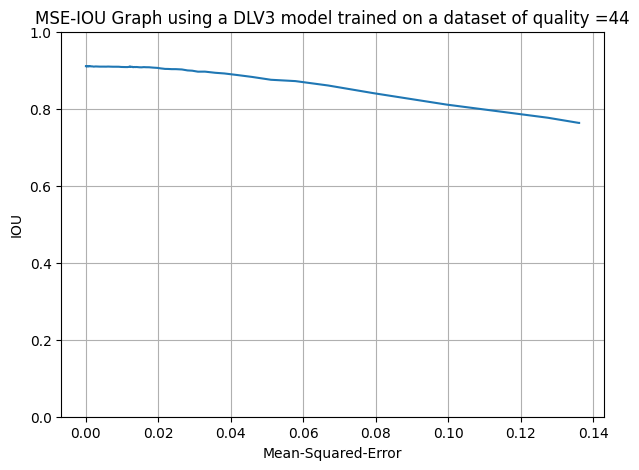

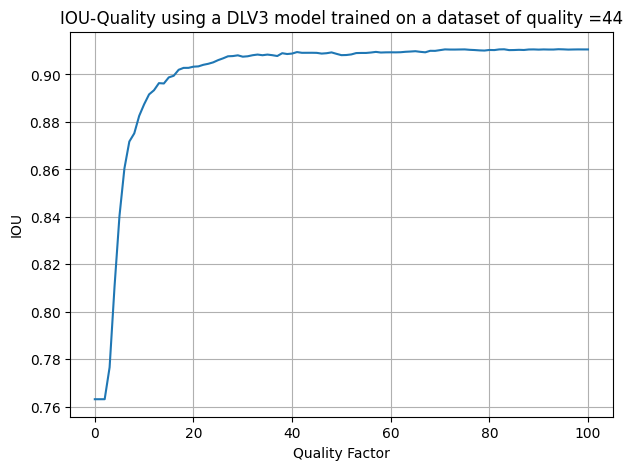

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.04901, iou_score - 0.9106]
DLV3 model trained on dataset of quality= 44 
test on uncompressed dataset
Evaluation Loss: 0.04900673557730281
Evaluation IoU: 0.9106030113556804
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1434, iou_score - 0.7653]
Evaluation Loss: 0.1433719408278372
Evaluation IoU: 0.7652809263444412
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

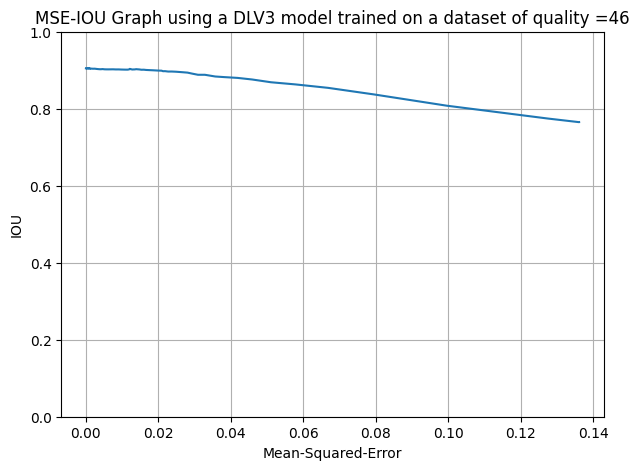

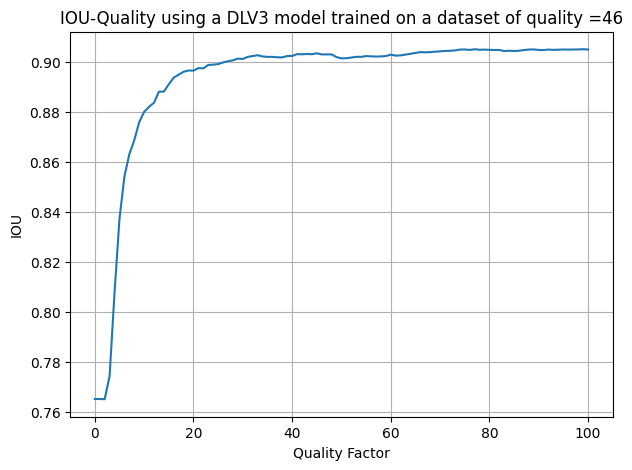

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.0521, iou_score - 0.905]  
DLV3 model trained on dataset of quality= 46 
test on uncompressed dataset
Evaluation Loss: 0.05210288482553818
Evaluation IoU: 0.9050103577913023
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1385, iou_score - 0.7722]
Evaluation Loss: 0.1384759872567419
Evaluation IoU: 0.7722221700584188
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

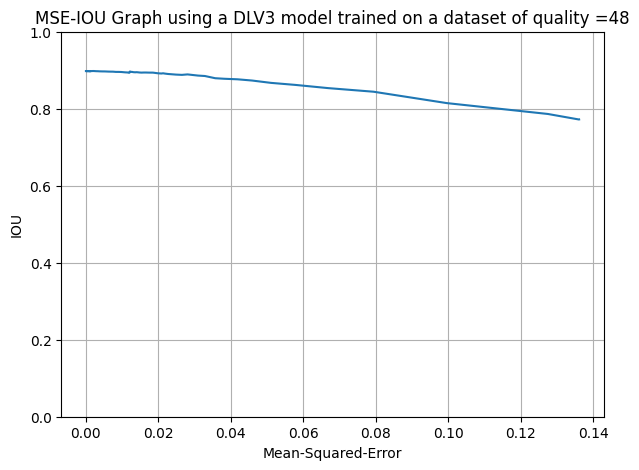

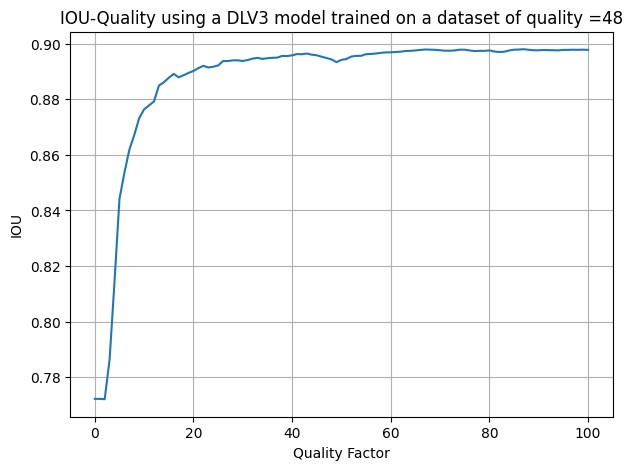

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05649, iou_score - 0.8979]
DLV3 model trained on dataset of quality= 48 
test on uncompressed dataset
Evaluation Loss: 0.056490560372670494
Evaluation IoU: 0.8978629392736099
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1281, iou_score - 0.7893]
Evaluation Loss: 0.1280857429784887
Evaluation IoU: 0.789306647052952
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

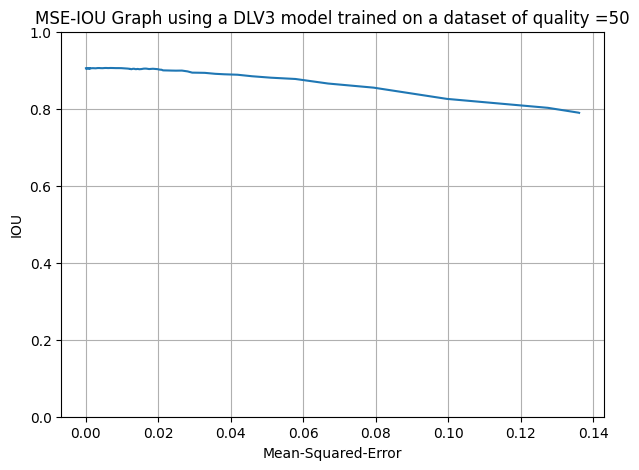

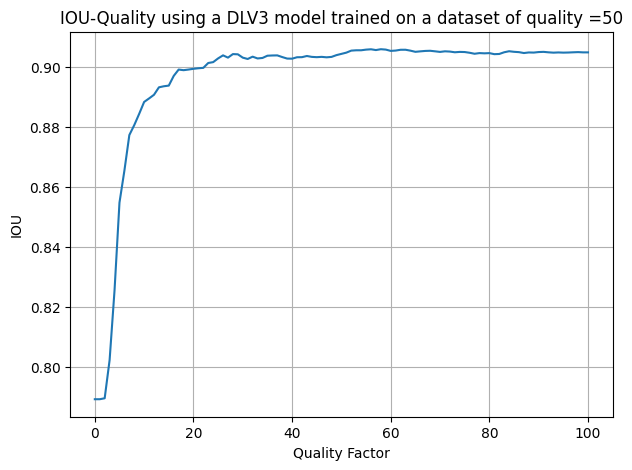

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.77it/s, dice_loss - 0.05218, iou_score - 0.9049]
DLV3 model trained on dataset of quality= 50 
test on uncompressed dataset
Evaluation Loss: 0.052180987947127395
Evaluation IoU: 0.9048914804178124
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.1418, iou_score - 0.7681]
Evaluation Loss: 0.14178075509912827
Evaluation IoU: 0.7680792732566009
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

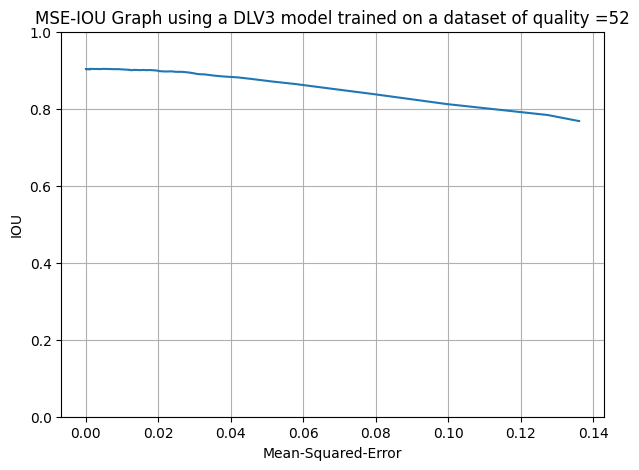

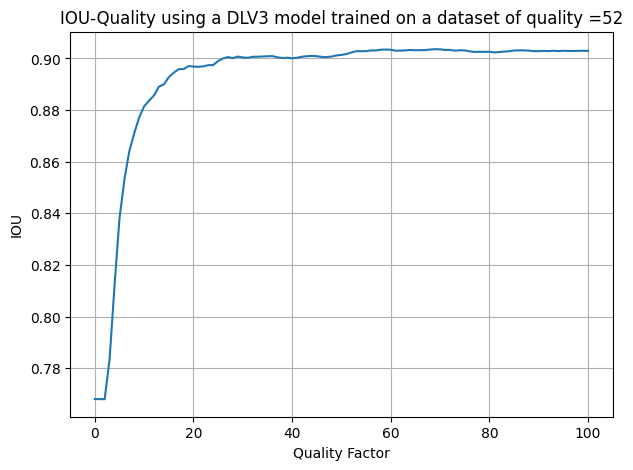

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.50it/s, dice_loss - 0.05329, iou_score - 0.9031]
DLV3 model trained on dataset of quality= 52 
test on uncompressed dataset
Evaluation Loss: 0.05329234576692768
Evaluation IoU: 0.9031434140953364
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.71it/s, dice_loss - 0.1374, iou_score - 0.7762]
Evaluation Loss: 0.13737273449991264
Evaluation IoU: 0.7761992268702564
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

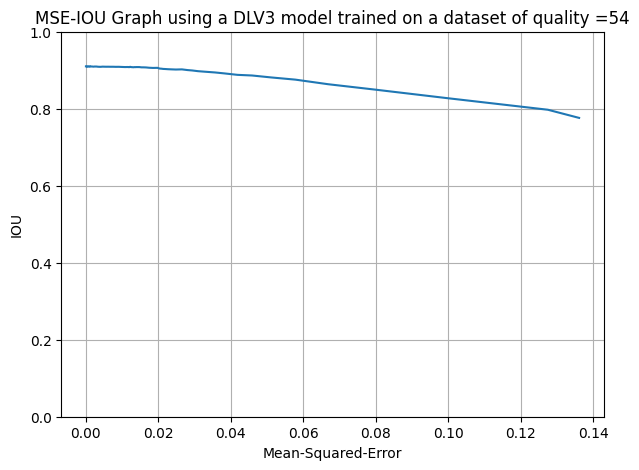

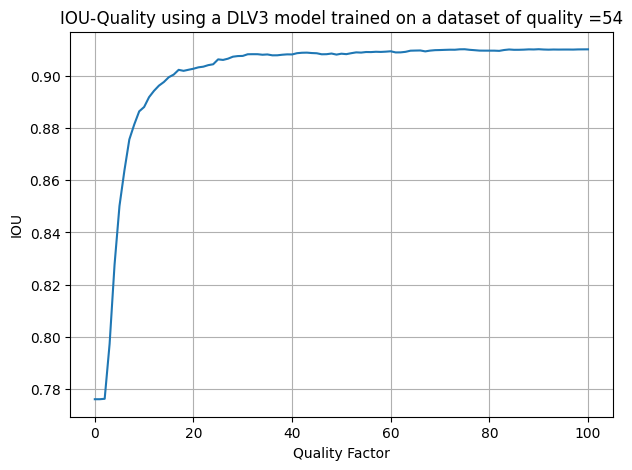

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.04967, iou_score - 0.9101]
DLV3 model trained on dataset of quality= 54 
test on uncompressed dataset
Evaluation Loss: 0.04967339833577474
Evaluation IoU: 0.9100766742930693
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.1339, iou_score - 0.7795]
Evaluation Loss: 0.13391845717149622
Evaluation IoU: 0.7794661101172949
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

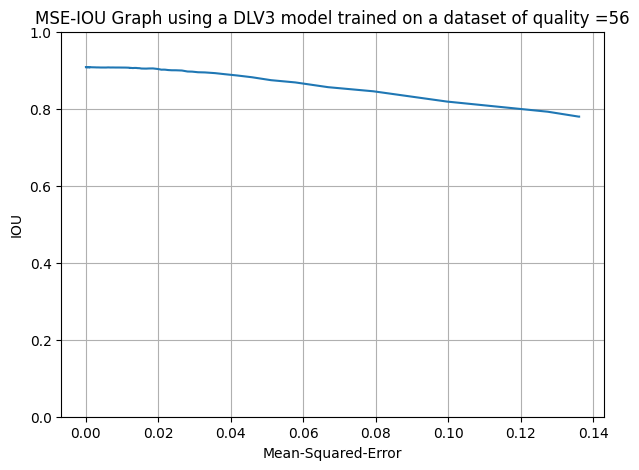

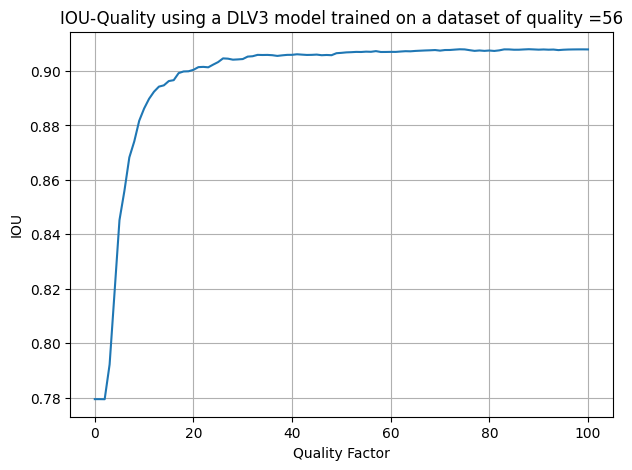

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.05071, iou_score - 0.908] 
DLV3 model trained on dataset of quality= 56 
test on uncompressed dataset
Evaluation Loss: 0.05070810691983093
Evaluation IoU: 0.9079617425507189
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.1471, iou_score - 0.7598]
Evaluation Loss: 0.14706246876249124
Evaluation IoU: 0.7597661187835767
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

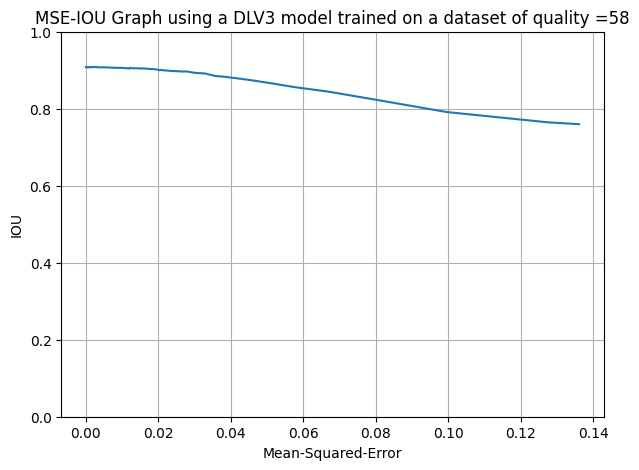

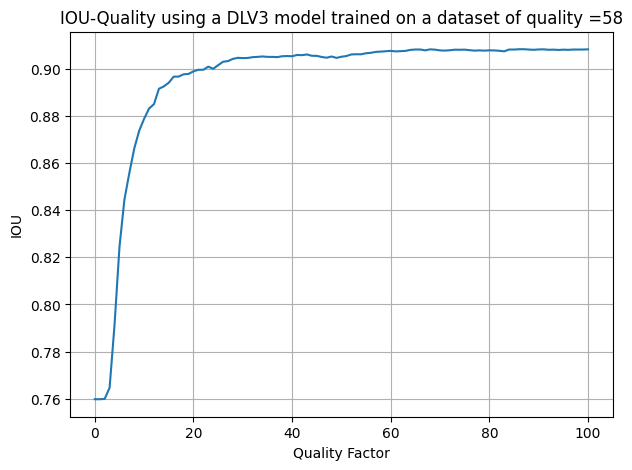

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.05062, iou_score - 0.9082]
DLV3 model trained on dataset of quality= 58 
test on uncompressed dataset
Evaluation Loss: 0.05062367168127321
Evaluation IoU: 0.9081633067598525
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1322, iou_score - 0.7811]
Evaluation Loss: 0.13217672880958112
Evaluation IoU: 0.7810530756034104
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

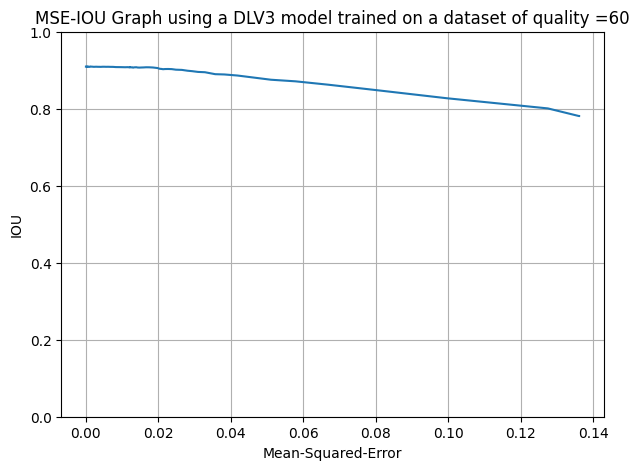

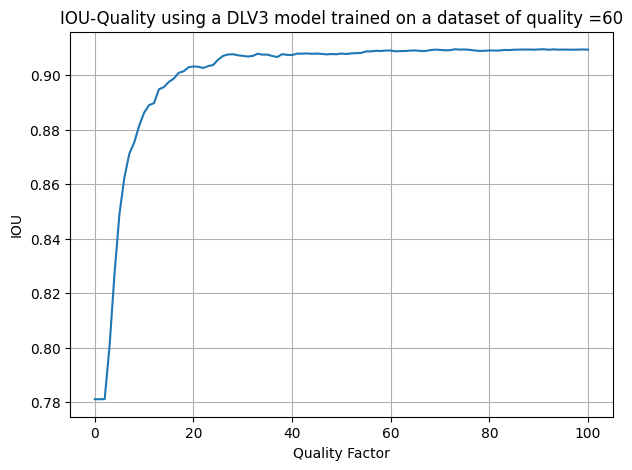

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.25it/s, dice_loss - 0.04976, iou_score - 0.9094]
DLV3 model trained on dataset of quality= 60 
test on uncompressed dataset
Evaluation Loss: 0.04975642643722833
Evaluation IoU: 0.9094225320161557
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:16<00:00,  3.02it/s, dice_loss - 0.1473, iou_score - 0.7604]
Evaluation Loss: 0.1473457684703902
Evaluation IoU: 0.7603832454073662
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:16<00:00,

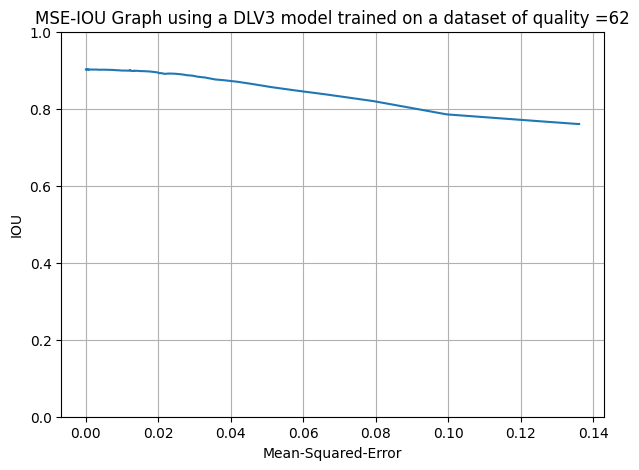

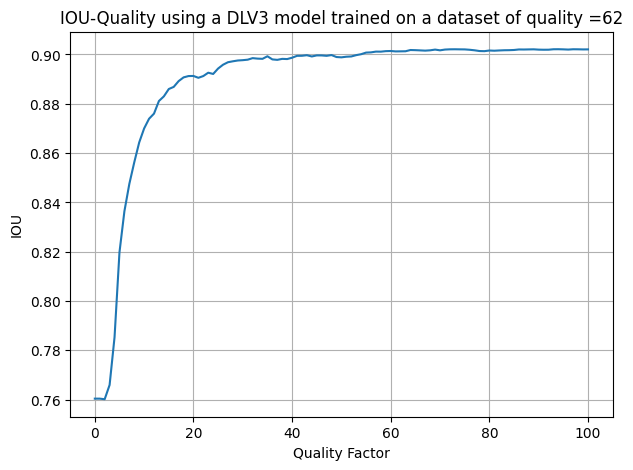

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.21it/s, dice_loss - 0.05431, iou_score - 0.9021]
DLV3 model trained on dataset of quality= 62 
test on uncompressed dataset
Evaluation Loss: 0.05431013831905291
Evaluation IoU: 0.9020944483139939
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.24it/s, dice_loss - 0.1467, iou_score - 0.7608]
Evaluation Loss: 0.146670516799478
Evaluation IoU: 0.7608345361316904
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00, 

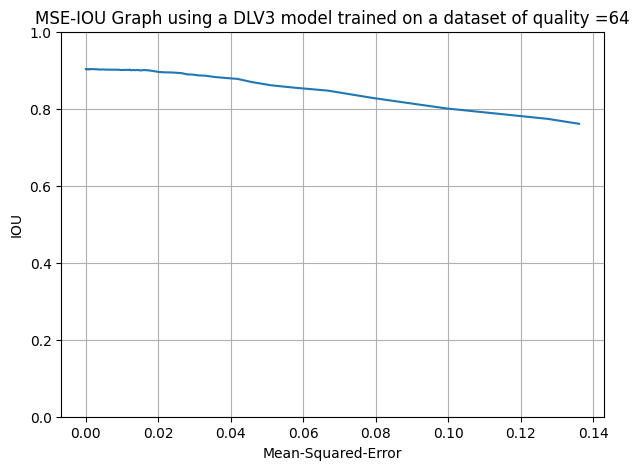

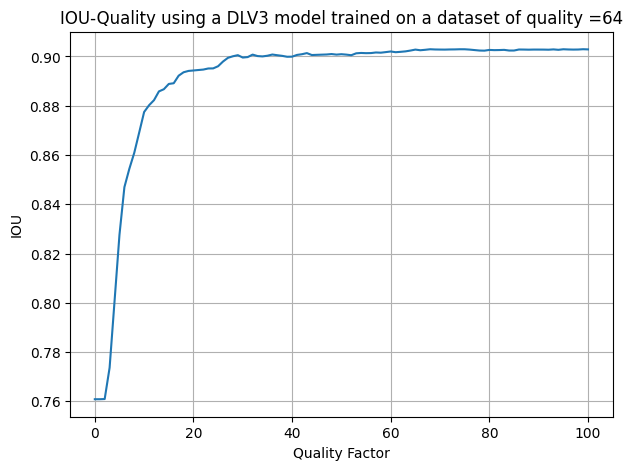

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.44it/s, dice_loss - 0.05314, iou_score - 0.903] 
DLV3 model trained on dataset of quality= 64 
test on uncompressed dataset
Evaluation Loss: 0.053141285391414855
Evaluation IoU: 0.9029726830183291
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.44it/s, dice_loss - 0.1453, iou_score - 0.762] 
Evaluation Loss: 0.14532682124306176
Evaluation IoU: 0.7619748524591033
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

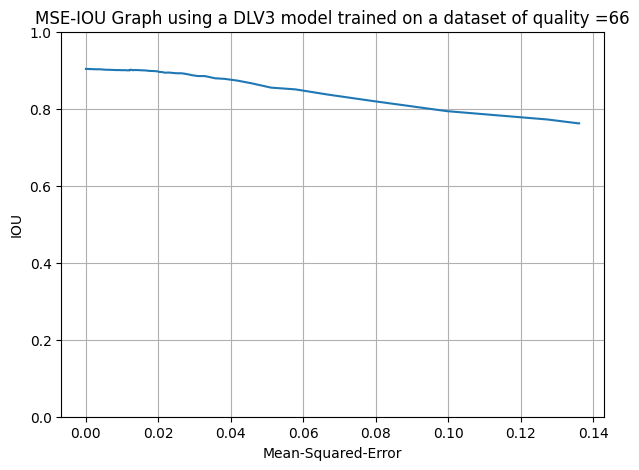

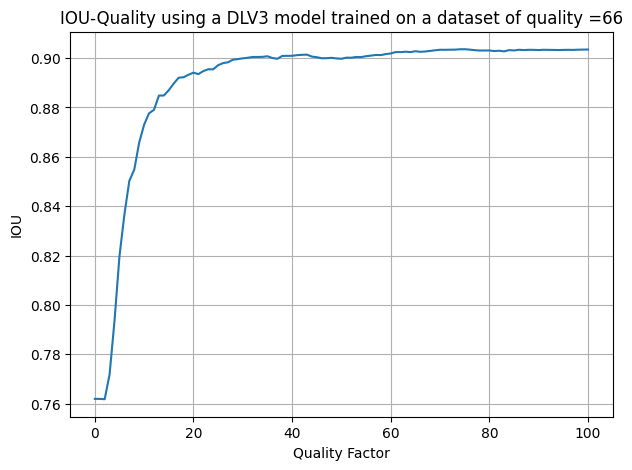

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:16<00:00,  3.03it/s, dice_loss - 0.0531, iou_score - 0.9035] 
DLV3 model trained on dataset of quality= 66 
test on uncompressed dataset
Evaluation Loss: 0.05310209358439725
Evaluation IoU: 0.903540945520588
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:16<00:00,  3.02it/s, dice_loss - 0.1461, iou_score - 0.7618]
Evaluation Loss: 0.14607218784444465
Evaluation IoU: 0.7618303912527421
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,

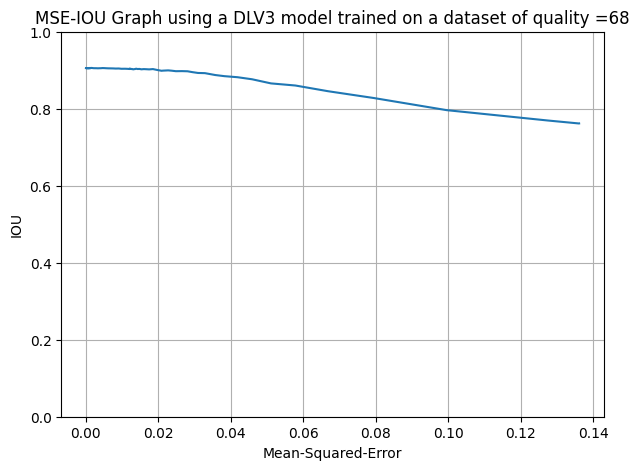

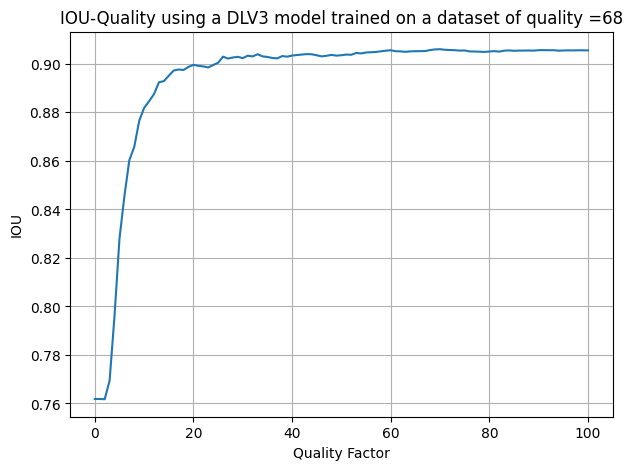

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:19<00:00,  2.55it/s, dice_loss - 0.05205, iou_score - 0.9055]
DLV3 model trained on dataset of quality= 68 
test on uncompressed dataset
Evaluation Loss: 0.05204860018748864
Evaluation IoU: 0.905523459116618
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00,  2.57it/s, dice_loss - 0.1447, iou_score - 0.7631]
Evaluation Loss: 0.1446861694840824
Evaluation IoU: 0.7630640519600287
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:20<00:00, 

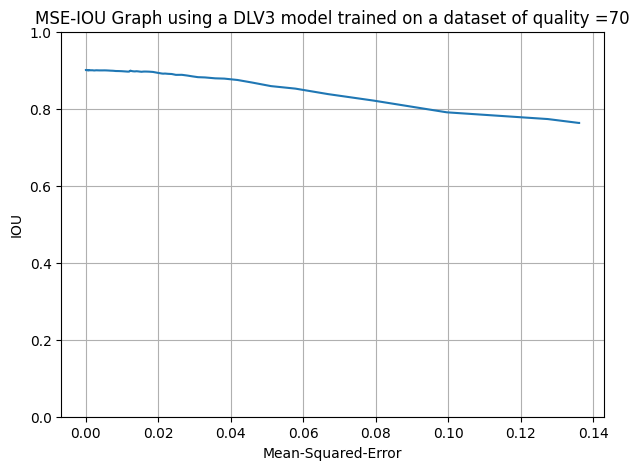

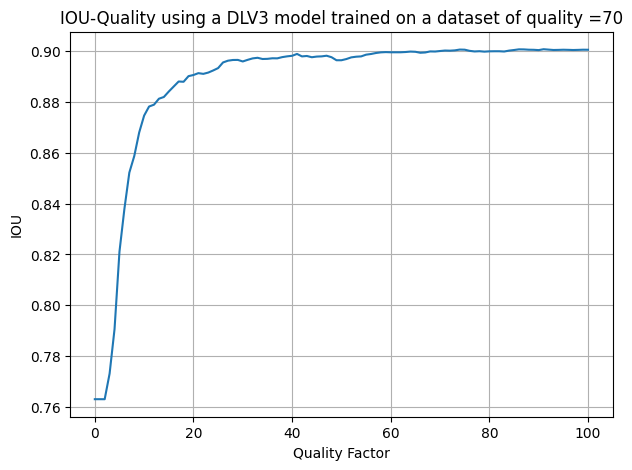

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:21<00:00,  2.32it/s, dice_loss - 0.05477, iou_score - 0.9006]
DLV3 model trained on dataset of quality= 70 
test on uncompressed dataset
Evaluation Loss: 0.05476822806339637
Evaluation IoU: 0.9005972333982876
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:22<00:00,  2.30it/s, dice_loss - 0.1497, iou_score - 0.7564]
Evaluation Loss: 0.14973217248916623
Evaluation IoU: 0.7563885912006977
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:21<00:00

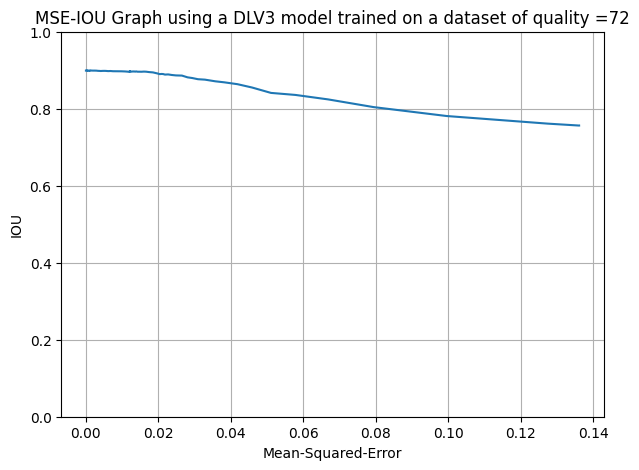

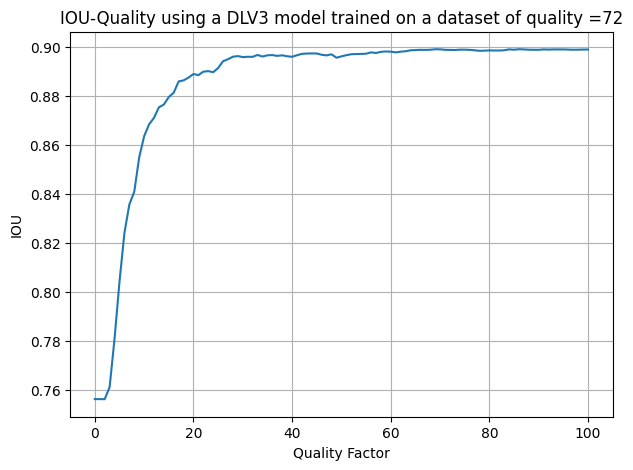

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.21it/s, dice_loss - 0.05566, iou_score - 0.899] 
DLV3 model trained on dataset of quality= 72 
test on uncompressed dataset
Evaluation Loss: 0.055660615949069764
Evaluation IoU: 0.8990189666841542
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.27it/s, dice_loss - 0.1456, iou_score - 0.7618]
Evaluation Loss: 0.14560155541289085
Evaluation IoU: 0.7618434096083921
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:0

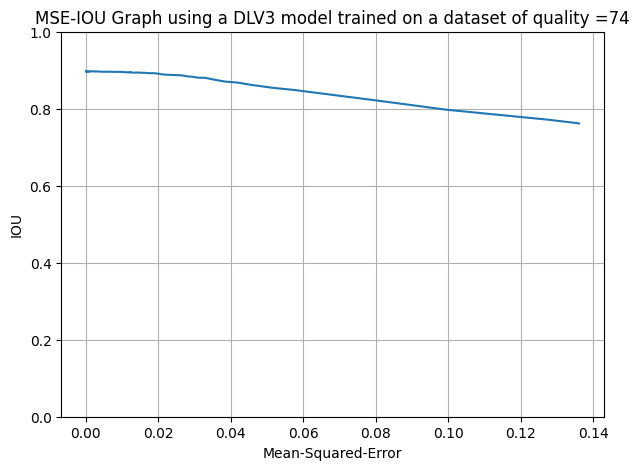

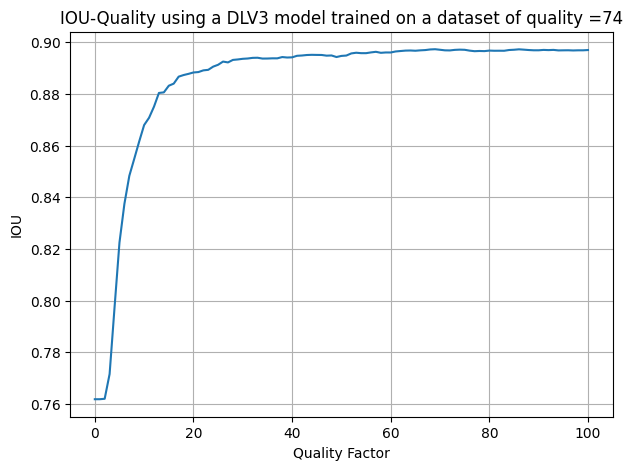

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.53it/s, dice_loss - 0.05718, iou_score - 0.8971]
DLV3 model trained on dataset of quality= 74 
test on uncompressed dataset
Evaluation Loss: 0.057177841663360596
Evaluation IoU: 0.8970590479233684
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.1493, iou_score - 0.7567]
Evaluation Loss: 0.14934737658968159
Evaluation IoU: 0.7567184018153771
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

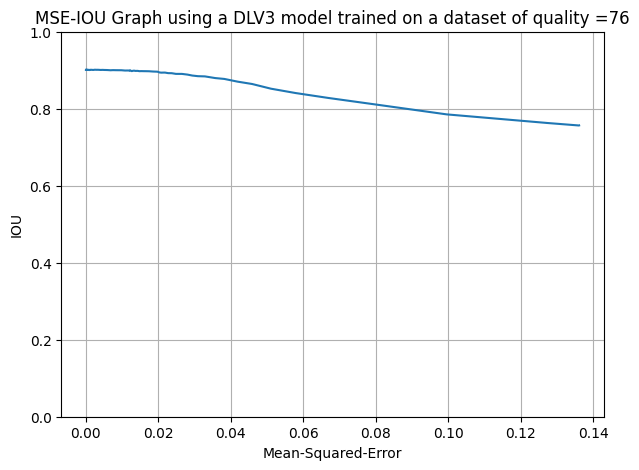

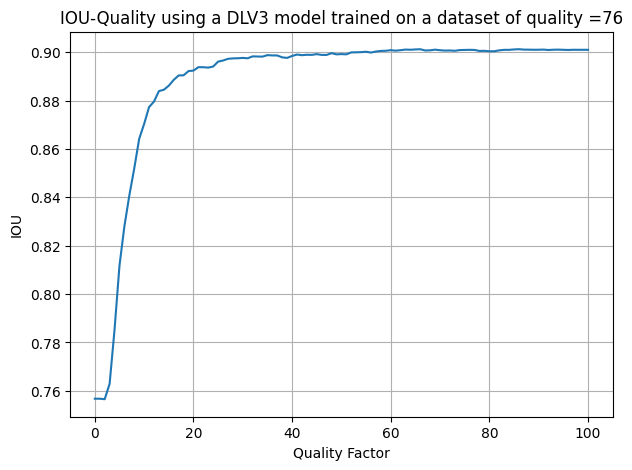

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.74it/s, dice_loss - 0.05454, iou_score - 0.901] 
DLV3 model trained on dataset of quality= 76 
test on uncompressed dataset
Evaluation Loss: 0.05454349868437823
Evaluation IoU: 0.9009653329849244
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.1469, iou_score - 0.7604]
Evaluation Loss: 0.1469152932073556
Evaluation IoU: 0.7603739944158816
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

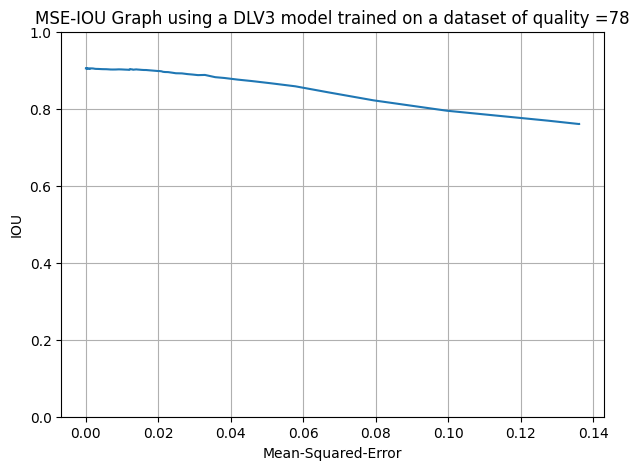

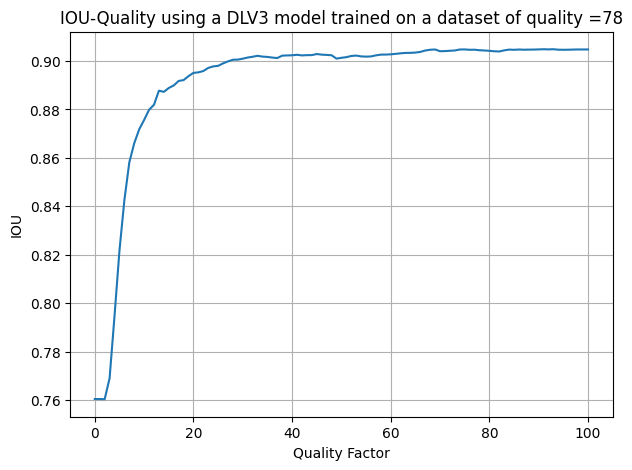

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.05259, iou_score - 0.9048]
DLV3 model trained on dataset of quality= 78 
test on uncompressed dataset
Evaluation Loss: 0.05258656249326818
Evaluation IoU: 0.9047652716730155
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1505, iou_score - 0.7547]
Evaluation Loss: 0.150490449924095
Evaluation IoU: 0.7546647816312081
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00, 

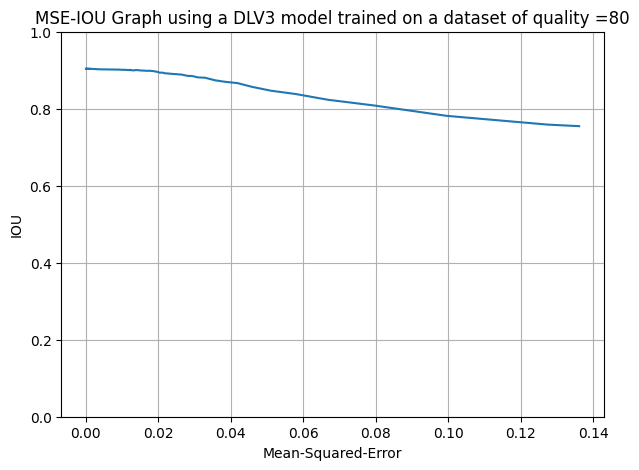

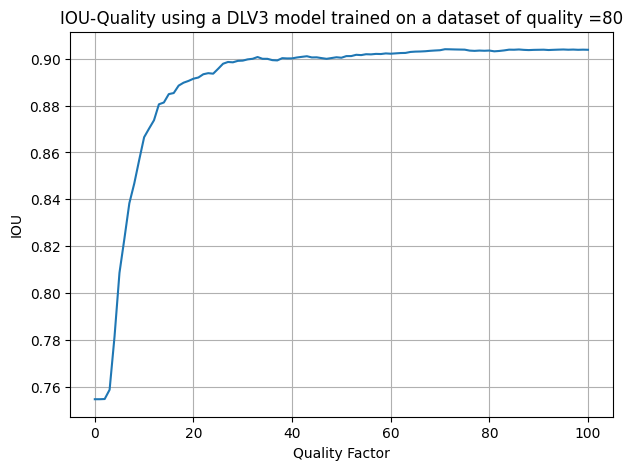

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05316, iou_score - 0.9039]
DLV3 model trained on dataset of quality= 80 
test on uncompressed dataset
Evaluation Loss: 0.05316077143538232
Evaluation IoU: 0.9038800947806415
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1484, iou_score - 0.758] 
Evaluation Loss: 0.14841552224813723
Evaluation IoU: 0.7580224503489102
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

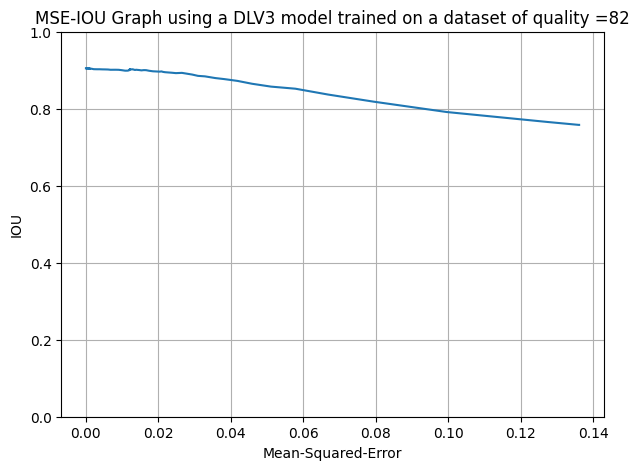

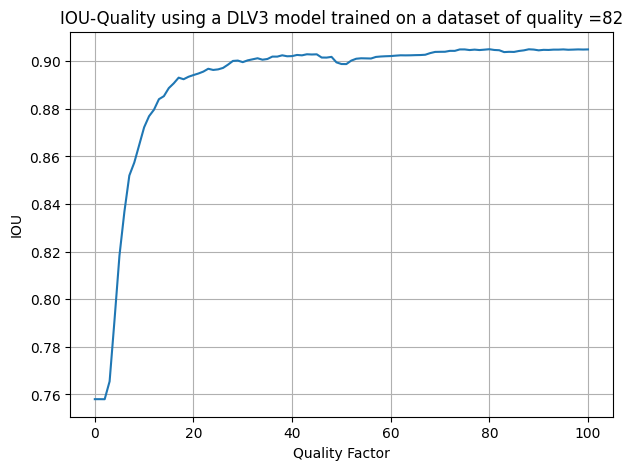

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.05239, iou_score - 0.905] 
DLV3 model trained on dataset of quality= 82 
test on uncompressed dataset
Evaluation Loss: 0.05238875103931802
Evaluation IoU: 0.9049816295212391
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1467, iou_score - 0.7619]
Evaluation Loss: 0.14667460263944138
Evaluation IoU: 0.761901037950142
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

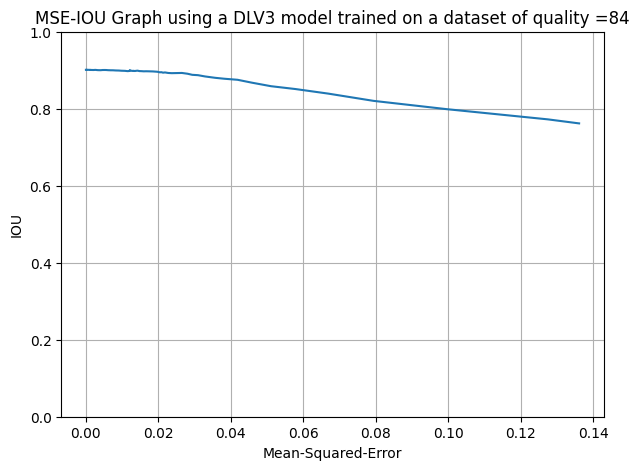

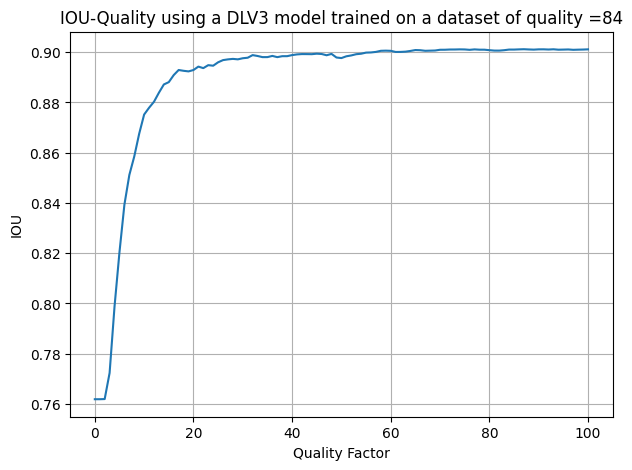

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.05552, iou_score - 0.901] 
DLV3 model trained on dataset of quality= 84 
test on uncompressed dataset
Evaluation Loss: 0.05551941838918948
Evaluation IoU: 0.9010394180522246
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.1457, iou_score - 0.762] 
Evaluation Loss: 0.14573722960902202
Evaluation IoU: 0.7619994685930365
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

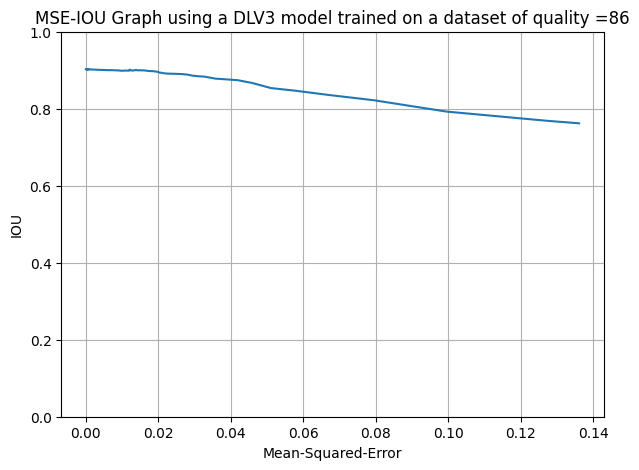

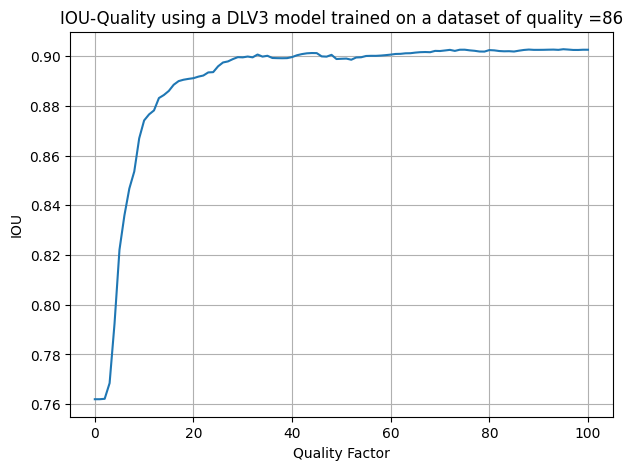

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05375, iou_score - 0.9027]
DLV3 model trained on dataset of quality= 86 
test on uncompressed dataset
Evaluation Loss: 0.05374709531372668
Evaluation IoU: 0.9026547167815413
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1438, iou_score - 0.7653]
Evaluation Loss: 0.14376387876622812
Evaluation IoU: 0.7652628562029669
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

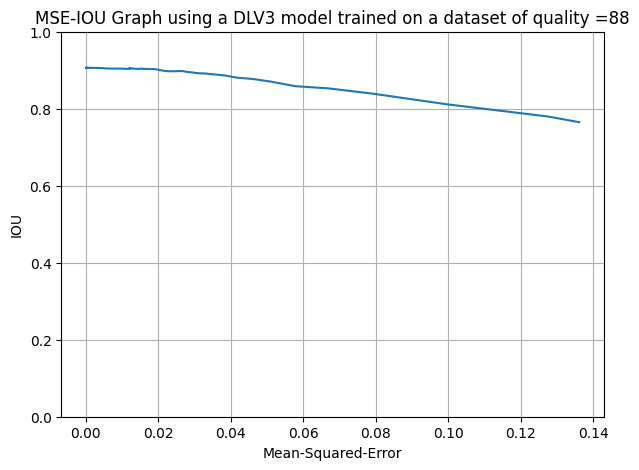

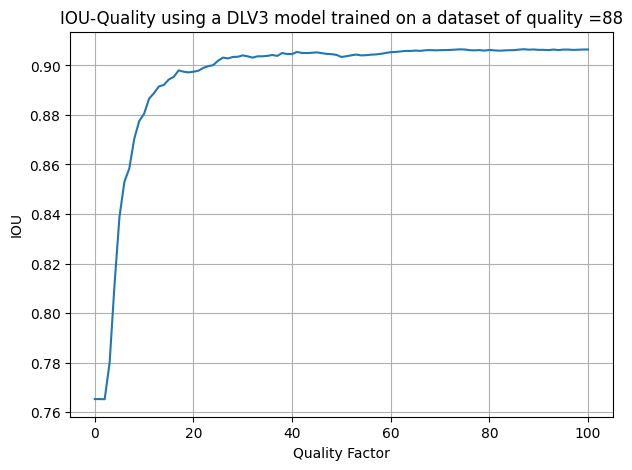

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05118, iou_score - 0.9065]
DLV3 model trained on dataset of quality= 88 
test on uncompressed dataset
Evaluation Loss: 0.05118396235447305
Evaluation IoU: 0.9064837051372904
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1452, iou_score - 0.764] 
Evaluation Loss: 0.145208829758214
Evaluation IoU: 0.7639911297489617
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00, 

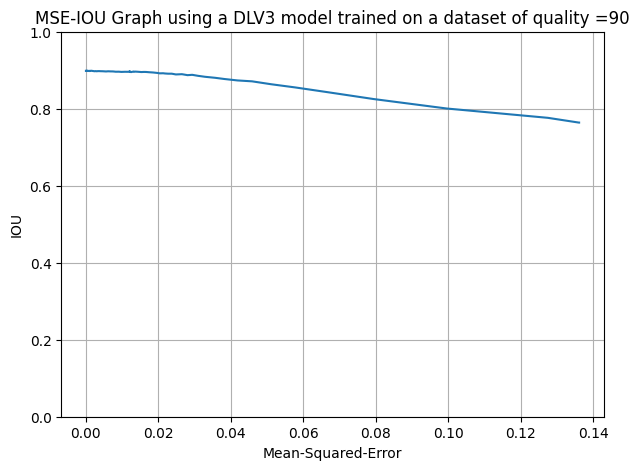

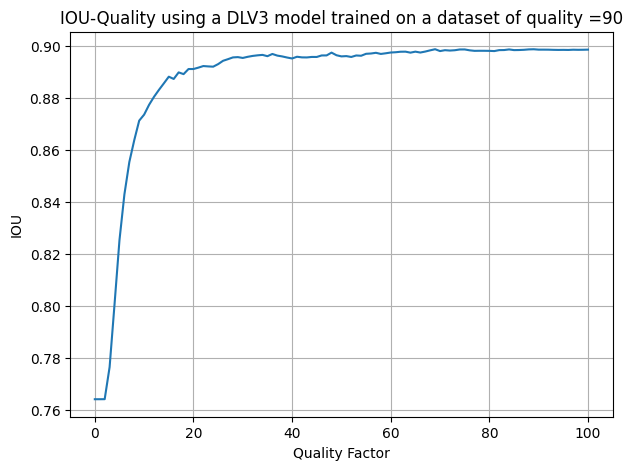

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.05653, iou_score - 0.8985]
DLV3 model trained on dataset of quality= 90 
test on uncompressed dataset
Evaluation Loss: 0.056532501005658924
Evaluation IoU: 0.8985048181870403
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.1447, iou_score - 0.7637]
Evaluation Loss: 0.14471661810781444
Evaluation IoU: 0.7636892024208519
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

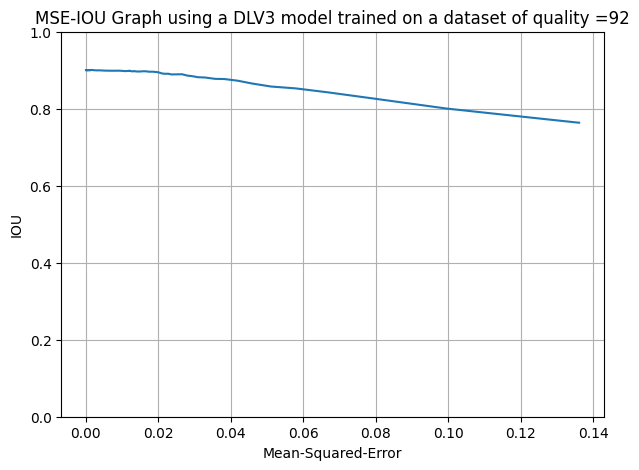

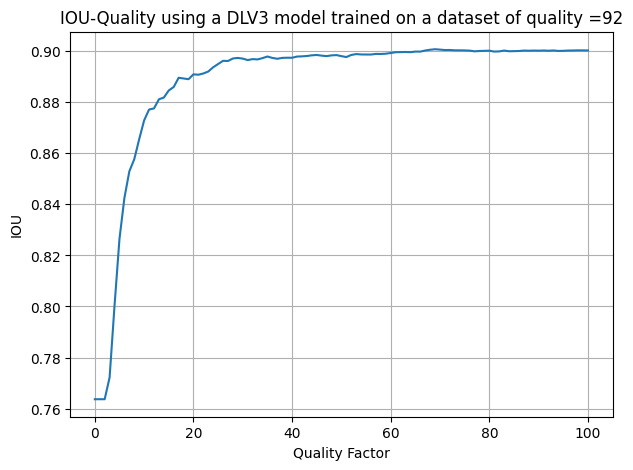

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05493, iou_score - 0.9002]
DLV3 model trained on dataset of quality= 92 
test on uncompressed dataset
Evaluation Loss: 0.05492698211295933
Evaluation IoU: 0.9002438059040144
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1514, iou_score - 0.7541]
Evaluation Loss: 0.1513878819989223
Evaluation IoU: 0.7540899205441568
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

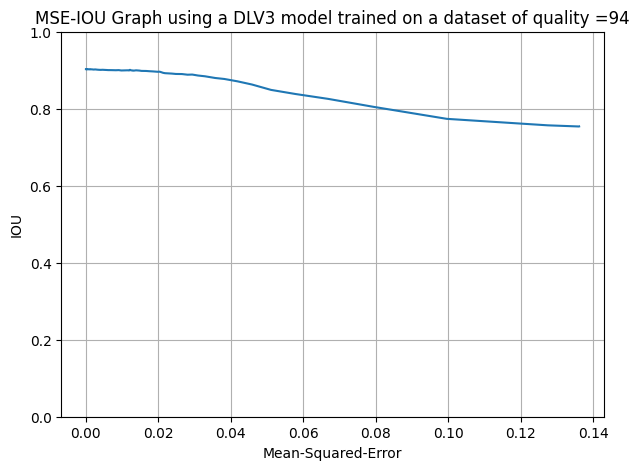

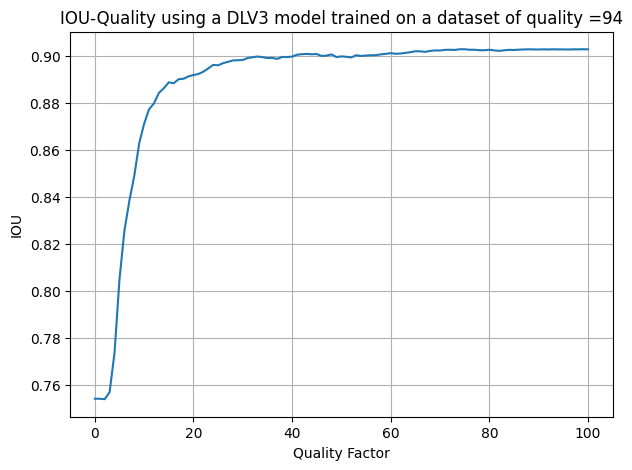

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05327, iou_score - 0.9028]
DLV3 model trained on dataset of quality= 94 
test on uncompressed dataset
Evaluation Loss: 0.05327143739251529
Evaluation IoU: 0.9028246145622402
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1484, iou_score - 0.7578]
Evaluation Loss: 0.14839289352005602
Evaluation IoU: 0.7577751670397962
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

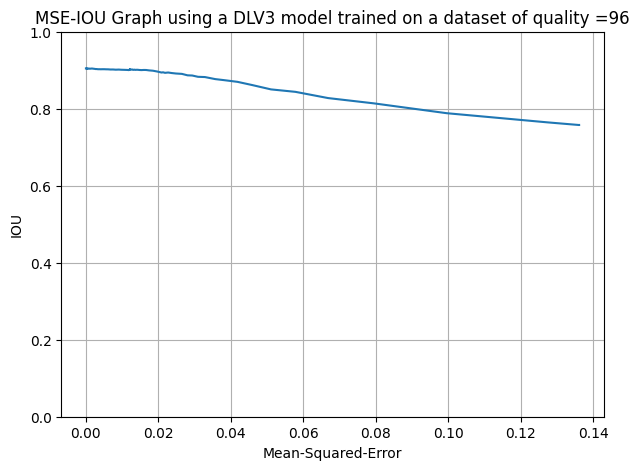

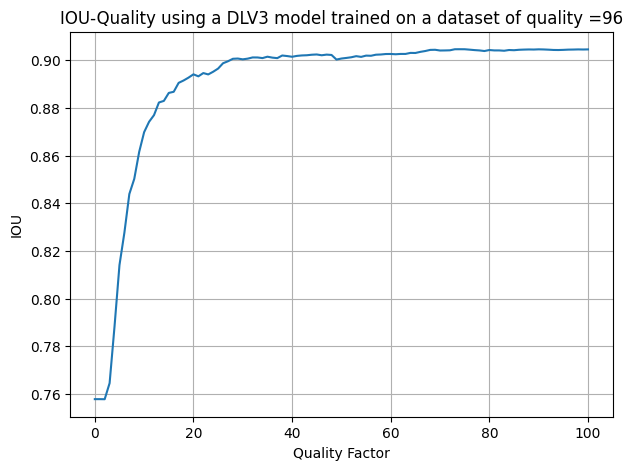

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05236, iou_score - 0.9046]
DLV3 model trained on dataset of quality= 96 
test on uncompressed dataset
Evaluation Loss: 0.052363110523597864
Evaluation IoU: 0.9046074935034208
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.1457, iou_score - 0.7624]
Evaluation Loss: 0.145655821351444
Evaluation IoU: 0.7624347601451129
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

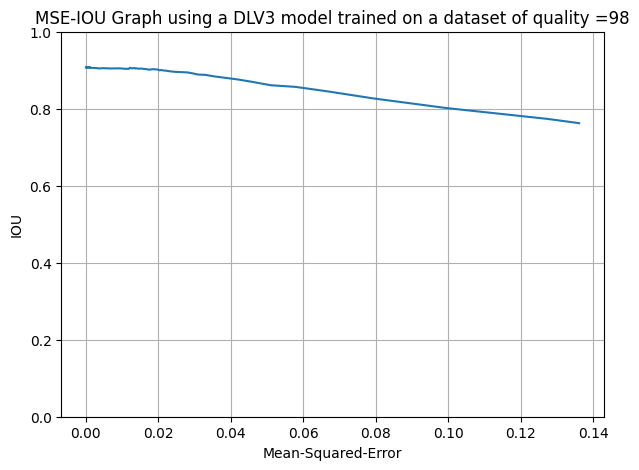

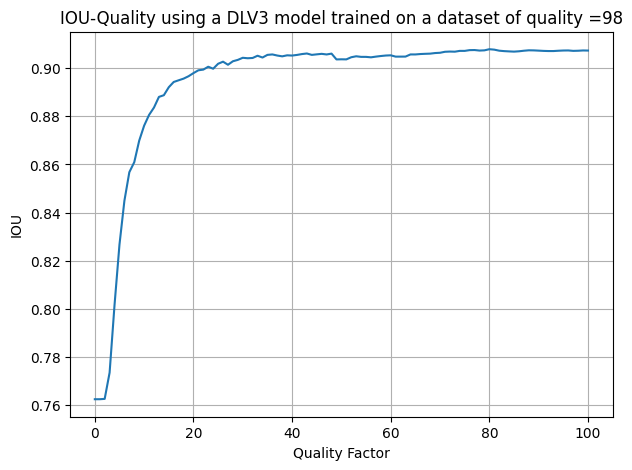

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.05125, iou_score - 0.9072]
DLV3 model trained on dataset of quality= 98 
test on uncompressed dataset
Evaluation Loss: 0.051252396667704855
Evaluation IoU: 0.9072107532445122
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.143, iou_score - 0.7653] 
Evaluation Loss: 0.14296383133121562
Evaluation IoU: 0.7652923003131268
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

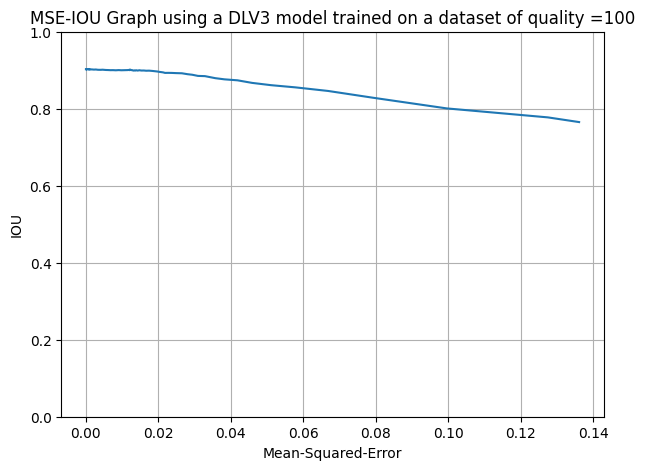

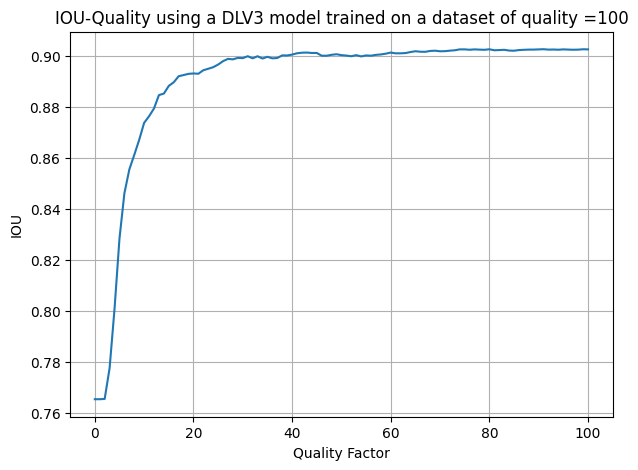

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05338, iou_score - 0.9026]
DLV3 model trained on dataset of quality= 100 
test on uncompressed dataset
Evaluation Loss: 0.05338491178026387
Evaluation IoU: 0.9026266254630744


In [27]:
test_DLV3()

In [1]:
DLV3_uncomp_res = [0.8300894492981482, 0.8762721524519079, 0.8811113927878584, 0.898972159507228, 0.8897402602083542, 0.9003049964998281, 0.9022508310336693, 0.9038624716740027, 0.8970502100738822, 0.897736421987122, 0.9048560320162304, 0.9054151679955278, 0.9072354833285013, 0.9013614993469388, 0.9017656936365017, 0.9120122439721052, 0.9066827472518472, 0.9017927623262592, 0.904326535907446, 0.9076081561107262, 0.9049851298332214, 0.9035382165628321, 0.9106030113556804, 0.9050103577913023,0.8978629392736099, 0.9048914804178124, 0.9031434140953364, 0.9100766742930693, 0.9079617425507189, 0.9081633067598525, 0.9094225320161557, 0.9020944483139939, 0.9029726830183291, 0.903540945520588, 0.905523459116618, 0.9005972333982876, 0.8990189666841542, 0.8970590479233684, 0.9009653329849244,0.9047652716730155,0.9038800947806415,0.9049816295212391, 0.9010394180522246, 0.9026547167815413,0.9064837051372904, 0.8985048181870403, 0.9002438059040144, 0.9028246145622402, 0.9046074935034208, 0.9072107532445122, 0.9026266254630744]
print(len(DLV3_uncomp_res))

51


UNET Training

In [ ]:
def UNET_training_loop():
    UNET_directory = "{}{}{}{}".format()("models",os.sep,"best_models_UNET",os.sep)
    os.makedirs(UNET_directory, exist_ok=True)
    for q in range (0, 101, step_size):
        model_UNET = smp.Unet(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
        # datasets for training
        training_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Train",os.sep)
        training_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Trainannot",os.sep)

        val_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validation",os.sep)
        val_masks_directory= "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validationannot",os.sep)
        labels_directory = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"label_colors.txt")
        # Create a training dataset using images from X_TRAIN_DIR and masks from Y_TRAIN_DIR.
        # Add augmentations defined by get_training_augmentation() and apply preprocessing defined by get_preprocessing(preprocessing_fn).
        training_dataset = Excavators(
            training_data_directory, 
            training_masks_directory, 
            labels_directory,
            augmentation=get_training_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # Create a validation dataset using images from X_VALID_DIR and masks from Y_VALID_DIR.
        # Add validation augmentations defined by get_validation_augmentation() and apply the same preprocessing function as the training dataset.
        valid_dataset = Excavators(
            val_data_directory, 
            val_masks_directory, 
            labels_directory,
            augmentation=get_validation_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # create training and validation dataloaders
        train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(valid_dataset, batch_size= 1, shuffle=False)
        
        # Define the criterion, metric and optimizer for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()]
        optimizer_UNET = torch.optim.Adam([ 
            dict(params=model_UNET.parameters(), lr=lr),  # Use Adam optimizer with initial learning rate INIT_LR
        ])

        # define train and valid epoch for 1 model
        train_epoch = utils.train.TrainEpoch(
            model_UNET,                    # Model to be trained
            loss= criterion,                # Loss function to compute during training
            metrics=metric,          # Metrics to compute during training (e.g., F-score, IoU)
            optimizer=optimizer_UNET,      # Optimizer used to update model parameters
            device=DEVICE,            # Device (CPU or GPU) where the training takes place
            verbose=True,             # Print training progress (verbose mode)
        )

        # Create an epoch runner for validation.
        # This object encapsulates the validation loop over the samples in the dataloader.
        valid_epoch = utils.train.ValidEpoch(
            model_UNET,                    # Model to be evaluated
            loss= criterion,                # Loss function to compute during validation
            metrics= metric,          # Metrics to compute during validation
            device=DEVICE,            # Device (CPU or GPU) where the validation takes place
            verbose=True,             # Print validation progress (verbose mode)
        )

        # train and define save directories for one model
        UNET_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_UNET",os.sep,q,".pth")
        UNET_jit_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_UNET",os.sep,q,".pt")
        loss_logs_UNET, metric_logs_UNET = training_loop(model_UNET, optimizer_UNET, train_loader,val_loader, train_epoch, valid_epoch, UNET_save_dir, UNET_jit_save_dir)
        # Plotting training and validation losses and metrics
        fig, axes = plt.subplots(1, 2, figsize=(10,4))
        axes[0].plot(loss_logs_UNET["train"], label = "train")
        axes[0].plot(loss_logs_UNET["val"], label = "val")
        axes[0].set_title(f"losses - Dice")

        axes[1].plot(metric_logs_UNET["train"], label = "train")
        axes[1].plot(metric_logs_UNET["val"], label = "val")
        axes[1].set_title(f"IOU")

        # Adding a main title for both plots
        plt.suptitle(f"UNET model trained on quality = {q} ", fontsize=16)

        # Adjusting layout to make room for the main title
        plt.tight_layout(rect=[0, 0, 1, 0.95])

        # [ax.legend() for ax in axes]

In [ ]:
UNET_training_loop()

UNET Evaluation

In [5]:
# Unzip trained models folder 
zip_path = "{}{}{}".format( "models", os.sep, "best_models_UNET.zip")
extract_path = "{}{}{}".format( "models", os.sep,"best_models_UNET")
# Create the extraction directory if it doesn't exist
os.makedirs(extract_path, exist_ok=True)

# Open the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    # Extract all contents
    zip_ref.extractall(extract_path)

print(f"Extracted to {extract_path}")

Extracted to models\best_models_UNET


In [2]:
models_path = "{}{}{}{}".format("models",os.sep,"best_models_UNET",os.sep)
files = os.listdir(models_path)
pth_files = [file for file in files if file.endswith('.pth')]
print(len(pth_files))
UNET_uncomp_res = []

# Sort by the numeric part of the filename
pth_files_sorted = sorted(pth_files, key=lambda x: int(x.split('.')[0]))
print(pth_files_sorted)
def test_UNET():
    save_dir_MSE = "{}{}{}{}{}".format("Results",os.sep,"UNET",os.sep,"MSE_IOU")
    save_dir_Q = "{}{}{}{}{}".format("Results",os.sep,"UNET",os.sep,"Q_IOU")
    os.makedirs(save_dir_MSE, exist_ok=True)
    os.makedirs(save_dir_Q, exist_ok=True)
    for file in pth_files_sorted:
        number = file.split('.')[0]
        q = int(number)
        # load best instance of model
        model_path = "{}{}{}{}{}{}".format("models",os.sep,"best_models_UNET",os.sep,q,".pth")
        model_UNET = torch.load(model_path)
        model_UNET.eval()

        # Define the criterion and metric for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()] 

        # define evaluation epochs
        eval_epoch_UNET = utils.train.ValidEpoch(
            model=model_UNET,            # Model to be evaluated
            loss=criterion,         # Loss function
            metrics=metric,        # List of metrics
            device=DEVICE,          # Device (CPU or GPU)
            verbose=True            # Print evaluation progress
        )

        base_test_dir = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"TestCompressed",os.sep)
        cor_mse_UNET = {} # quality:MSE dictionary
        IOU_scores_UNET ={} # quality: IOU dictionary
        for i in range(0, 101, 1):
            comp_test_dir = os.path.join(base_test_dir,str(i))
            print(comp_test_dir)
            # create test dataset
            comp_test_dataset = Excavators(
                comp_test_dir,  # Directory containing test images
                test_masks_directory,  # Directory containing test masks
                labels_directory,
                augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
                preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
                )
            mse_values =[]
            for j in range(len(comp_test_dataset)):
                comp_image,_ = comp_test_dataset[j]
                original_image, _ = test_dataset[j]
                mse = calculate_mse(original_image, comp_image)
                mse_values.append(mse)
            cor_mse_UNET[i] = calc_avg_mse(mse_values)
            print('MSE: ', cor_mse_UNET[i])

            

            test_loader = DataLoader(comp_test_dataset)
            eval_logs = eval_epoch_UNET.run(test_loader)
            eval_loss, eval_metric_IOU = list(eval_logs.values())
            IOU_scores_UNET[i] = eval_metric_IOU

            # Print evaluation results
            print(f"Evaluation Loss: {eval_loss}")
            print(f"Evaluation IoU: {eval_metric_IOU}")  

        mse_iou_dictionary_UNET = {value: IOU_scores_UNET[key] for key, value in cor_mse_UNET.items()}
        # Sort the dictionary by its keys (x values) in ascending order
        sorted_mse_iou_dict_UNET = {k: v for k, v in sorted(mse_iou_dictionary_UNET.items())}

        # create a graph
        x1 = list(sorted_mse_iou_dict_UNET.keys()) # MSE VALUES
        y1 = list(sorted_mse_iou_dict_UNET.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.ylim(0, 1)
        plt.plot(x1, y1)  # Plot with markers
        plt.xlabel('Mean-Squared-Error')  # Label for X-axis
        plt.ylabel('IOU')  # Label for Y-axis
        plt.title(f'MSE-IOU Graph using a UNET model trained on a dataset of quality ={q}')  # Title of the graph
        plt.grid(True)  # Show grid
        plt.savefig(os.path.join(save_dir_MSE, f'{q}.png'))
        plt.show() 
        

        # plot quality over IOU
        x2 = list(IOU_scores_UNET.keys()) # quality VALUES
        y2 = list(IOU_scores_UNET.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.plot(x2, y2)  
        plt.xlabel('Quality Factor')
        plt.ylabel('IOU')
        plt.title(f'IOU-Quality using a UNET model trained on a dataset of quality ={q}')
        plt.grid(True)
        plt.savefig(os.path.join(save_dir_Q, f'{q}.png'))
        plt.show()

        # Test on normal dataset
        test_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Test",os.sep)
        normal_test_dataset = Excavators(
            test_data_directory,  # Directory containing test images
            test_masks_directory,  # Directory containing test masks
            labels_directory,
            augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
            preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
            )
        normal_test_loader = DataLoader(normal_test_dataset)
        eval_logs = eval_epoch_UNET.run(normal_test_loader)
        eval_loss_UNET, eval_metric_IOU_UNET = list(eval_logs.values())
        UNET_uncomp_res.append(eval_metric_IOU_UNET)
        # Print evaluation results
        print(f"UNET model trained on dataset of quality= {q} \ntest on uncompressed dataset")
        print(f"Evaluation Loss: {eval_loss_UNET}")
        print(f"Evaluation IoU: {eval_metric_IOU_UNET}")
    print(UNET_uncomp_res)

NameError: name 'os' is not defined

excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.1427, iou_score - 0.7681]
Evaluation Loss: 0.14271633765276734
Evaluation IoU: 0.768128482734456
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.24it/s, dice_loss - 0.1427, iou_score - 0.7681]
Evaluation Loss: 0.14271633765276734
Evaluation IoU: 0.768128482734456
excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.135991
valid: 100%|██████████| 51/51 [00:15<00:00

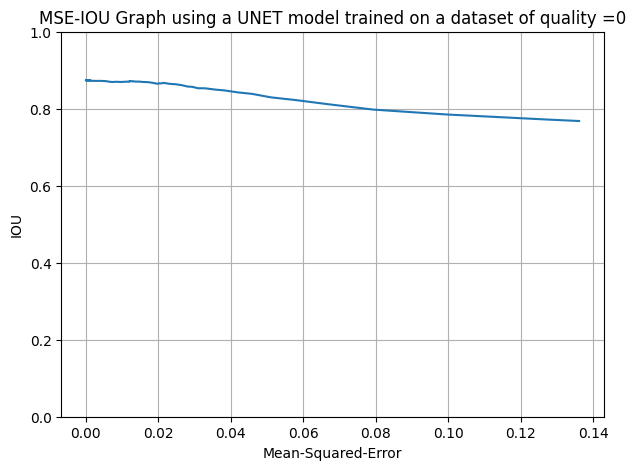

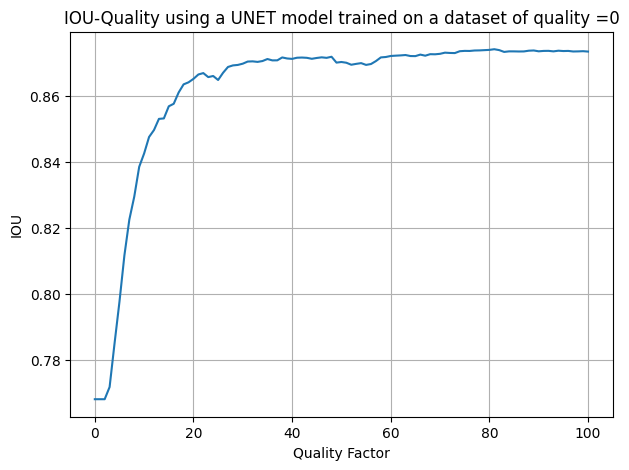

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.07239, iou_score - 0.8737]
UNET model trained on dataset of quality= 0 
test on uncompressed dataset
Evaluation Loss: 0.0723892076342714
Evaluation IoU: 0.8736871001767181
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.1463, iou_score - 0.7611]
Evaluation Loss: 0.1463194629725288
Evaluation IoU: 0.761113949850494
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3

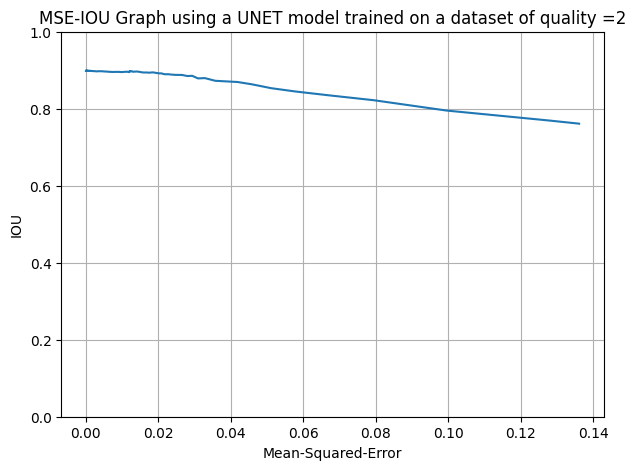

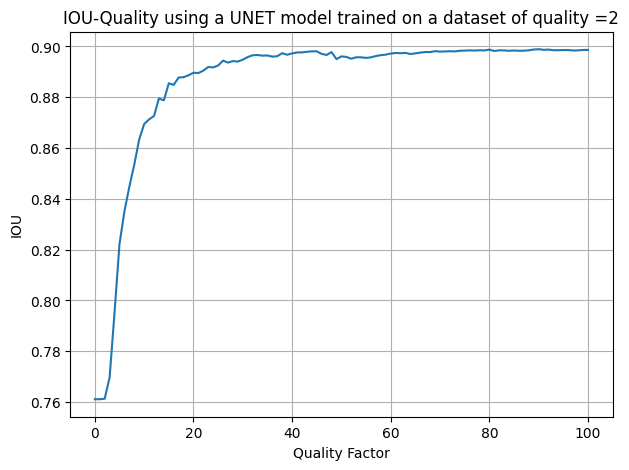

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05596, iou_score - 0.8984]
UNET model trained on dataset of quality= 2 
test on uncompressed dataset
Evaluation Loss: 0.055961057251574936
Evaluation IoU: 0.8983676468624789
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1477, iou_score - 0.759] 
Evaluation Loss: 0.14768893929088814
Evaluation IoU: 0.7589997701785144
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

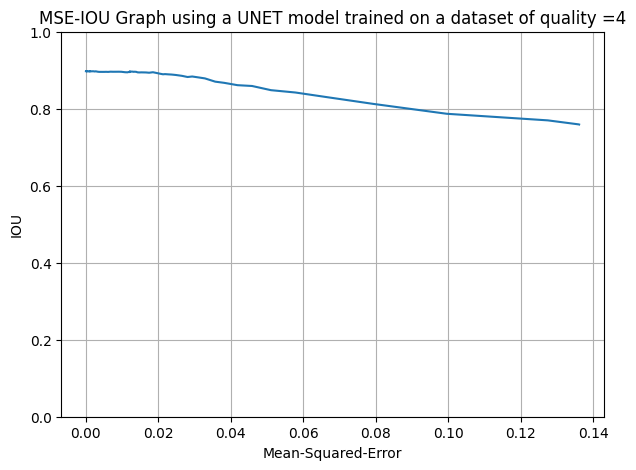

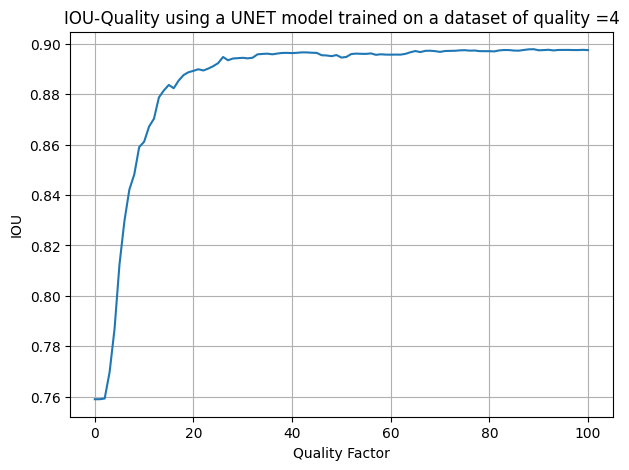

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.05668, iou_score - 0.8975]
UNET model trained on dataset of quality= 4 
test on uncompressed dataset
Evaluation Loss: 0.056678724055196715
Evaluation IoU: 0.8974945954248017
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1449, iou_score - 0.7616]
Evaluation Loss: 0.14494369777978633
Evaluation IoU: 0.7615527890476527
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

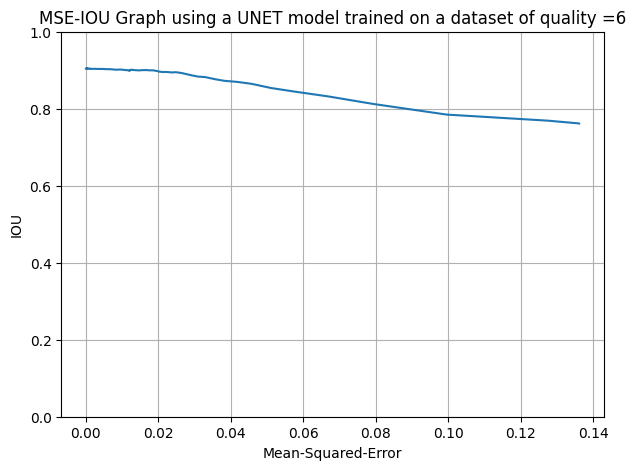

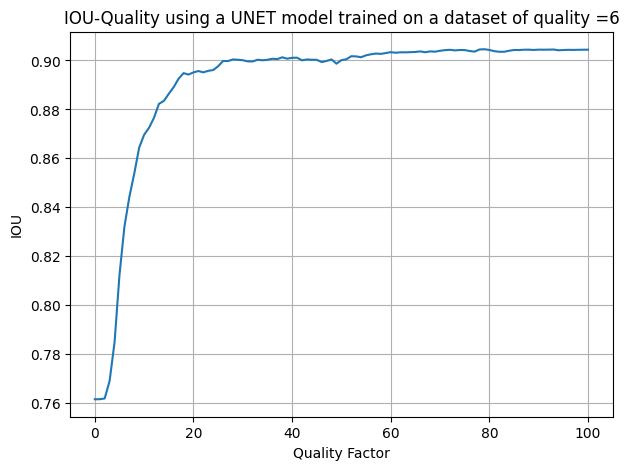

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.05246, iou_score - 0.9043]
UNET model trained on dataset of quality= 6 
test on uncompressed dataset
Evaluation Loss: 0.052458427700341925
Evaluation IoU: 0.9043271822087906
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1455, iou_score - 0.7622]
Evaluation Loss: 0.14548251909368176
Evaluation IoU: 0.7621555778325773
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

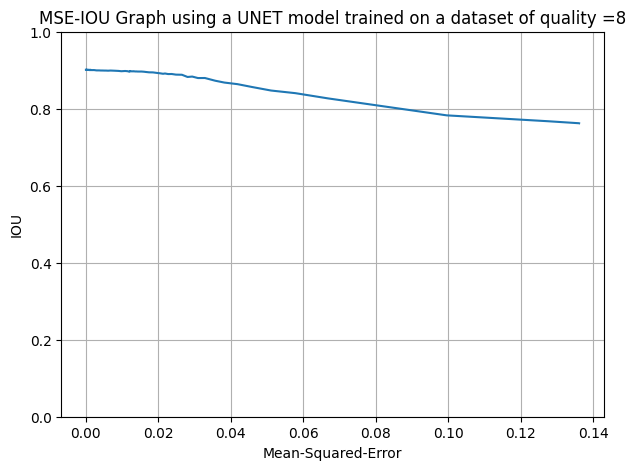

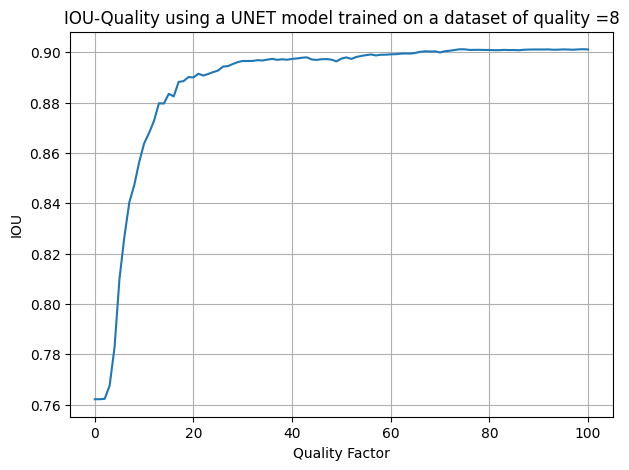

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.53it/s, dice_loss - 0.05439, iou_score - 0.9012]
UNET model trained on dataset of quality= 8 
test on uncompressed dataset
Evaluation Loss: 0.05438988699632532
Evaluation IoU: 0.9011958755698857
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.1431, iou_score - 0.7658]
Evaluation Loss: 0.14312196479124184
Evaluation IoU: 0.7657599834834828
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

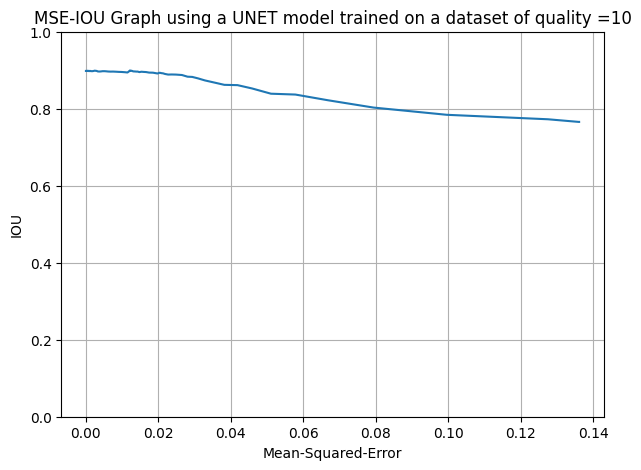

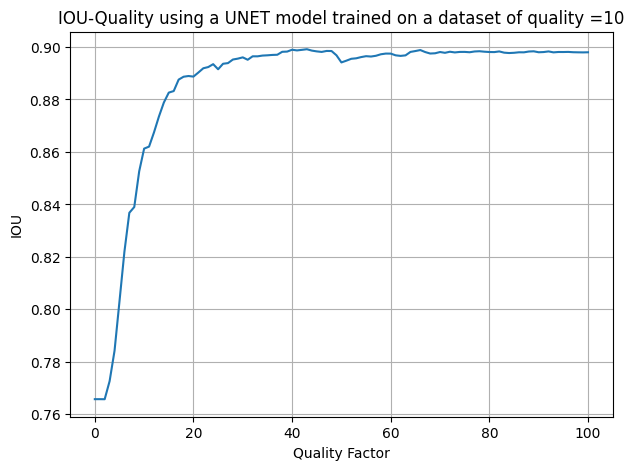

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.50it/s, dice_loss - 0.05613, iou_score - 0.8982]
UNET model trained on dataset of quality= 10 
test on uncompressed dataset
Evaluation Loss: 0.056131632889018346
Evaluation IoU: 0.8981674640786413
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1401, iou_score - 0.7701]
Evaluation Loss: 0.14009172425550576
Evaluation IoU: 0.7700764589449942
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:0

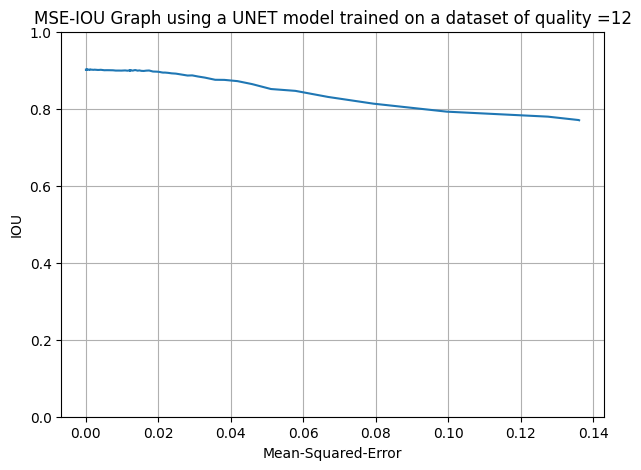

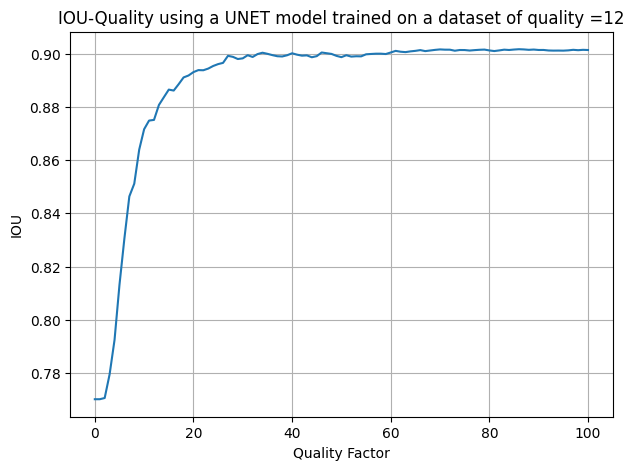

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.53it/s, dice_loss - 0.05427, iou_score - 0.9014]
UNET model trained on dataset of quality= 12 
test on uncompressed dataset
Evaluation Loss: 0.05427351301791622
Evaluation IoU: 0.9014403364237615
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.1453, iou_score - 0.7625]
Evaluation Loss: 0.14527644596847836
Evaluation IoU: 0.7624698976675668
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

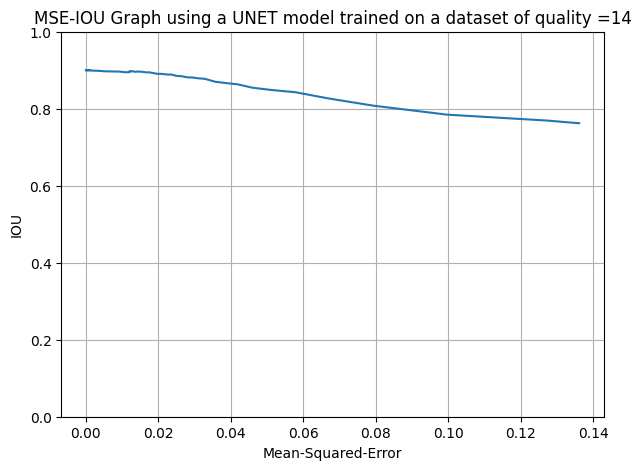

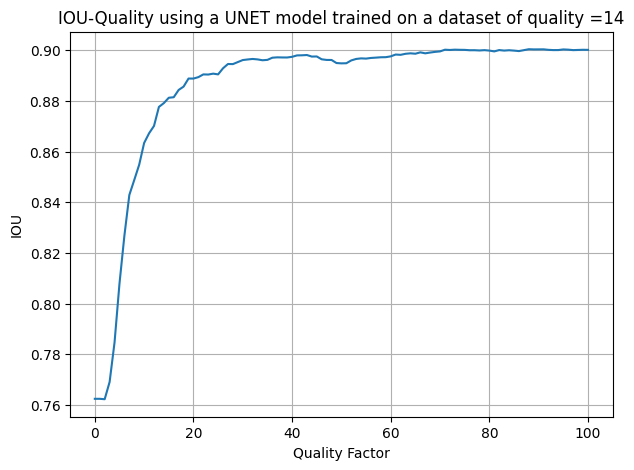

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05512, iou_score - 0.9001]
UNET model trained on dataset of quality= 14 
test on uncompressed dataset
Evaluation Loss: 0.05512432491078096
Evaluation IoU: 0.9000985365287929
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.70it/s, dice_loss - 0.1403, iou_score - 0.7699]
Evaluation Loss: 0.14034729611639885
Evaluation IoU: 0.7699426102871989
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

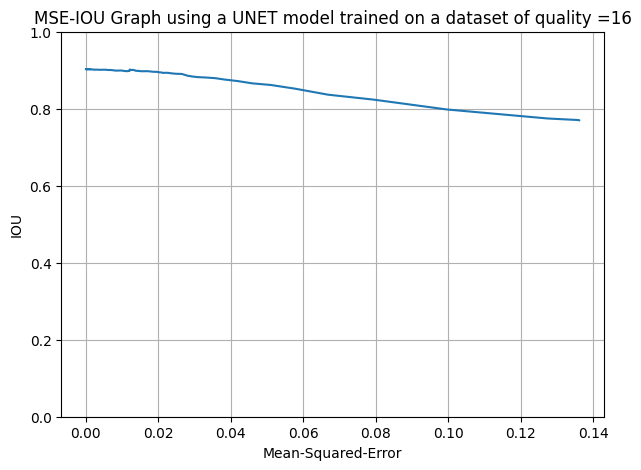

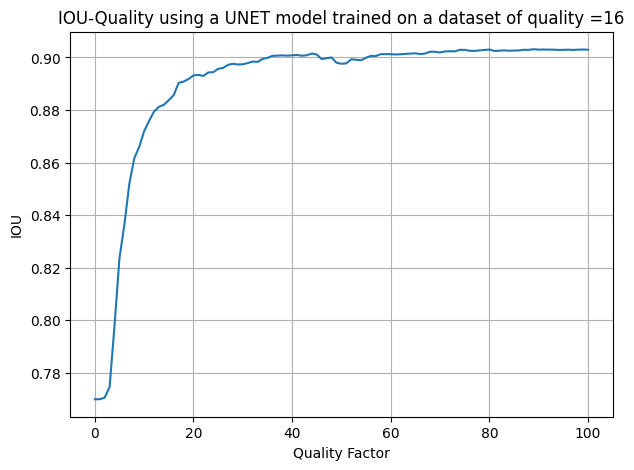

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05357, iou_score - 0.9029]
UNET model trained on dataset of quality= 16 
test on uncompressed dataset
Evaluation Loss: 0.05356761637855979
Evaluation IoU: 0.9028996310982048
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.71it/s, dice_loss - 0.146, iou_score - 0.7615] 
Evaluation Loss: 0.14601281928081136
Evaluation IoU: 0.7615404789354288
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

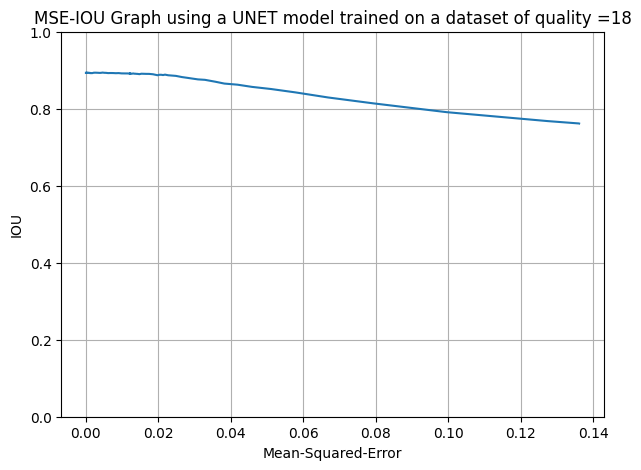

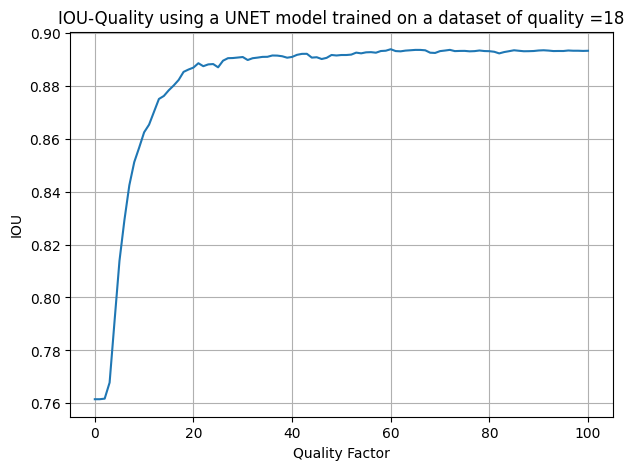

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05884, iou_score - 0.8933]
UNET model trained on dataset of quality= 18 
test on uncompressed dataset
Evaluation Loss: 0.05884143534828636
Evaluation IoU: 0.8932734342182385
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.70it/s, dice_loss - 0.1492, iou_score - 0.7568]
Evaluation Loss: 0.14918455423093313
Evaluation IoU: 0.7567960824452195
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

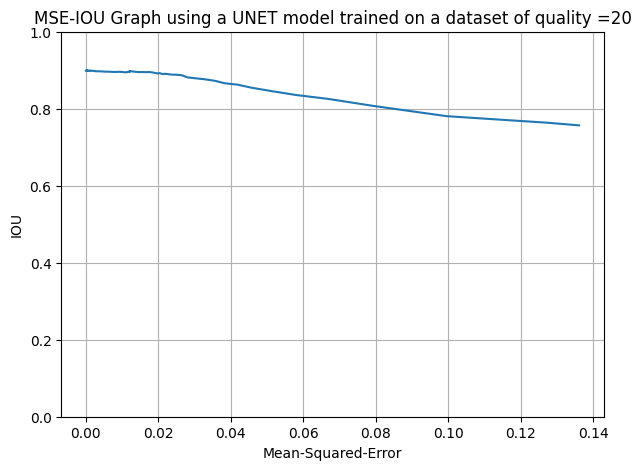

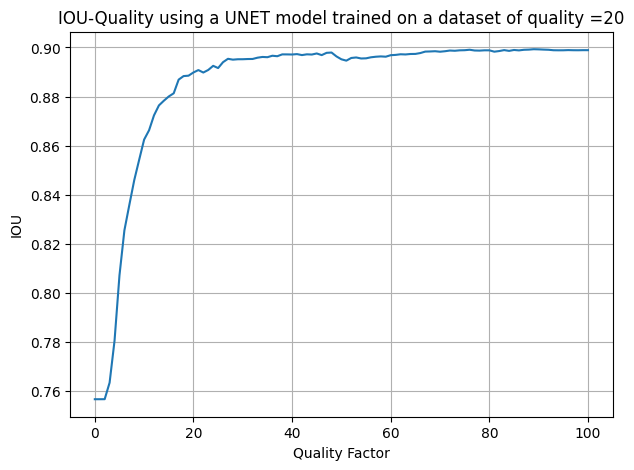

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05575, iou_score - 0.8989]
UNET model trained on dataset of quality= 20 
test on uncompressed dataset
Evaluation Loss: 0.05575432029424929
Evaluation IoU: 0.898876548982134
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.1484, iou_score - 0.7579]
Evaluation Loss: 0.14842478784860347
Evaluation IoU: 0.7578881862116794
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

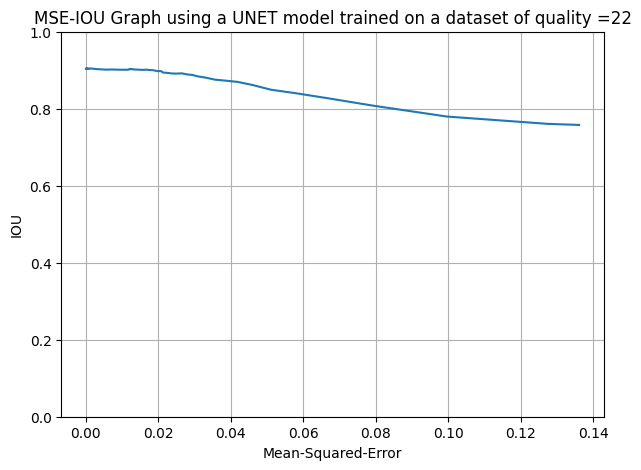

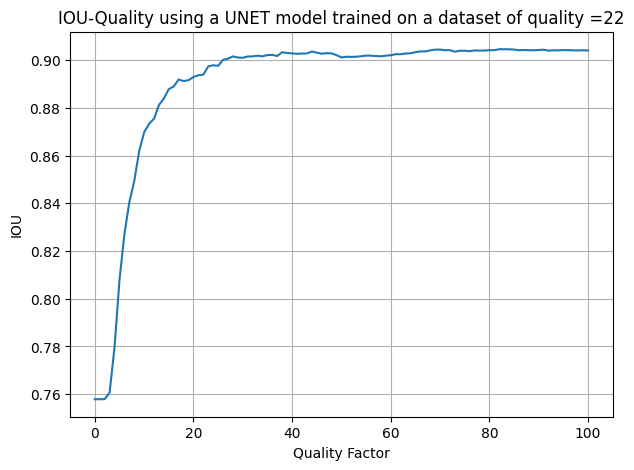

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.05264, iou_score - 0.904] 
UNET model trained on dataset of quality= 22 
test on uncompressed dataset
Evaluation Loss: 0.05264100607703716
Evaluation IoU: 0.9040203924272576
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.71it/s, dice_loss - 0.1444, iou_score - 0.7634]
Evaluation Loss: 0.14439649909150368
Evaluation IoU: 0.7634214530972874
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

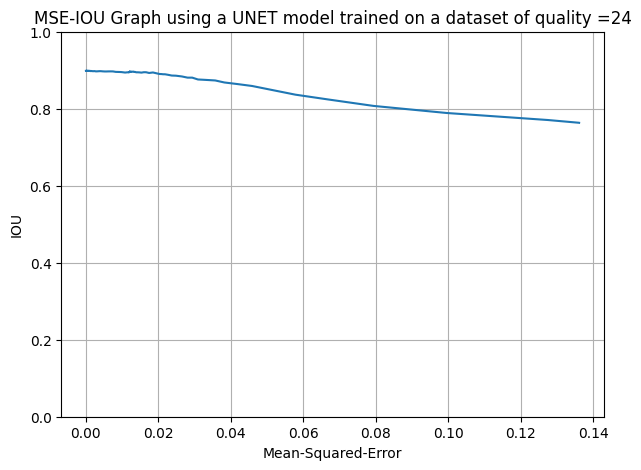

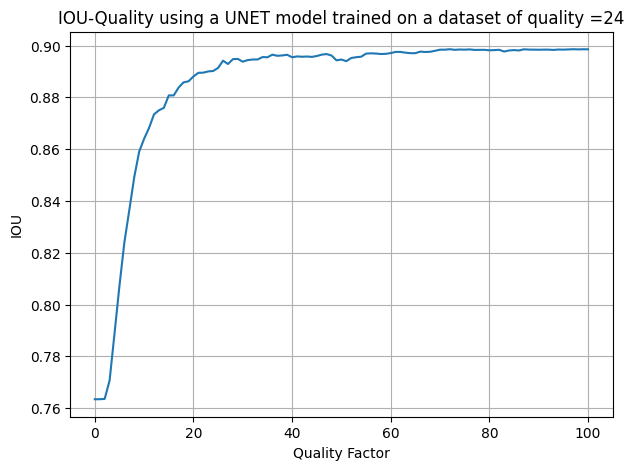

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.05612, iou_score - 0.8984]
UNET model trained on dataset of quality= 24 
test on uncompressed dataset
Evaluation Loss: 0.05612347523371378
Evaluation IoU: 0.8983956084531897
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1477, iou_score - 0.759] 
Evaluation Loss: 0.14773017752404313
Evaluation IoU: 0.7590412105999743
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

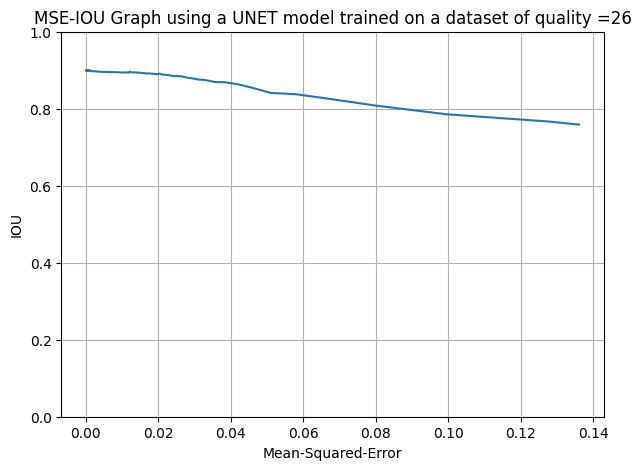

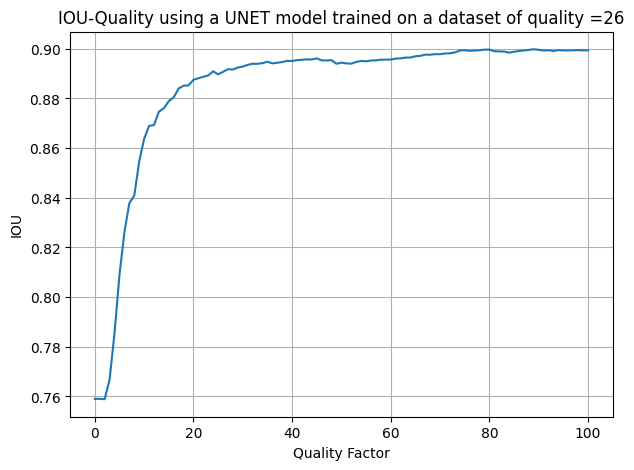

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.55it/s, dice_loss - 0.05552, iou_score - 0.8995]
UNET model trained on dataset of quality= 26 
test on uncompressed dataset
Evaluation Loss: 0.05551878961862301
Evaluation IoU: 0.8994515842082453
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.1433, iou_score - 0.7651]
Evaluation Loss: 0.14333226750878736
Evaluation IoU: 0.7650974030588188
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

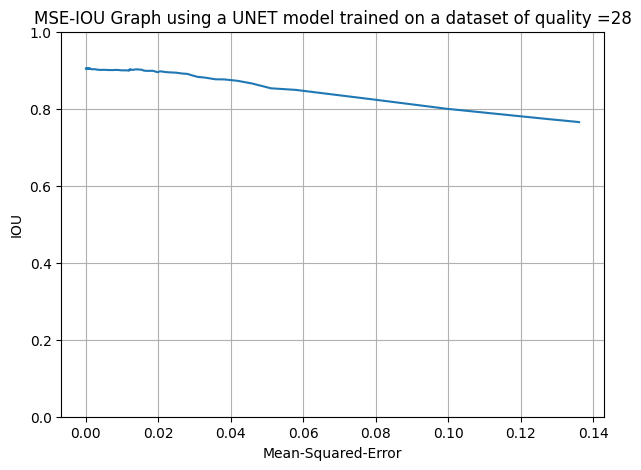

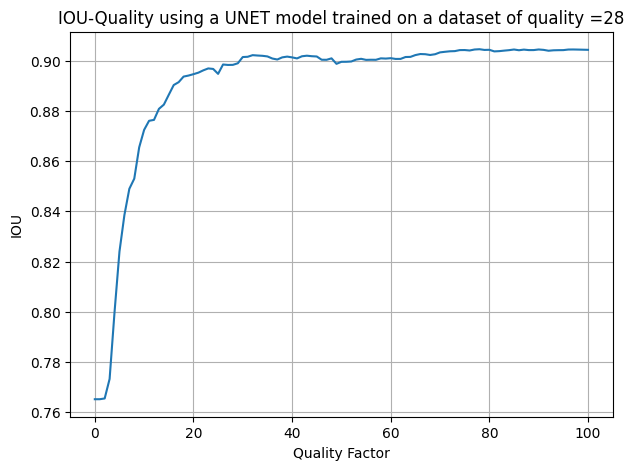

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.05276, iou_score - 0.9043]
UNET model trained on dataset of quality= 28 
test on uncompressed dataset
Evaluation Loss: 0.05276096802131802
Evaluation IoU: 0.9043489332292592
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1441, iou_score - 0.7644]
Evaluation Loss: 0.14406275632334692
Evaluation IoU: 0.7643721705558253
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

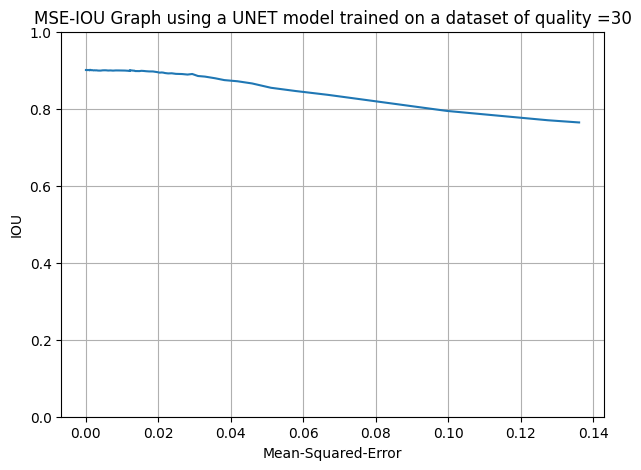

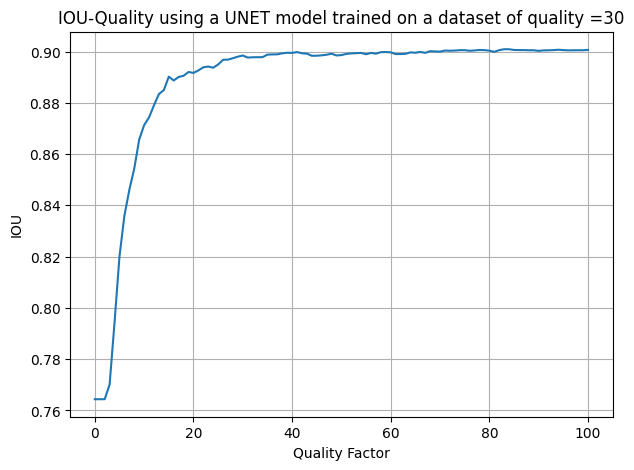

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.05509, iou_score - 0.9005]
UNET model trained on dataset of quality= 30 
test on uncompressed dataset
Evaluation Loss: 0.05509159027361403
Evaluation IoU: 0.9005005020721285
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1419, iou_score - 0.7673]
Evaluation Loss: 0.14193666331908283
Evaluation IoU: 0.7673121766716826
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

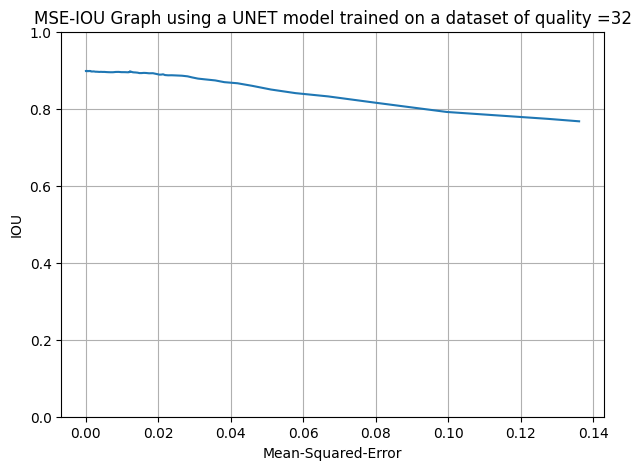

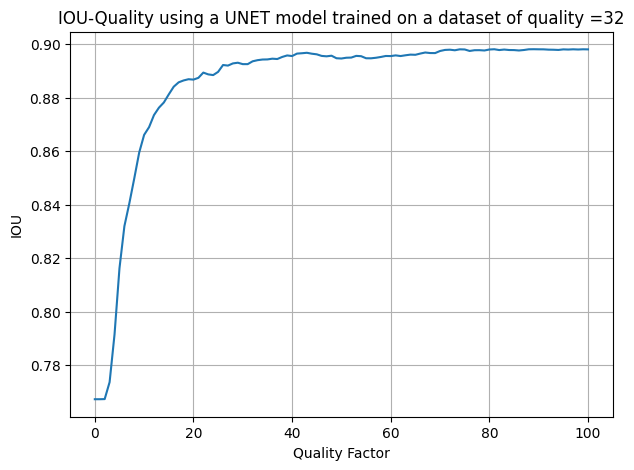

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.53it/s, dice_loss - 0.05639, iou_score - 0.898] 
UNET model trained on dataset of quality= 32 
test on uncompressed dataset
Evaluation Loss: 0.05639008914723114
Evaluation IoU: 0.898041508945764
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.147, iou_score - 0.7599] 
Evaluation Loss: 0.1470137624179616
Evaluation IoU: 0.7598891252396153
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00, 

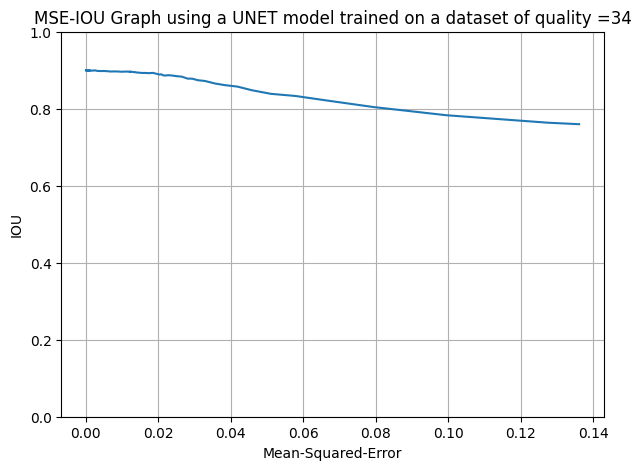

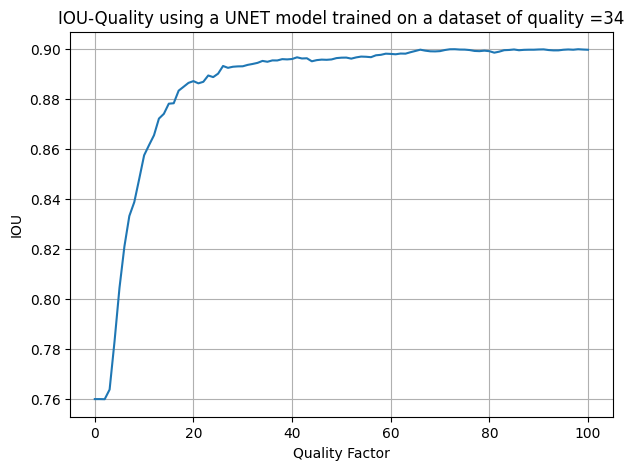

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.05549, iou_score - 0.8996]
UNET model trained on dataset of quality= 34 
test on uncompressed dataset
Evaluation Loss: 0.05548570202846154
Evaluation IoU: 0.8996372117715721
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1418, iou_score - 0.7674]
Evaluation Loss: 0.14176166174458524
Evaluation IoU: 0.7673996003235088
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

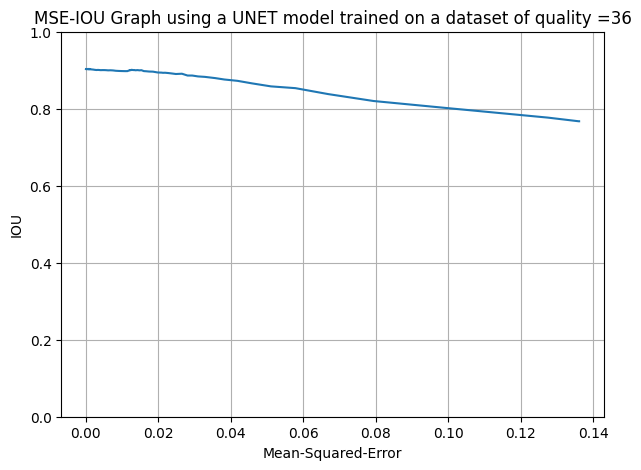

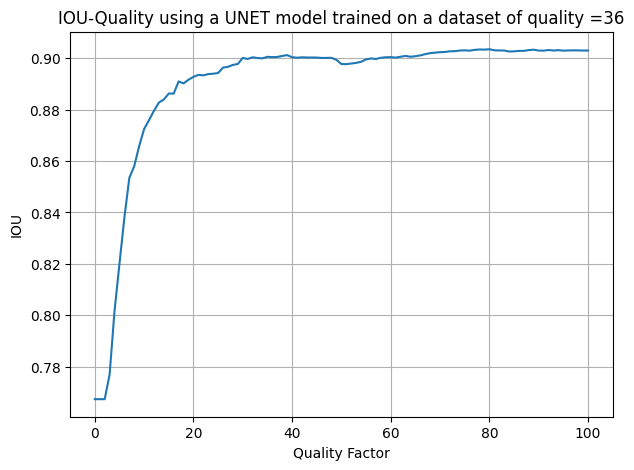

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.05325, iou_score - 0.903] 
UNET model trained on dataset of quality= 36 
test on uncompressed dataset
Evaluation Loss: 0.05324638707965027
Evaluation IoU: 0.9030175910276523
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1412, iou_score - 0.7681]
Evaluation Loss: 0.14122939577289656
Evaluation IoU: 0.768081153724708
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

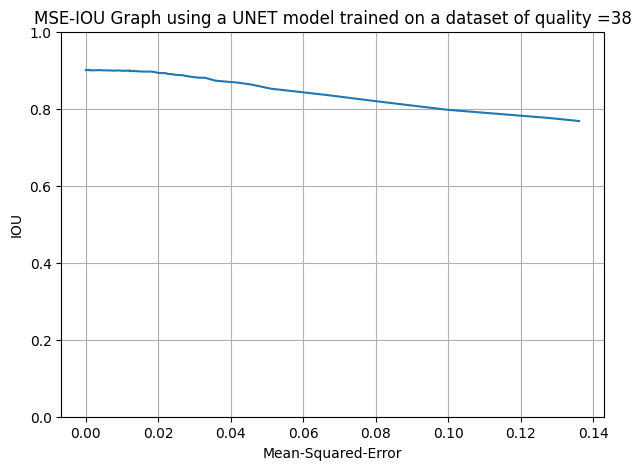

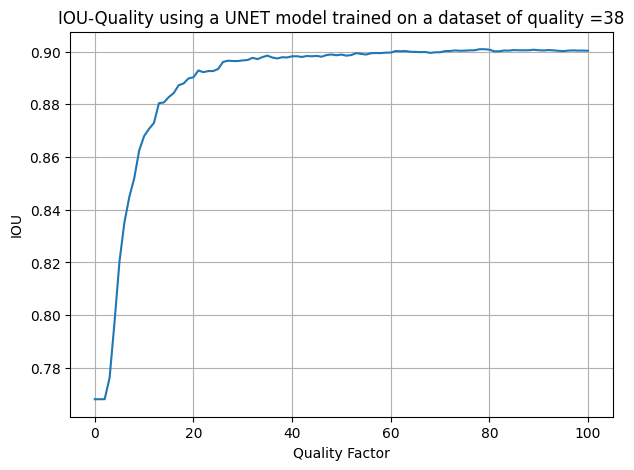

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.40it/s, dice_loss - 0.05472, iou_score - 0.9004]
UNET model trained on dataset of quality= 38 
test on uncompressed dataset
Evaluation Loss: 0.054723204350938984
Evaluation IoU: 0.9003541598133015
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1406, iou_score - 0.7693]
Evaluation Loss: 0.14058397447361662
Evaluation IoU: 0.7693419146771525
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

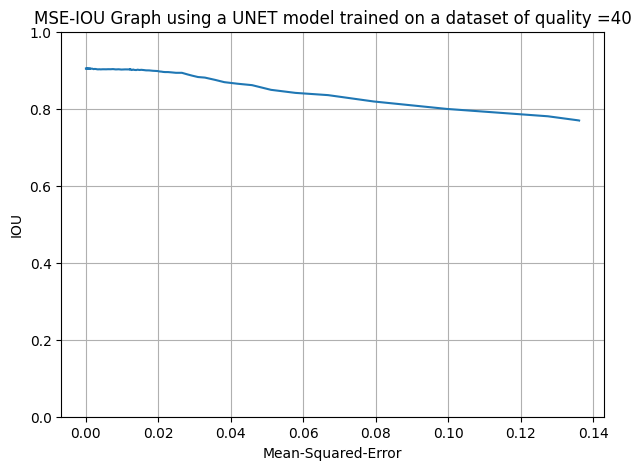

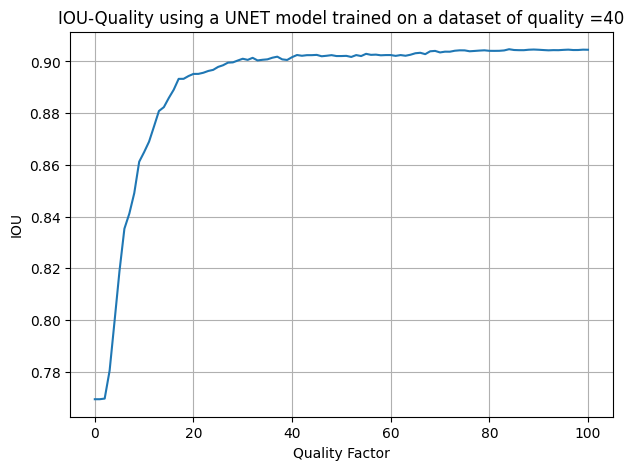

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.0523, iou_score - 0.9042] 
UNET model trained on dataset of quality= 40 
test on uncompressed dataset
Evaluation Loss: 0.052296598752339676
Evaluation IoU: 0.9042480587959291
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.145, iou_score - 0.7631] 
Evaluation Loss: 0.14504923306259454
Evaluation IoU: 0.763135060375812
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

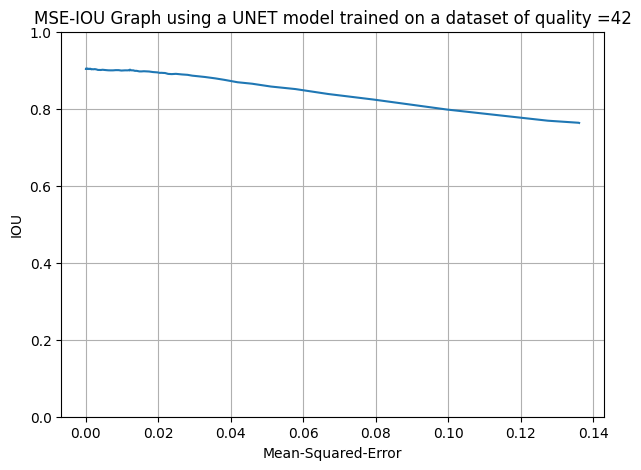

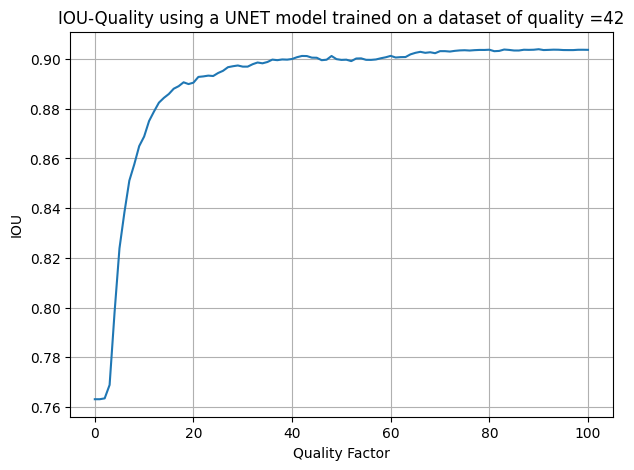

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05305, iou_score - 0.9035]
UNET model trained on dataset of quality= 42 
test on uncompressed dataset
Evaluation Loss: 0.05305028779833924
Evaluation IoU: 0.9034553649378757
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1446, iou_score - 0.7628]
Evaluation Loss: 0.144575575987498
Evaluation IoU: 0.7628322337187974
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00, 

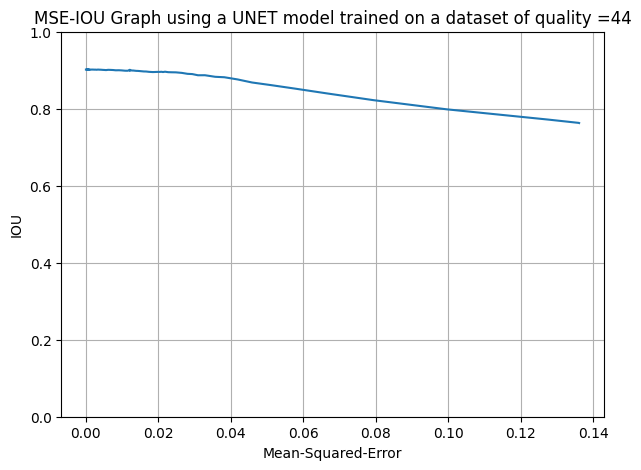

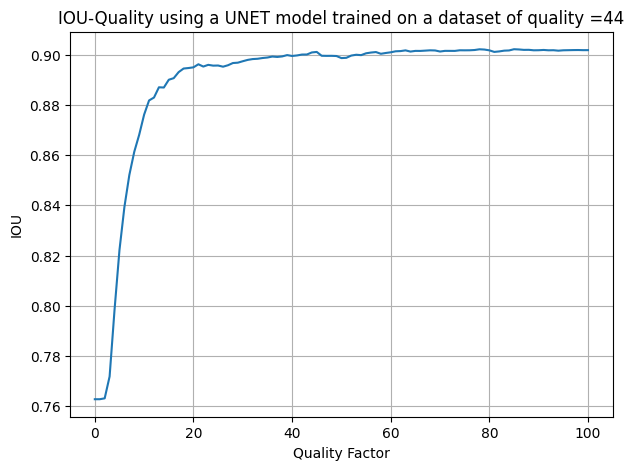

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:17<00:00,  2.89it/s, dice_loss - 0.05395, iou_score - 0.9017]
UNET model trained on dataset of quality= 44 
test on uncompressed dataset
Evaluation Loss: 0.053954872430539605
Evaluation IoU: 0.9016782536226161
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,  2.91it/s, dice_loss - 0.1441, iou_score - 0.7642]
Evaluation Loss: 0.14411434122160371
Evaluation IoU: 0.7641745040229723
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:0

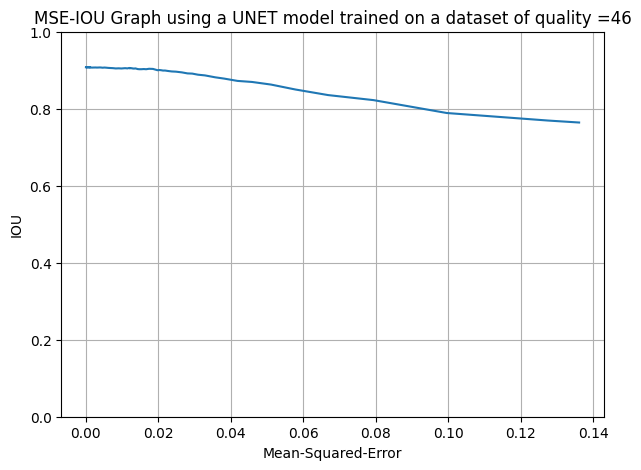

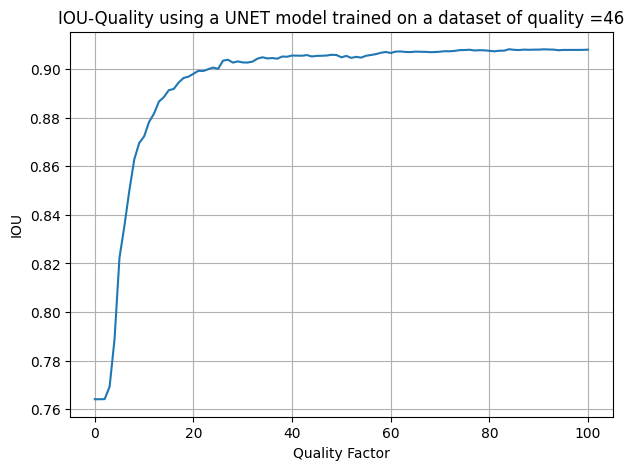

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.32it/s, dice_loss - 0.05037, iou_score - 0.9077]
UNET model trained on dataset of quality= 46 
test on uncompressed dataset
Evaluation Loss: 0.05037012637830249
Evaluation IoU: 0.9077377892008014
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.34it/s, dice_loss - 0.1473, iou_score - 0.7591]
Evaluation Loss: 0.14729455756206142
Evaluation IoU: 0.7590990650887582
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00

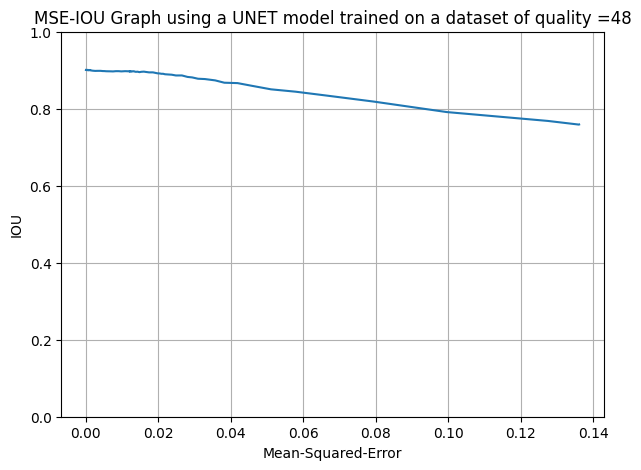

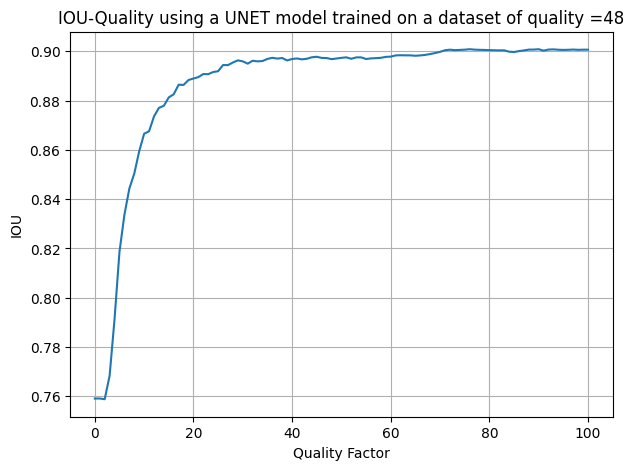

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.28it/s, dice_loss - 0.05481, iou_score - 0.9007]
UNET model trained on dataset of quality= 48 
test on uncompressed dataset
Evaluation Loss: 0.05480814915077359
Evaluation IoU: 0.9007156175725605
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00,  2.65it/s, dice_loss - 0.1436, iou_score - 0.7654]
Evaluation Loss: 0.14361629532832726
Evaluation IoU: 0.7653955869814928
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00

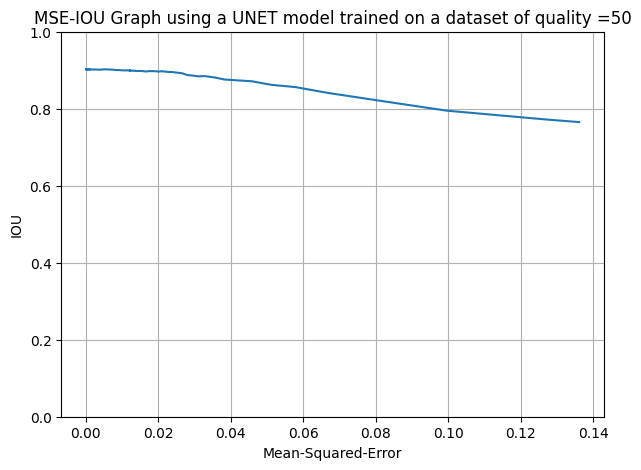

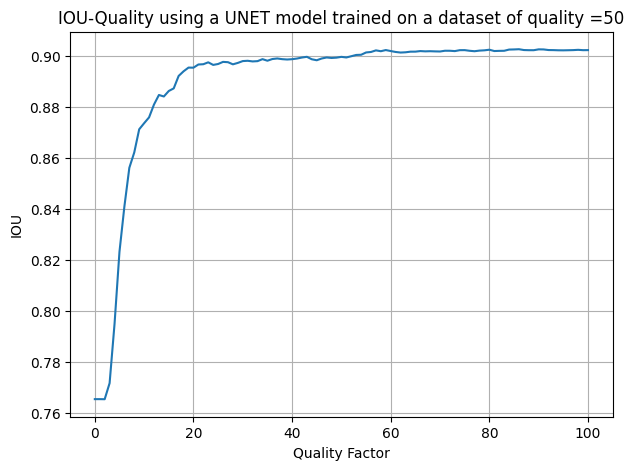

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:17<00:00,  2.85it/s, dice_loss - 0.05362, iou_score - 0.9024]
UNET model trained on dataset of quality= 50 
test on uncompressed dataset
Evaluation Loss: 0.053617014604456274
Evaluation IoU: 0.9023752656637452
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,  2.85it/s, dice_loss - 0.1439, iou_score - 0.764] 
Evaluation Loss: 0.14393872373244346
Evaluation IoU: 0.7639622063029047
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:0

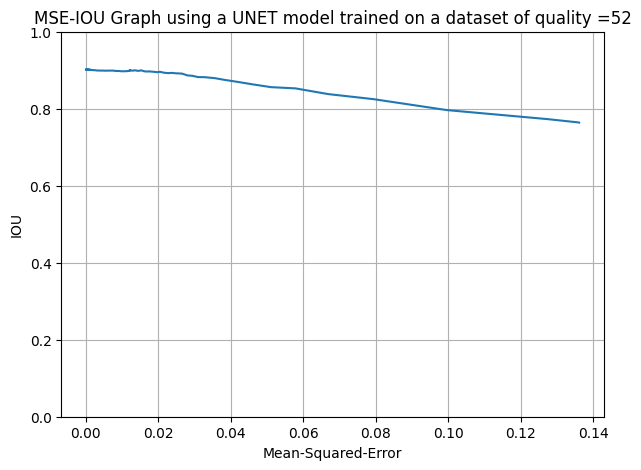

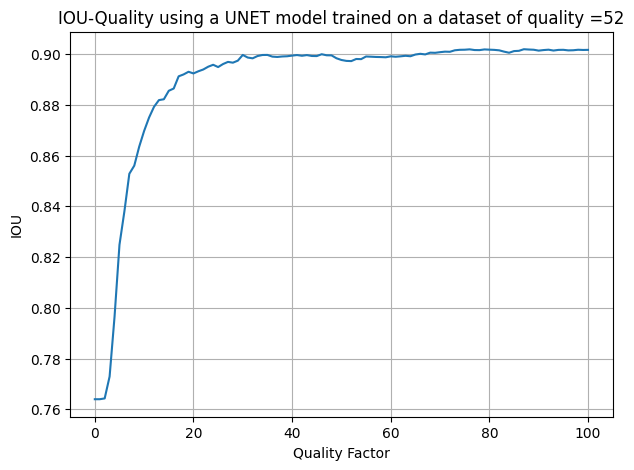

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:19<00:00,  2.62it/s, dice_loss - 0.05409, iou_score - 0.9017]
UNET model trained on dataset of quality= 52 
test on uncompressed dataset
Evaluation Loss: 0.05409105852538463
Evaluation IoU: 0.9017038532331876
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00,  2.59it/s, dice_loss - 0.1476, iou_score - 0.7589]
Evaluation Loss: 0.14759074356041704
Evaluation IoU: 0.7589126784427492
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00

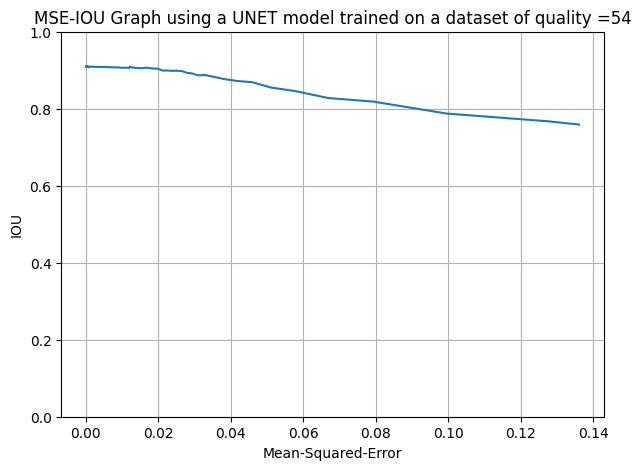

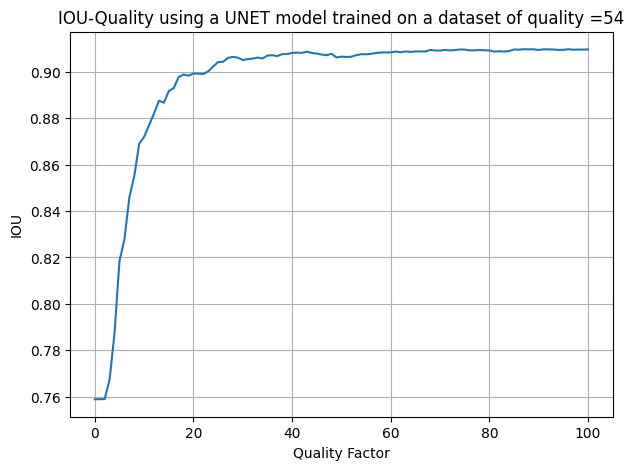

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.47it/s, dice_loss - 0.04946, iou_score - 0.9094]
UNET model trained on dataset of quality= 54 
test on uncompressed dataset
Evaluation Loss: 0.04945604941424202
Evaluation IoU: 0.909419212855545
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.1451, iou_score - 0.7628]
Evaluation Loss: 0.14514885813582176
Evaluation IoU: 0.7627666890621185
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

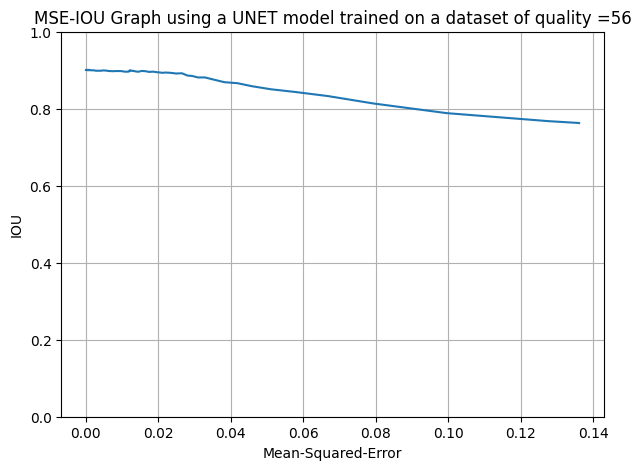

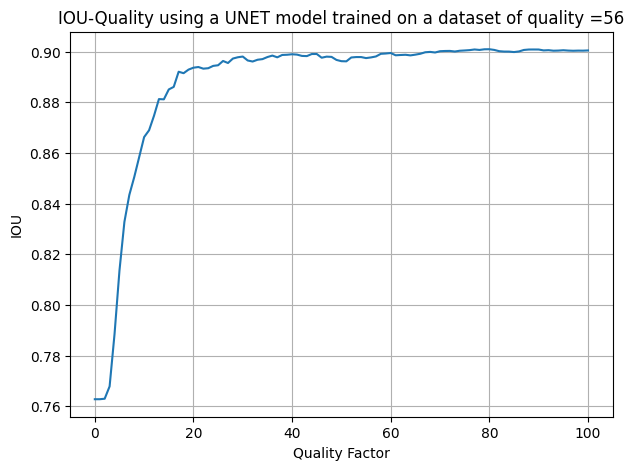

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:16<00:00,  3.09it/s, dice_loss - 0.05502, iou_score - 0.9005]
UNET model trained on dataset of quality= 56 
test on uncompressed dataset
Evaluation Loss: 0.05501643816630046
Evaluation IoU: 0.9005033549140483
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:16<00:00,  3.16it/s, dice_loss - 0.1422, iou_score - 0.7667]
Evaluation Loss: 0.14217500125660612
Evaluation IoU: 0.7666995268242033
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00

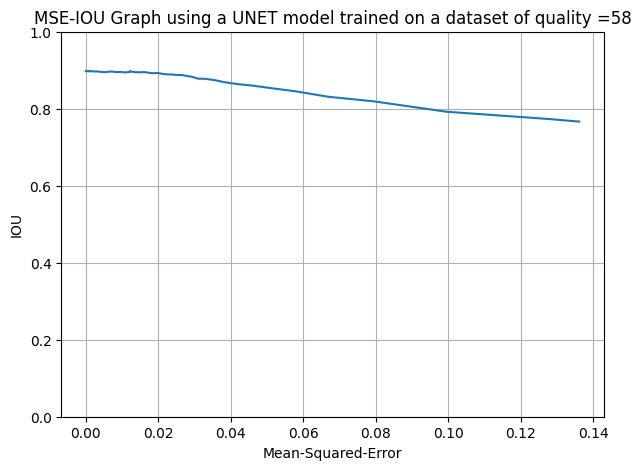

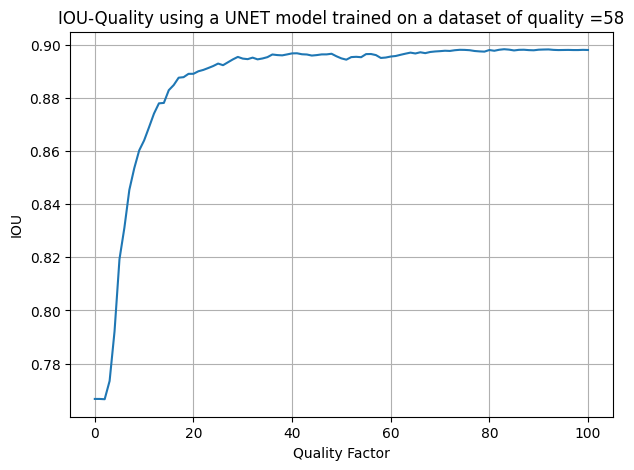

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:18<00:00,  2.79it/s, dice_loss - 0.0564, iou_score - 0.898]  
UNET model trained on dataset of quality= 58 
test on uncompressed dataset
Evaluation Loss: 0.05639772204791797
Evaluation IoU: 0.8979952417167963
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:18<00:00,  2.81it/s, dice_loss - 0.1454, iou_score - 0.7623]
Evaluation Loss: 0.1454484041999368
Evaluation IoU: 0.7623157577187408
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,

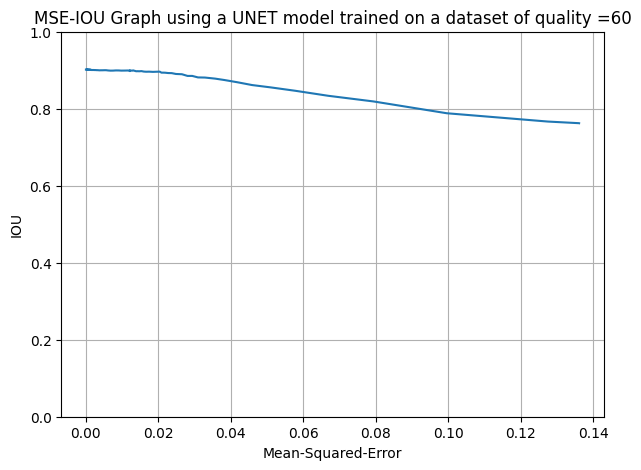

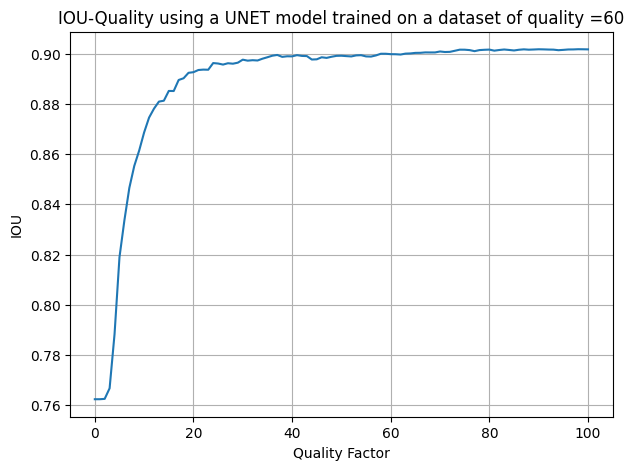

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.33it/s, dice_loss - 0.05426, iou_score - 0.9016]
UNET model trained on dataset of quality= 60 
test on uncompressed dataset
Evaluation Loss: 0.05426239733602487
Evaluation IoU: 0.9015808993694828
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.38it/s, dice_loss - 0.1492, iou_score - 0.7569]
Evaluation Loss: 0.1492374586124046
Evaluation IoU: 0.7569440024740557
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,

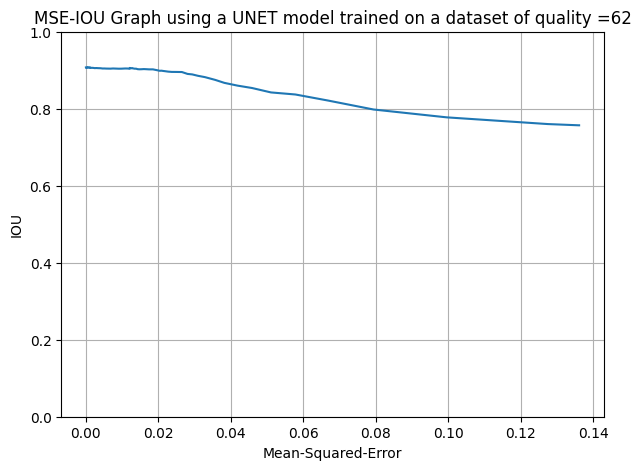

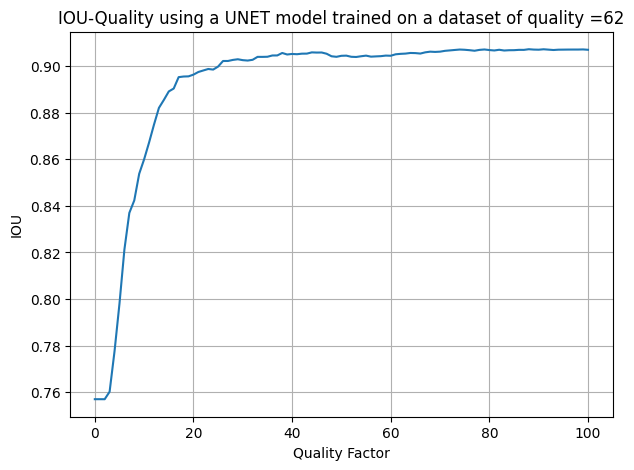

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.05102, iou_score - 0.907] 
UNET model trained on dataset of quality= 62 
test on uncompressed dataset
Evaluation Loss: 0.05101897786645328
Evaluation IoU: 0.9070355693499245
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.1435, iou_score - 0.7648]
Evaluation Loss: 0.1434795342239679
Evaluation IoU: 0.7647838534093372
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

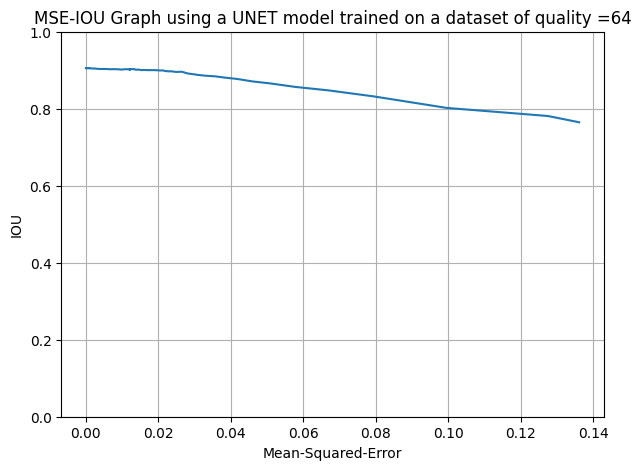

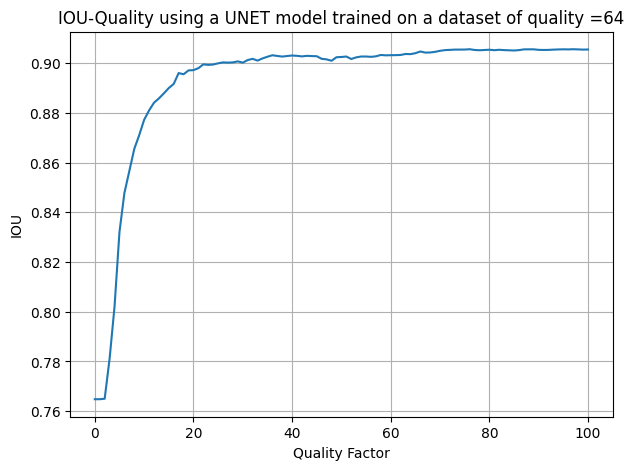

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.05168, iou_score - 0.9055]
UNET model trained on dataset of quality= 64 
test on uncompressed dataset
Evaluation Loss: 0.051684665913675355
Evaluation IoU: 0.9054896702953413
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1508, iou_score - 0.7545]
Evaluation Loss: 0.1508298165657941
Evaluation IoU: 0.7545368875942976
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

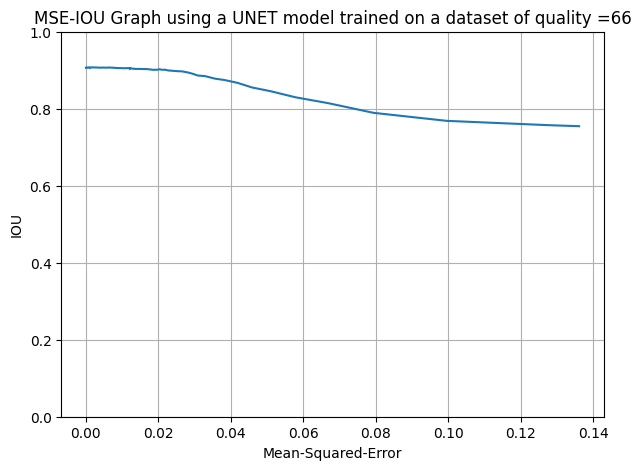

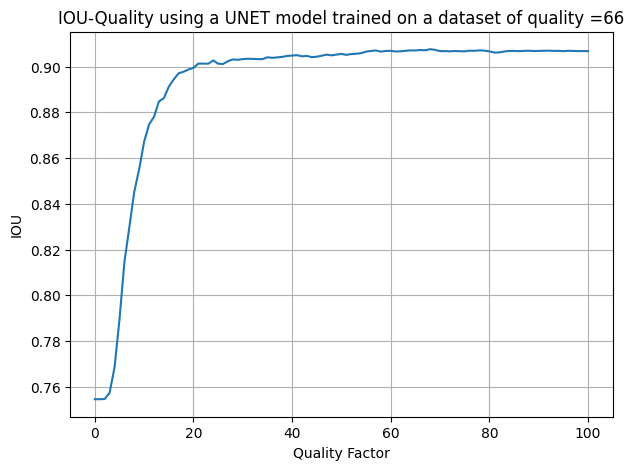

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.05123, iou_score - 0.9067]
UNET model trained on dataset of quality= 66 
test on uncompressed dataset
Evaluation Loss: 0.051230278669619086
Evaluation IoU: 0.9066613678838692
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.1351, iou_score - 0.7767]
Evaluation Loss: 0.13510919435351504
Evaluation IoU: 0.7767069532590752
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

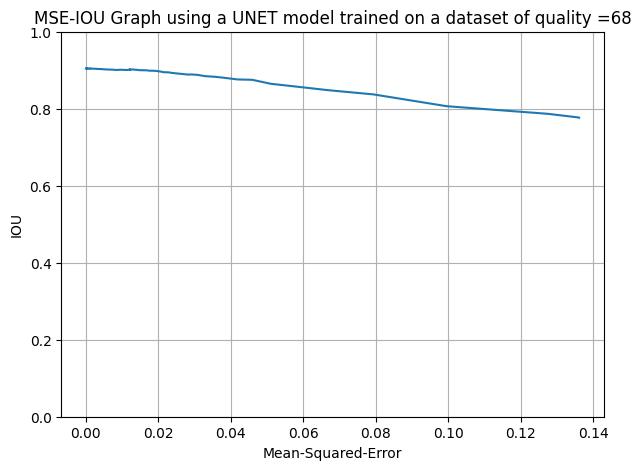

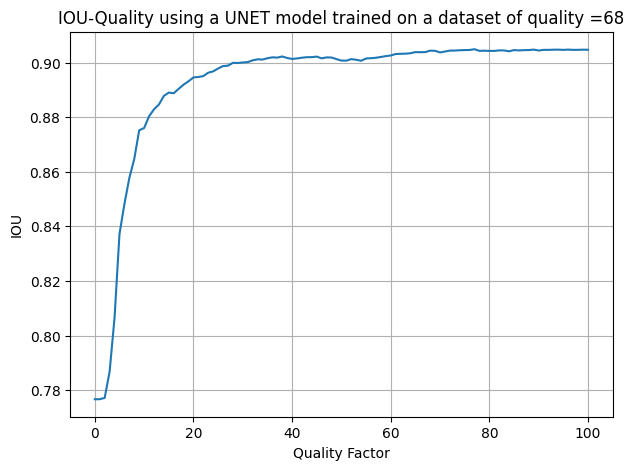

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.50it/s, dice_loss - 0.05241, iou_score - 0.9045]
UNET model trained on dataset of quality= 68 
test on uncompressed dataset
Evaluation Loss: 0.05240737106285843
Evaluation IoU: 0.9045337684014265
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1425, iou_score - 0.7661]
Evaluation Loss: 0.14254383246103927
Evaluation IoU: 0.7660572382749294
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

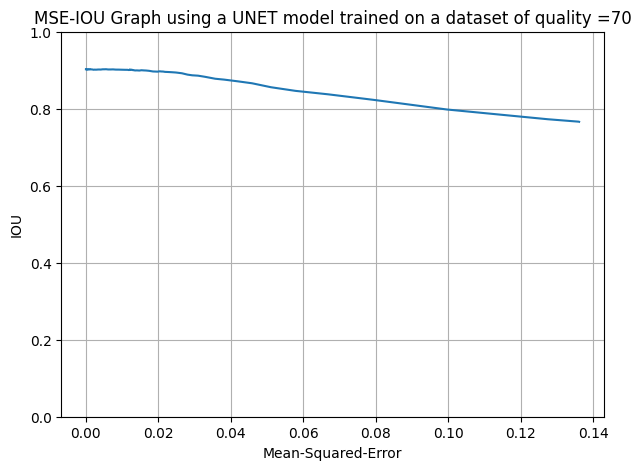

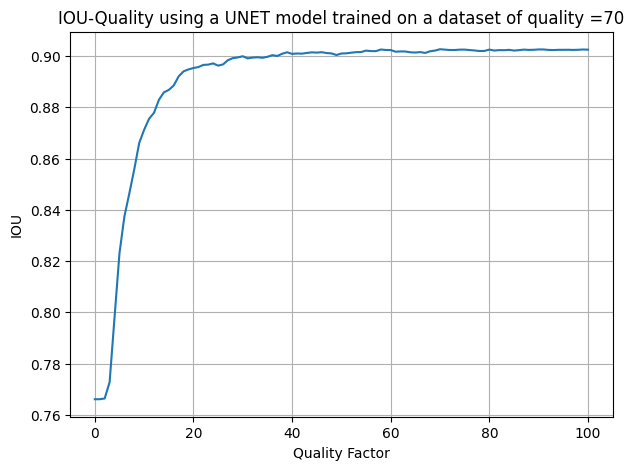

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.51it/s, dice_loss - 0.05373, iou_score - 0.9026]
UNET model trained on dataset of quality= 70 
test on uncompressed dataset
Evaluation Loss: 0.05373419967352177
Evaluation IoU: 0.9025671774265811
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1451, iou_score - 0.763] 
Evaluation Loss: 0.14505350589752197
Evaluation IoU: 0.763048700842203
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

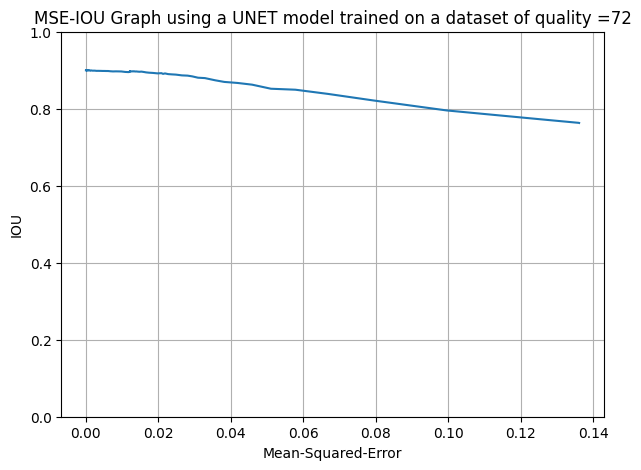

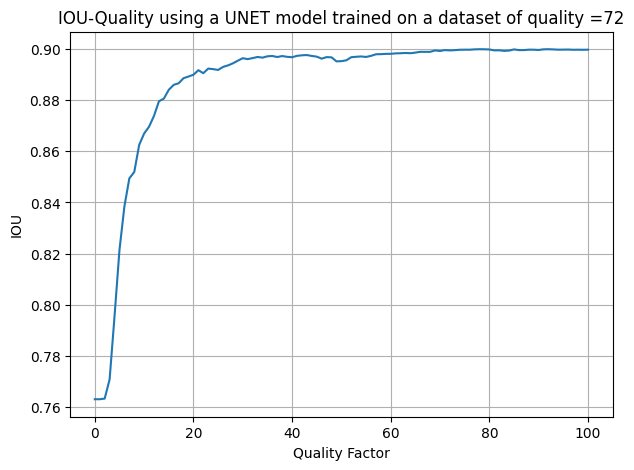

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.05545, iou_score - 0.8997]
UNET model trained on dataset of quality= 72 
test on uncompressed dataset
Evaluation Loss: 0.05544823174383126
Evaluation IoU: 0.8996609274078821
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.146, iou_score - 0.761]  
Evaluation Loss: 0.14602670833176257
Evaluation IoU: 0.7610040096675649
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

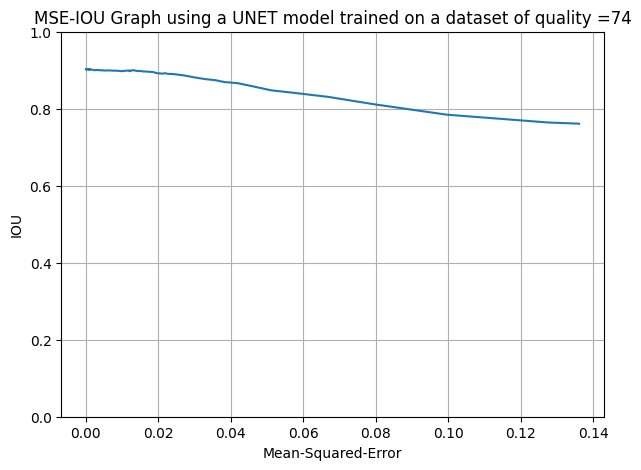

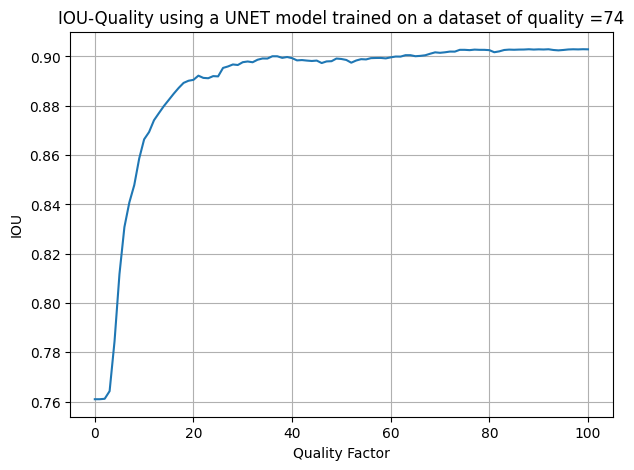

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05344, iou_score - 0.9026]
UNET model trained on dataset of quality= 74 
test on uncompressed dataset
Evaluation Loss: 0.05343776240068323
Evaluation IoU: 0.9026069582677356
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1438, iou_score - 0.7647]
Evaluation Loss: 0.14383054831448727
Evaluation IoU: 0.7646512546960047
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

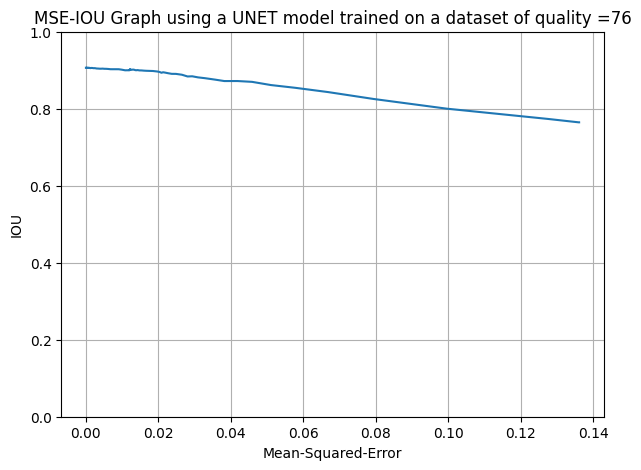

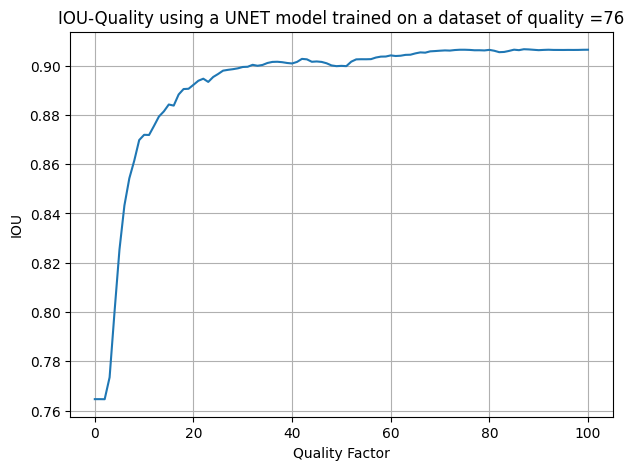

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.05318, iou_score - 0.9064]
UNET model trained on dataset of quality= 76 
test on uncompressed dataset
Evaluation Loss: 0.05318206081203386
Evaluation IoU: 0.9064389268557231
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1375, iou_score - 0.7732]
Evaluation Loss: 0.1375454465548198
Evaluation IoU: 0.773176401269202
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00, 

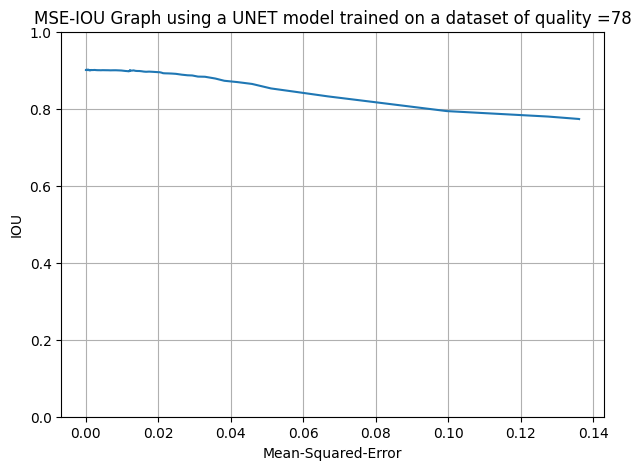

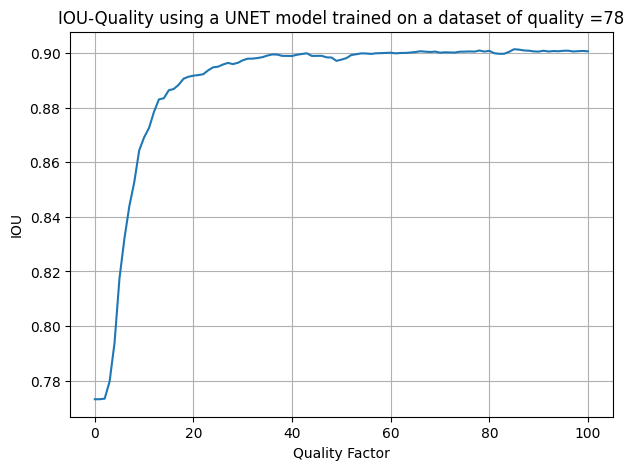

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.05491, iou_score - 0.9006]
UNET model trained on dataset of quality= 78 
test on uncompressed dataset
Evaluation Loss: 0.0549061333431917
Evaluation IoU: 0.9005831772205877
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1415, iou_score - 0.7675]
Evaluation Loss: 0.14150426434535604
Evaluation IoU: 0.7675438470700209
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

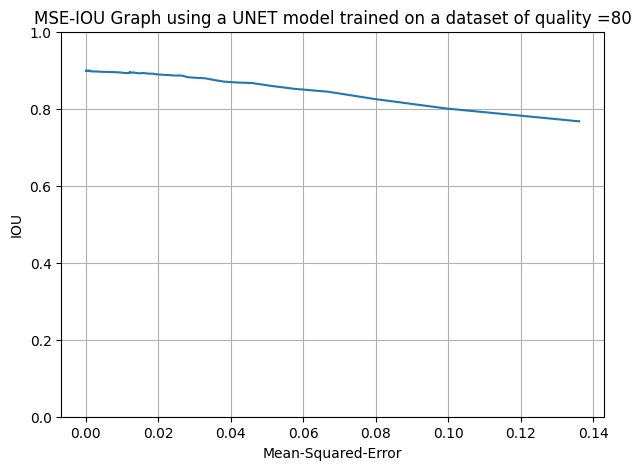

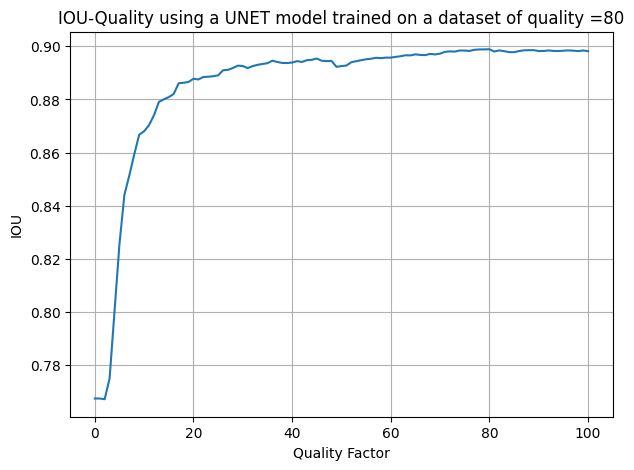

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.51it/s, dice_loss - 0.05596, iou_score - 0.8984]
UNET model trained on dataset of quality= 80 
test on uncompressed dataset
Evaluation Loss: 0.055963889056561036
Evaluation IoU: 0.8984245073561573
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1438, iou_score - 0.7649]
Evaluation Loss: 0.14378474974164776
Evaluation IoU: 0.7648754312711603
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

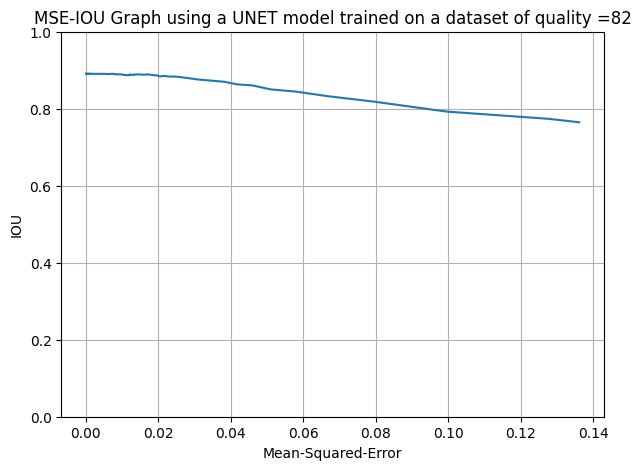

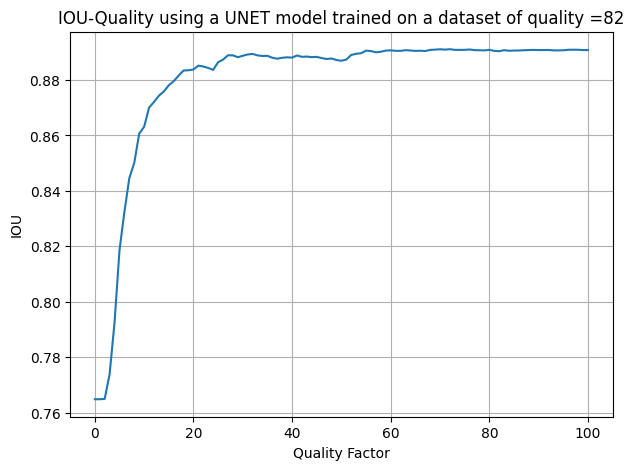

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.51it/s, dice_loss - 0.06081, iou_score - 0.8908]
UNET model trained on dataset of quality= 82 
test on uncompressed dataset
Evaluation Loss: 0.06081216008055444
Evaluation IoU: 0.8908108916937136
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1441, iou_score - 0.7641]
Evaluation Loss: 0.1440987364918578
Evaluation IoU: 0.7641267151224848
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

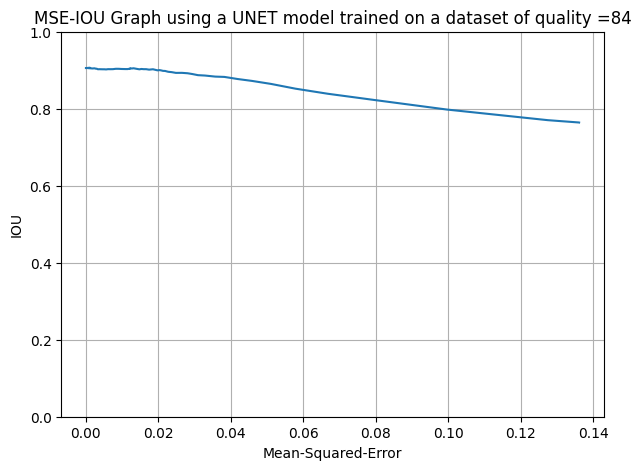

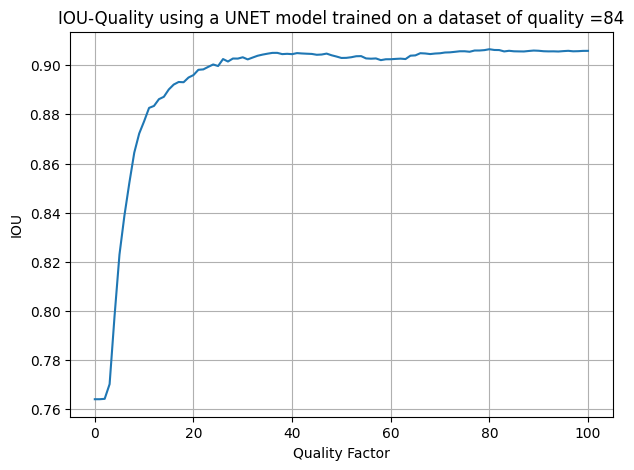

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.05163, iou_score - 0.9057]
UNET model trained on dataset of quality= 84 
test on uncompressed dataset
Evaluation Loss: 0.051625867684682206
Evaluation IoU: 0.9057059849009794
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1422, iou_score - 0.7666]
Evaluation Loss: 0.14223076198615278
Evaluation IoU: 0.7665828676784741
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

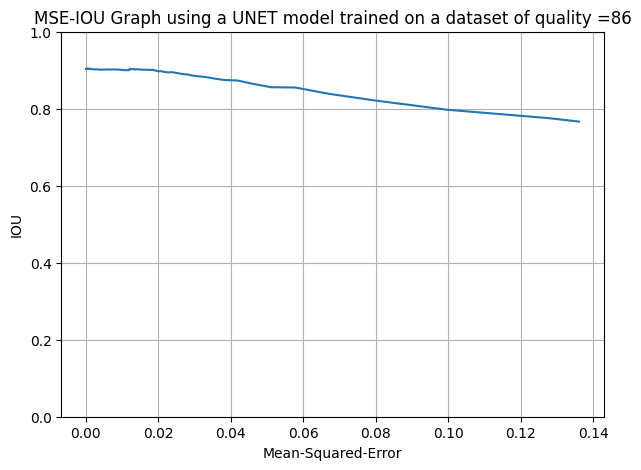

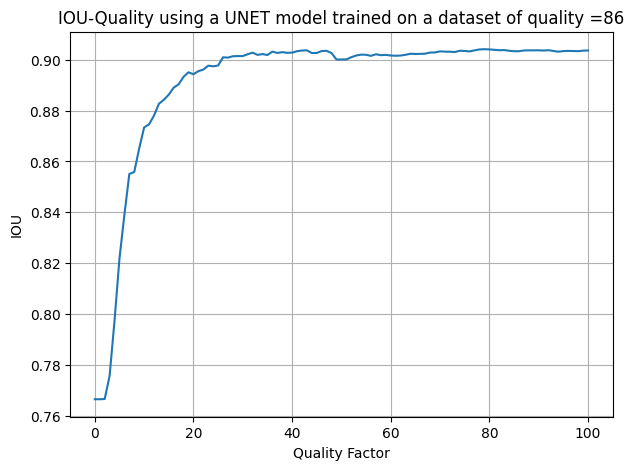

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.05293, iou_score - 0.9034]
UNET model trained on dataset of quality= 86 
test on uncompressed dataset
Evaluation Loss: 0.05292601211398255
Evaluation IoU: 0.9034075211076174
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.1453, iou_score - 0.7624]
Evaluation Loss: 0.14528070711622054
Evaluation IoU: 0.7623858831676783
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

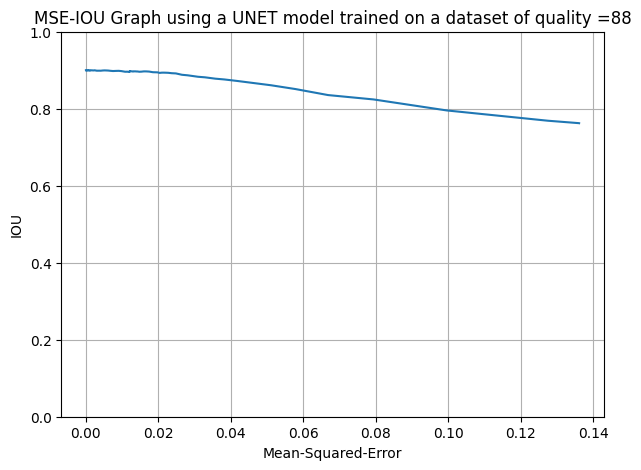

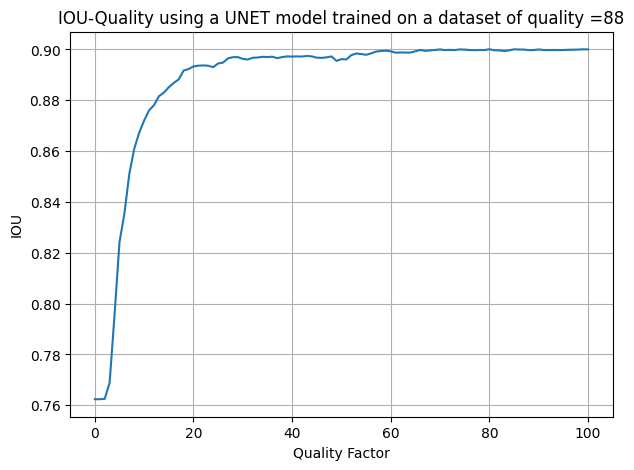

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.54it/s, dice_loss - 0.05501, iou_score - 0.9]   
UNET model trained on dataset of quality= 88 
test on uncompressed dataset
Evaluation Loss: 0.05500991087333827
Evaluation IoU: 0.899950407299341
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1485, iou_score - 0.7578]
Evaluation Loss: 0.14847591344047997
Evaluation IoU: 0.7577947197007199
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

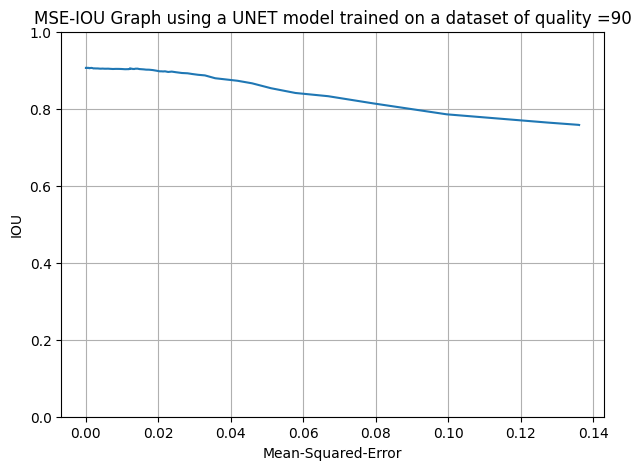

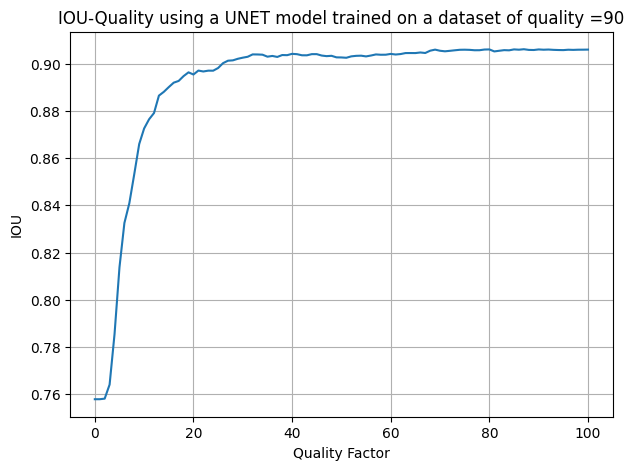

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.48it/s, dice_loss - 0.05124, iou_score - 0.906] 
UNET model trained on dataset of quality= 90 
test on uncompressed dataset
Evaluation Loss: 0.0512350411976085
Evaluation IoU: 0.9060406754998599
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.1454, iou_score - 0.7623]
Evaluation Loss: 0.14535893645941045
Evaluation IoU: 0.7623011697741116
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

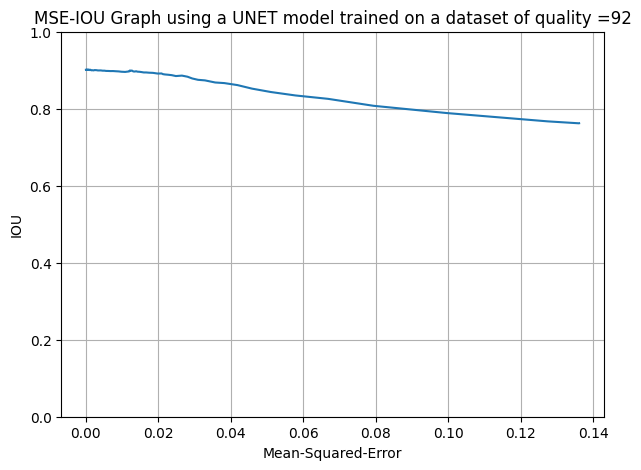

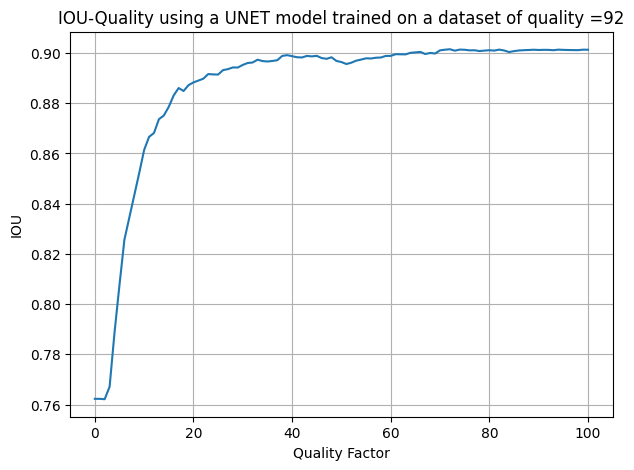

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.22it/s, dice_loss - 0.05542, iou_score - 0.9012]
UNET model trained on dataset of quality= 92 
test on uncompressed dataset
Evaluation Loss: 0.05542287990158679
Evaluation IoU: 0.9012392899569345
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.27it/s, dice_loss - 0.1462, iou_score - 0.761] 
Evaluation Loss: 0.14619096821429683
Evaluation IoU: 0.7610499175155864
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00

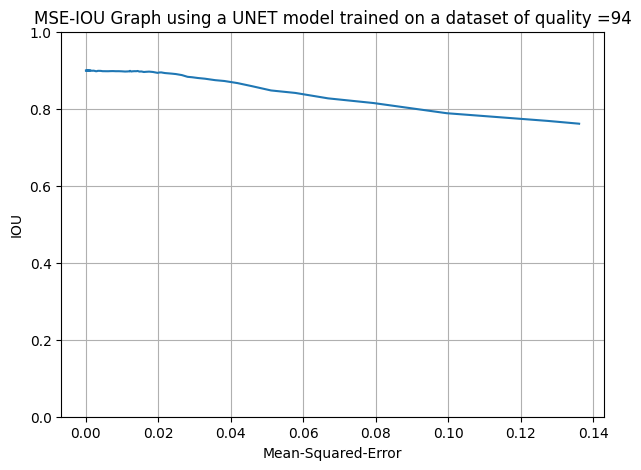

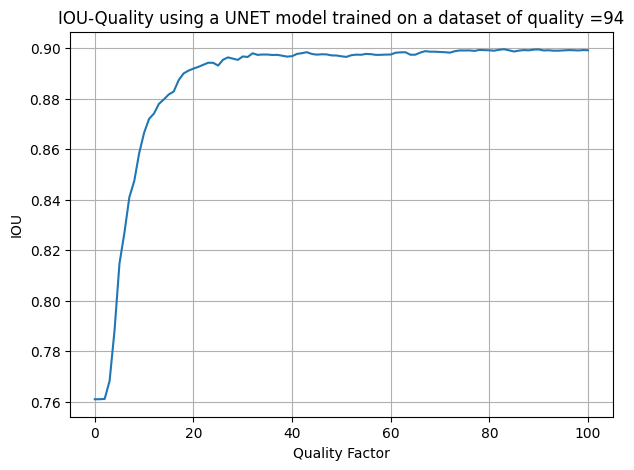

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.50it/s, dice_loss - 0.05583, iou_score - 0.8991]
UNET model trained on dataset of quality= 94 
test on uncompressed dataset
Evaluation Loss: 0.05582993988897288
Evaluation IoU: 0.8991376839432064
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1479, iou_score - 0.7588]
Evaluation Loss: 0.14786669904110478
Evaluation IoU: 0.7588202474164026
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

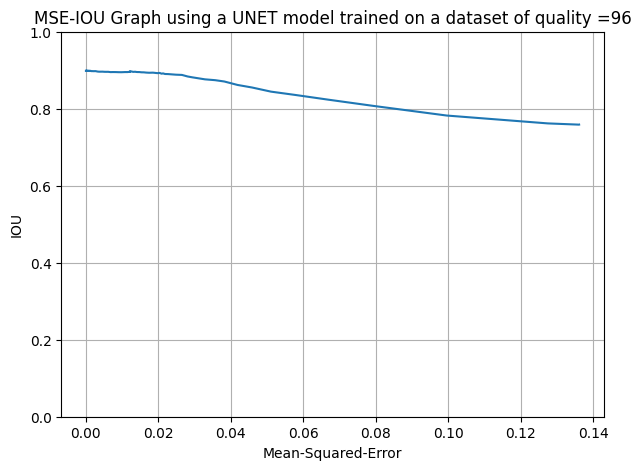

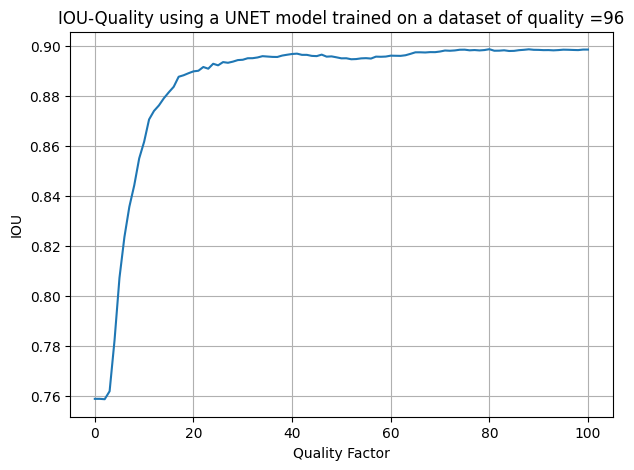

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.48it/s, dice_loss - 0.056, iou_score - 0.8986]  
UNET model trained on dataset of quality= 96 
test on uncompressed dataset
Evaluation Loss: 0.05600388260448679
Evaluation IoU: 0.8986253761777692
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.1411, iou_score - 0.7689]
Evaluation Loss: 0.14108351866404215
Evaluation IoU: 0.768879199144887
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,

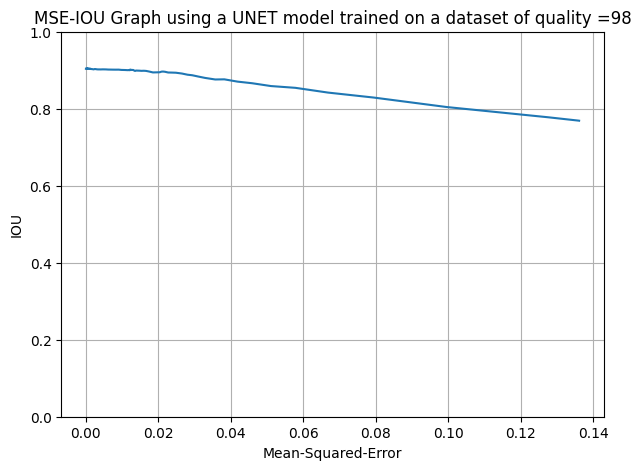

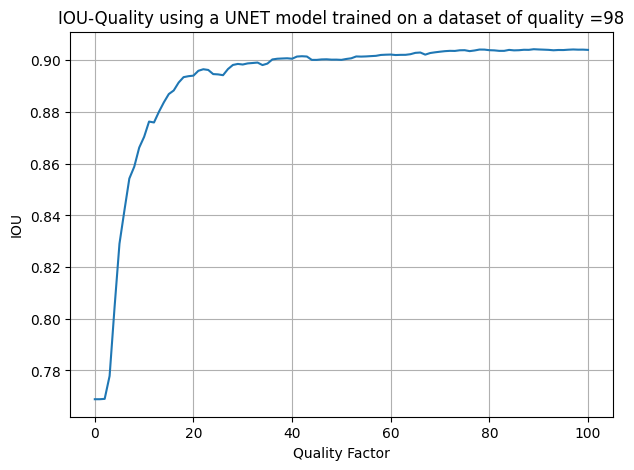

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.53it/s, dice_loss - 0.05293, iou_score - 0.9039]
UNET model trained on dataset of quality= 98 
test on uncompressed dataset
Evaluation Loss: 0.05293092657538021
Evaluation IoU: 0.9039348504122564
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.58it/s, dice_loss - 0.1486, iou_score - 0.7576]
Evaluation Loss: 0.14861685271356626
Evaluation IoU: 0.7576062463077844
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00

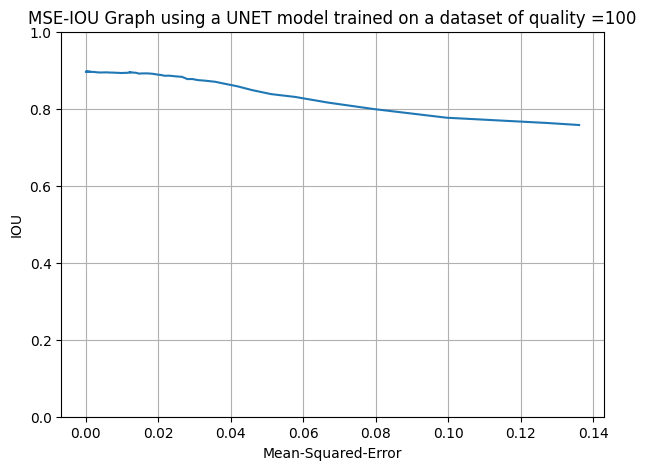

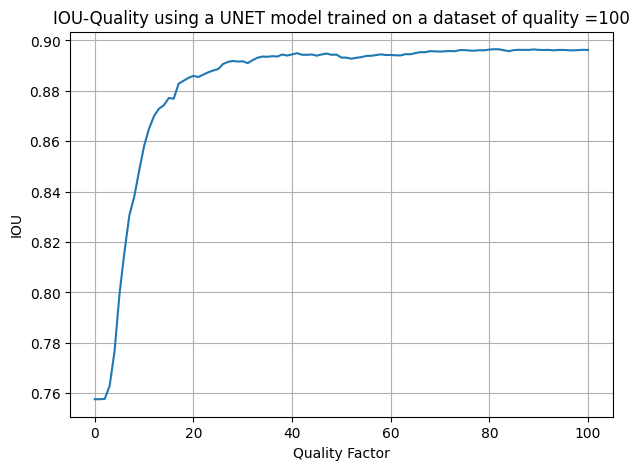

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.52it/s, dice_loss - 0.05721, iou_score - 0.8962]
UNET model trained on dataset of quality= 100 
test on uncompressed dataset
Evaluation Loss: 0.05720723142810897
Evaluation IoU: 0.8962427646506068
[0.8736871001767181, 0.8983676468624789, 0.8974945954248017, 0.9043271822087906, 0.9011958755698857, 0.8981674640786413, 0.9014403364237615, 0.8736871001767181, 0.8983676468624789, 0.8974945954248017, 0.9043271822087906, 0.9011958755698857, 0.8981674640786413, 0.9014403364237615, 0.9000985365287929, 0.9028996310982048, 0.8932734342182385, 0.898876548982134, 0.9040203924272576, 0.8983956084531897, 0.8994515842082453, 0.9043489332292592, 0.9005005020721285, 0.898041508945764, 0.8996372117715721, 0.9030175910276523, 0.9003541598133015, 0.9042480587959291, 0.9034553649378757, 0.9016782536226161, 0.9077377892008014, 0.90071

In [20]:
test_UNET()

**Analysis and Evaluation**

In [25]:
UNET_uncomp_res = [0.8736871001767181, 0.8983676468624789, 0.8974945954248017, 0.9043271822087906, 0.9011958755698857, 0.8981674640786413, 0.9014403364237615, 0.9000985365287929, 0.9028996310982048, 0.8932734342182385, 0.898876548982134, 0.9040203924272576, 0.8983956084531897, 0.8994515842082453, 0.9043489332292592, 0.9005005020721285, 0.898041508945764, 0.8996372117715721, 0.9030175910276523, 0.9003541598133015, 0.9042480587959291, 0.9034553649378757, 0.9016782536226161, 0.9077377892008014, 0.9007156175725605, 0.9023752656637452, 0.9017038532331876, 0.909419212855545, 0.9005033549140483, 0.8979952417167963, 0.9015808993694828, 0.9070355693499245, 0.9054896702953413, 0.9066613678838692, 0.9045337684014265, 0.9025671774265811, 0.8996609274078821,0.9026069582677356, 0.9064389268557231, 0.9005831772205877, 0.8984245073561573, 0.8908108916937136, 0.9057059849009794, 0.9034075211076174, 0.899950407299341, 0.9060406754998599, 0.9012392899569345, 0.8991376839432064, 0.8986253761777692, 0.9039348504122564, 0.8962427646506068]
print(len(UNET_uncomp_res))

58


Deeplabv3+ Training

In [ ]:
def DLV3P_training_loop():
    DLV3P_directory = "{}{}{}{}".format("models",os.sep,"best_models_DLV3P",os.sep)
    os.makedirs(DLV3P_directory, exist_ok=True)
    for q in range (0, 101, step_size):
        model_DLV3P = smp.DeepLabV3Plus(encoder_name=ENCODER, encoder_weights=ENCODER_WEIGHTS, classes=len(CLASSES), activation=ACTIVATION)
        # datasets for training
        training_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Train",os.sep)
        training_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Trainannot",os.sep)

        val_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validation",os.sep)
        val_masks_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Validationannot",os.sep)
        labels_directory = "{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"label_colors.txt")
        # Create a training dataset using images from X_TRAIN_DIR and masks from Y_TRAIN_DIR.
        # Add augmentations defined by get_training_augmentation() and apply preprocessing defined by get_preprocessing(preprocessing_fn).
        training_dataset = Excavators(
            training_data_directory, 
            training_masks_directory, 
            labels_directory,
            augmentation=get_training_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # Create a validation dataset using images from X_VALID_DIR and masks from Y_VALID_DIR.
        # Add validation augmentations defined by get_validation_augmentation() and apply the same preprocessing function as the training dataset.
        valid_dataset = Excavators(
            val_data_directory, 
            val_masks_directory, 
            labels_directory,
            augmentation=get_validation_augmentation(), 
            preprocessing=get_preprocessing(preprocessing_fn)
        )

        # create training and validation dataloaders
        train_loader = DataLoader(training_dataset, batch_size=batch_size, shuffle=True)
        val_loader = DataLoader(valid_dataset, batch_size= 1, shuffle=False)
        
        # Define the criterion, metric and optimizer for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()]
        optimizer_DLV3P = torch.optim.Adam([ 
            dict(params=model_DLV3P.parameters(), lr=lr),  # Use Adam optimizer with initial learning rate INIT_LR
        ])

        # define train and valid epoch for 1 model
        train_epoch = utils.train.TrainEpoch(
            model_DLV3P,                    # Model to be trained
            loss= criterion,                # Loss function to compute during training
            metrics=metric,          # Metrics to compute during training (e.g., F-score, IoU)
            optimizer=optimizer_DLV3P,      # Optimizer used to update model parameters
            device=DEVICE,            # Device (CPU or GPU) where the training takes place
            verbose=True,             # Print training progress (verbose mode)
        )

        # Create an epoch runner for validation.
        # This object encapsulates the validation loop over the samples in the dataloader.
        valid_epoch = utils.train.ValidEpoch(
            model_DLV3P,                    # Model to be evaluated
            loss= criterion,                # Loss function to compute during validation
            metrics= metric,          # Metrics to compute during validation
            device=DEVICE,            # Device (CPU or GPU) where the validation takes place
            verbose=True,             # Print validation progress (verbose mode)
        )

        # train and define save directories for one model
        DLV3P_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3P",os.sep,q,".pth")
        DLV3P_jit_save_dir = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3P",os.sep,q,".pt")  
        loss_logs_DLV3P, metric_logs_DLV3P = training_loop(model_DLV3P, optimizer_DLV3P, train_loader,val_loader, train_epoch, valid_epoch, DLV3P_save_dir, DLV3P_jit_save_dir)
        # Plotting training and validation losses and metrics
        fig, axes = plt.subplots(1, 2, figsize=(10,4))
        axes[0].plot(loss_logs_DLV3P["train"], label = "train")
        axes[0].plot(loss_logs_DLV3P["val"], label = "val")
        axes[0].set_title(f"losses - Dice")

        axes[1].plot(metric_logs_DLV3P["train"], label = "train")
        axes[1].plot(metric_logs_DLV3P["val"], label = "val")
        axes[1].set_title(f"IOU")

        # Adding a main title for both plots
        plt.suptitle(f"DLV3P model trained on quality = {q} ", fontsize=16)

        # Adjusting layout to make room for the main title
        plt.tight_layout(rect=[0, 0, 1, 0.95])

        # [ax.legend() for ax in axes]

In [ ]:
DLV3P_training_loop()

In [23]:
# Unzip trained models folder 
zip_path = "{}{}{}".format( "models", os.sep, "best_models_DLV3P.zip")
extract_path = "{}{}{}".format( "models", os.sep,"best_models_DLV3P")
# Create the extraction directory if it doesn't exist
os.makedirs(extract_path, exist_ok=True)

# Open the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    # Extract all contents
    zip_ref.extractall(extract_path)

print(f"Extracted to {extract_path}")

Extracted to models\best_models_DLV3P


In [29]:
models_path = "{}{}{}{}".format("models",os.sep,"best_models_DLV3P",os.sep)
files = os.listdir(models_path)
pth_files = [file for file in files if file.endswith('.pth')]
print(len(pth_files))
DLV3P_uncomp_res = []
# Sort by the numeric part of the filename
pth_files_sorted = sorted(pth_files, key=lambda x: int(x.split('.')[0]))
print(pth_files_sorted)
def test_DLV3P():
    save_dir_MSE = "{}{}{}{}{}".format("Results",os.sep,"DLV3P",os.sep,"MSE_IOU")
    save_dir_Q = "{}{}{}{}{}".format("Results",os.sep,"DLV3P",os.sep,"Q_IOU")
    os.makedirs(save_dir_MSE, exist_ok=True)
    os.makedirs(save_dir_Q, exist_ok=True)
    for file in pth_files_sorted:
        number = file.split('.')[0]
        q = int(number)
        # load best instance of model
        model_path = "{}{}{}{}{}{}".format("models",os.sep,"best_models_DLV3P",os.sep,q,".pth")
        model_DLV3P = torch.load(model_path)
        model_DLV3P.eval()

        # Define the criterion and metric for training the model.
        criterion = utils.losses.DiceLoss()
        metric = [utils.metrics.IoU()] 

        # define evaluation epochs
        eval_epoch_DLV3P = utils.train.ValidEpoch(
            model=model_DLV3P,            # Model to be evaluated
            loss=criterion,         # Loss function
            metrics=metric,        # List of metrics
            device=DEVICE,          # Device (CPU or GPU)
            verbose=True            # Print evaluation progress
        )

        base_test_dir = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"TestCompressed",os.sep)
        cor_mse_DLV3P = {} # quality:MSE dictionary
        IOU_scores_DLV3P ={} # quality: IOU dictionary
        for i in range(0, 101, 1):
            comp_test_dir = os.path.join(base_test_dir,str(i))
            print(comp_test_dir)
            # create test dataset
            comp_test_dataset = Excavators(
                comp_test_dir,  # Directory containing test images
                test_masks_directory,  # Directory containing test masks
                labels_directory,
                augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
                preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
                )
            mse_values =[]
            for j in range(len(comp_test_dataset)):
                comp_image,_ = comp_test_dataset[j]
                original_image, _ = test_dataset[j]
                mse = calculate_mse(original_image, comp_image)
                mse_values.append(mse)
            cor_mse_DLV3P[i] = calc_avg_mse(mse_values)
            print('MSE: ', cor_mse_DLV3P[i])

            

            test_loader = DataLoader(comp_test_dataset)
            eval_logs = eval_epoch_DLV3P.run(test_loader)
            eval_loss, eval_metric_IOU = list(eval_logs.values())
            IOU_scores_DLV3P[i] = eval_metric_IOU

            # Print evaluation results
            print(f"Evaluation Loss: {eval_loss}")
            print(f"Evaluation IoU: {eval_metric_IOU}")  

        mse_iou_dictionary_DLV3P = {value: IOU_scores_DLV3P[key] for key, value in cor_mse_DLV3P.items()}
        # Sort the dictionary by its keys (x values) in ascending order
        sorted_mse_iou_dict_DLV3P = {k: v for k, v in sorted(mse_iou_dictionary_DLV3P.items())}

        # create a graph
        x1 = list(sorted_mse_iou_dict_DLV3P.keys()) # MSE VALUES
        y1 = list(sorted_mse_iou_dict_DLV3P.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.ylim(0, 1)
        plt.plot(x1, y1)  # Plot with markers
        plt.xlabel('Mean-Squared-Error')  # Label for X-axis
        plt.ylabel('IOU')  # Label for Y-axis
        plt.title(f'MSE-IOU Graph using a DLV3P model trained on a dataset of quality ={q}')  # Title of the graph
        plt.grid(True)  # Show grid
        plt.savefig(os.path.join(save_dir_MSE, f'{q}.png'))
        plt.show() 

        # plot quality over IOU
        x2 = list(IOU_scores_DLV3P.keys()) # quality VALUES
        y2 = list(IOU_scores_DLV3P.values()) # IOU VALUES
        plt.figure(figsize=(7, 5)) # Set the figure size
        plt.plot(x2, y2)  
        plt.xlabel('Quality Factor')
        plt.ylabel('IOU')
        plt.title(f'IOU-Quality using a DLV3P model trained on a dataset of quality ={q}')
        plt.grid(True)
        plt.savefig(os.path.join(save_dir_Q, f'{q}.png'))
        plt.show()

        # Test on normal dataset
        test_data_directory = "{}{}{}{}{}{}".format("excavator_dataset_w_masks2",os.sep,"dataset",os.sep,"Test",os.sep)
        normal_test_dataset = Excavators(
            test_data_directory,  # Directory containing test images
            test_masks_directory,  # Directory containing test masks
            labels_directory,
            augmentation=get_validation_augmentation(),  # Apply validation-specific augmentations
            preprocessing=get_preprocessing(preprocessing_fn)  # Preprocessing function for normalization
            )
        normal_test_loader = DataLoader(normal_test_dataset)
        eval_logs = eval_epoch_DLV3P.run(normal_test_loader)
        eval_loss_DLV3P, eval_metric_IOU_DLV3P = list(eval_logs.values())

        # Print evaluation results
        print(f"DLV3P model trained on dataset of quality= {q} \ntest on uncompressed dataset")
        print(f"Evaluation Loss: {eval_loss_DLV3P}")
        print(f"Evaluation IoU: {eval_metric_IOU_DLV3P}")

51
['0.pth', '2.pth', '4.pth', '6.pth', '8.pth', '10.pth', '12.pth', '14.pth', '16.pth', '18.pth', '20.pth', '22.pth', '24.pth', '26.pth', '28.pth', '30.pth', '32.pth', '34.pth', '36.pth', '38.pth', '40.pth', '42.pth', '44.pth', '46.pth', '48.pth', '50.pth', '52.pth', '54.pth', '56.pth', '58.pth', '60.pth', '62.pth', '64.pth', '66.pth', '68.pth', '70.pth', '72.pth', '74.pth', '76.pth', '78.pth', '80.pth', '82.pth', '84.pth', '86.pth', '88.pth', '90.pth', '92.pth', '94.pth', '96.pth', '98.pth', '100.pth']


excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.1563, iou_score - 0.7478]
Evaluation Loss: 0.15634308024948723
Evaluation IoU: 0.7477892403509104
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.1563, iou_score - 0.7478]
Evaluation Loss: 0.15634308024948723
Evaluation IoU: 0.7477892403509104
excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\2
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.135991
valid: 100%|██████████| 51/51 [00:13<00:

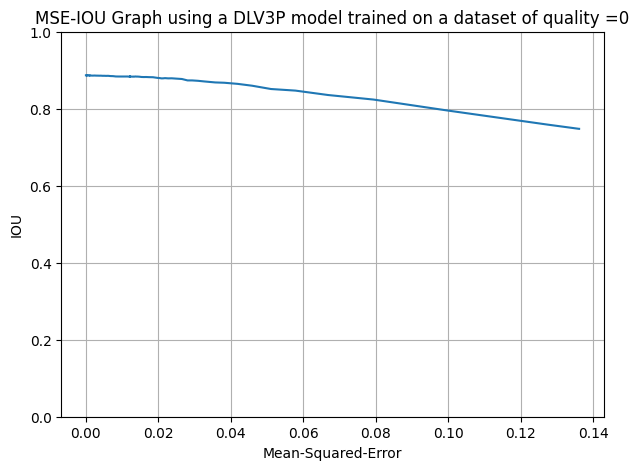

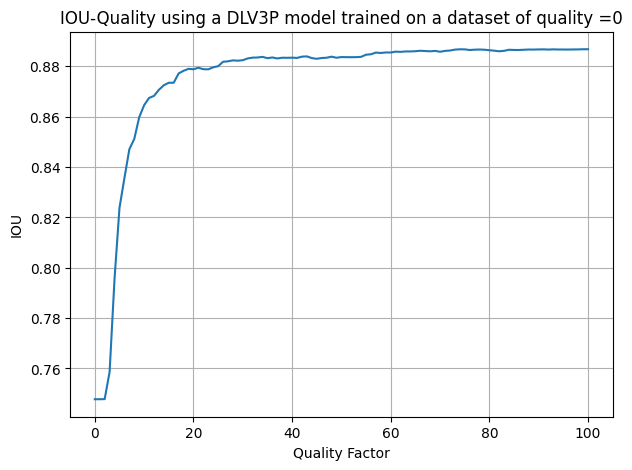

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.06325, iou_score - 0.8868]
DLV3P model trained on dataset of quality= 0 
test on uncompressed dataset
Evaluation Loss: 0.06325480634090946
Evaluation IoU: 0.88679812001247
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.1456, iou_score - 0.7621]
Evaluation Loss: 0.14555831633362123
Evaluation IoU: 0.7621409957315408
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00, 

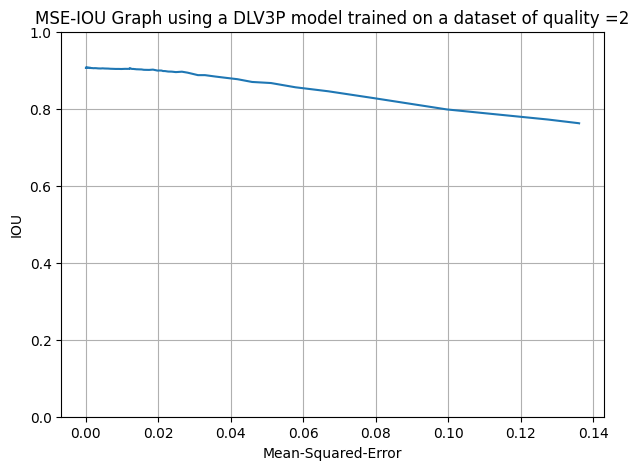

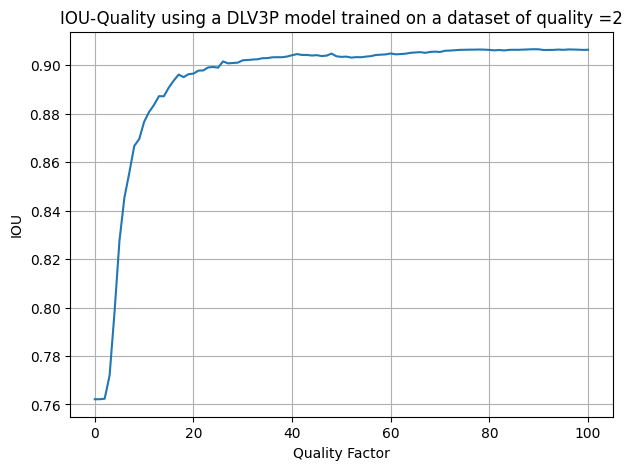

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.63it/s, dice_loss - 0.05144, iou_score - 0.9064]
DLV3P model trained on dataset of quality= 2 
test on uncompressed dataset
Evaluation Loss: 0.0514391438633788
Evaluation IoU: 0.906424387997272
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.1445, iou_score - 0.7637]
Evaluation Loss: 0.14446929155611526
Evaluation IoU: 0.7636590851288216
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00, 

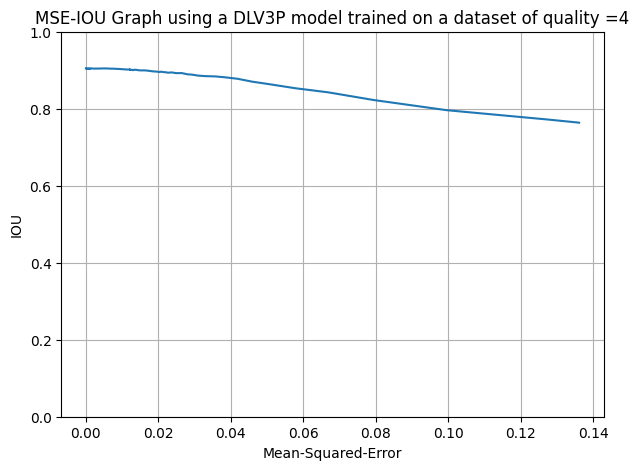

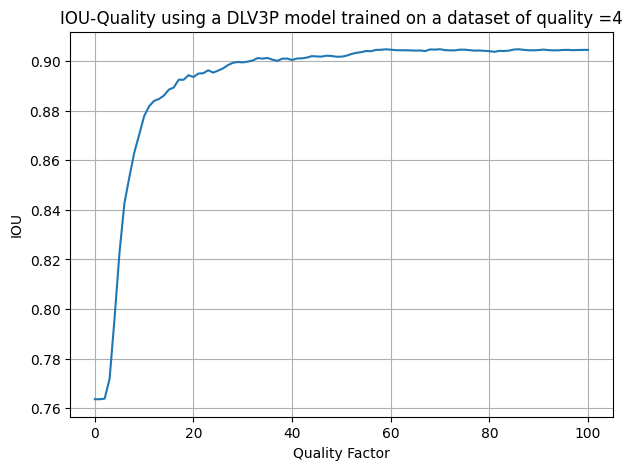

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.78it/s, dice_loss - 0.05206, iou_score - 0.9046]
DLV3P model trained on dataset of quality= 4 
test on uncompressed dataset
Evaluation Loss: 0.05206376547906915
Evaluation IoU: 0.9046180517065757
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.61it/s, dice_loss - 0.1427, iou_score - 0.7659]
Evaluation Loss: 0.14265036466074926
Evaluation IoU: 0.7659225569051854
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

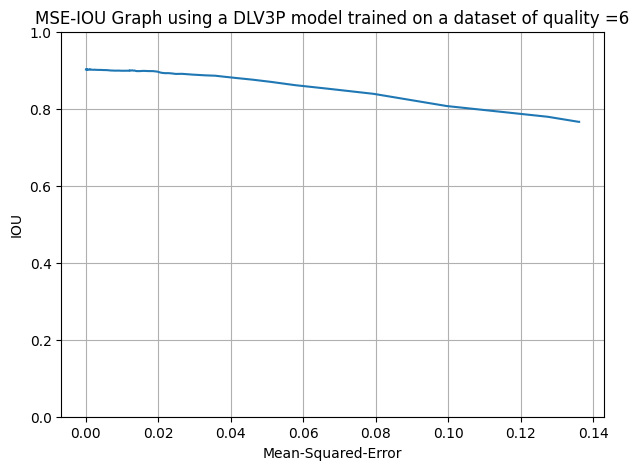

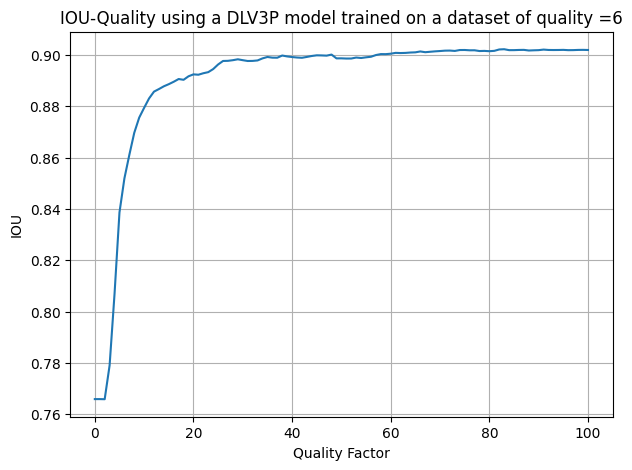

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.0538, iou_score - 0.9019] 
DLV3P model trained on dataset of quality= 6 
test on uncompressed dataset
Evaluation Loss: 0.05379825947331446
Evaluation IoU: 0.9019142798348968
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.82it/s, dice_loss - 0.144, iou_score - 0.7644] 
Evaluation Loss: 0.14398275520287307
Evaluation IoU: 0.7643623889661302
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

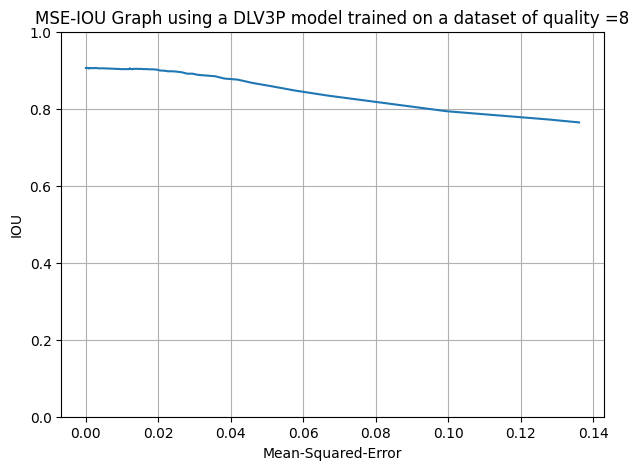

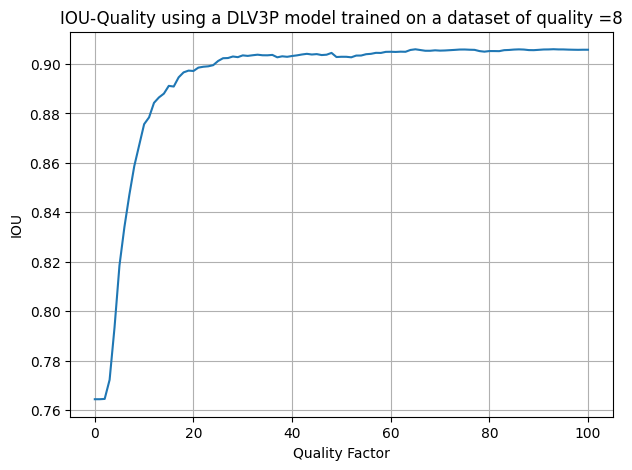

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.05165, iou_score - 0.9059]
DLV3P model trained on dataset of quality= 8 
test on uncompressed dataset
Evaluation Loss: 0.05165038739933686
Evaluation IoU: 0.9058979399064008
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.76it/s, dice_loss - 0.1344, iou_score - 0.7786]
Evaluation Loss: 0.13439651564055796
Evaluation IoU: 0.7785608458752727
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

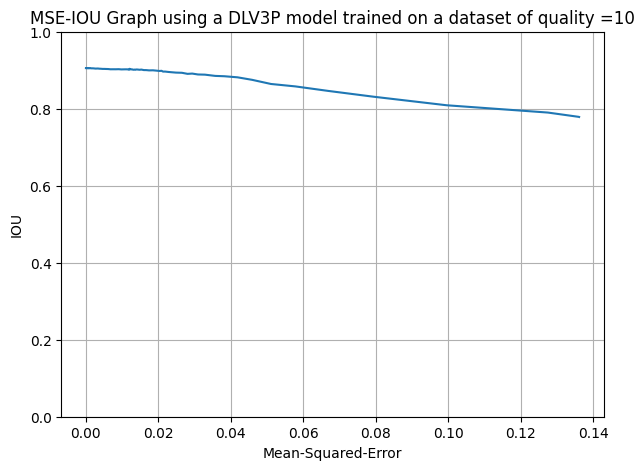

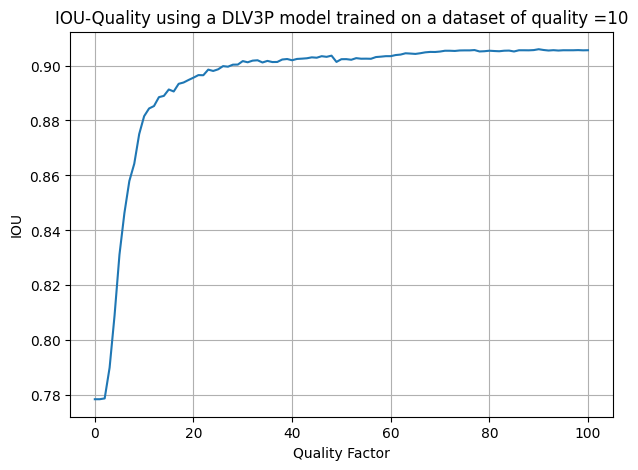

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.05206, iou_score - 0.9055]
DLV3P model trained on dataset of quality= 10 
test on uncompressed dataset
Evaluation Loss: 0.05205509358761358
Evaluation IoU: 0.9054951656098459
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.77it/s, dice_loss - 0.1572, iou_score - 0.7463]
Evaluation Loss: 0.15724993219562602
Evaluation IoU: 0.7463004004721547
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

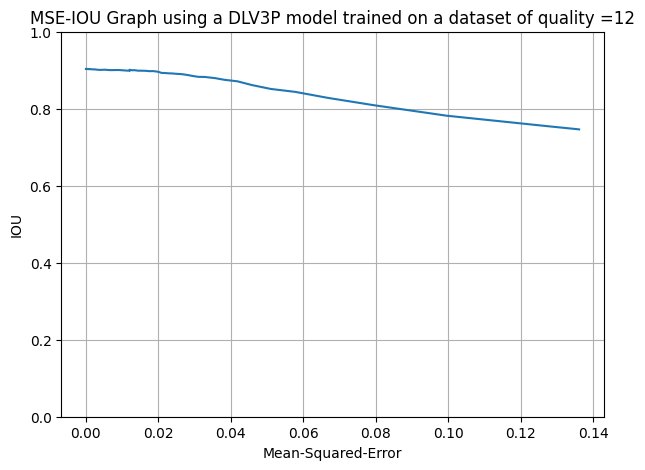

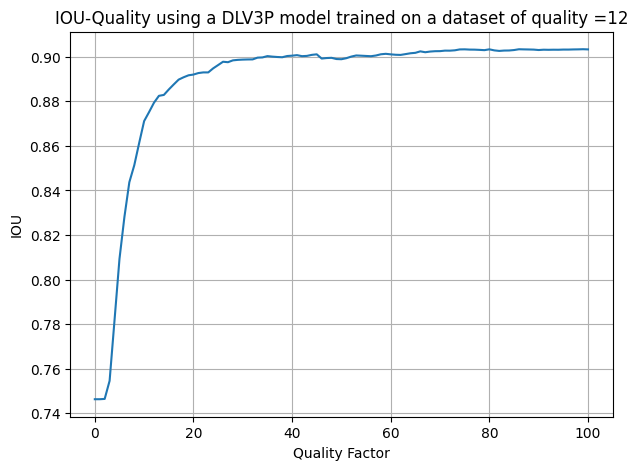

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.62it/s, dice_loss - 0.05306, iou_score - 0.9033]
DLV3P model trained on dataset of quality= 12 
test on uncompressed dataset
Evaluation Loss: 0.053062867884542446
Evaluation IoU: 0.9032995373594996
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.1483, iou_score - 0.7579]
Evaluation Loss: 0.1483428945728377
Evaluation IoU: 0.7578517058316397
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

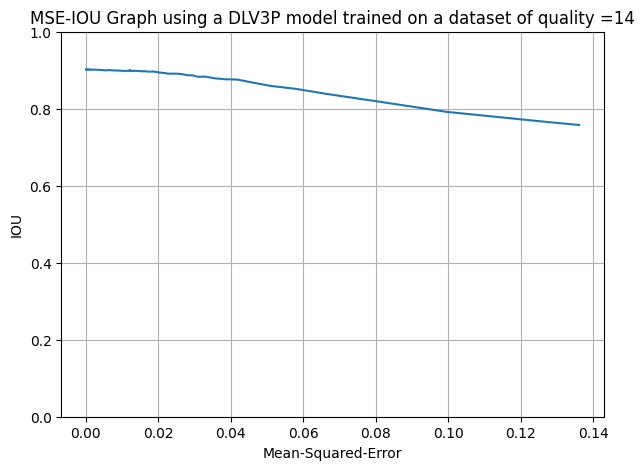

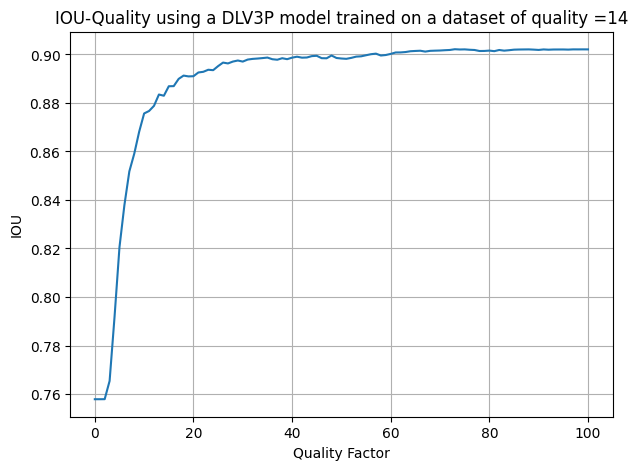

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.05372, iou_score - 0.9021]
DLV3P model trained on dataset of quality= 14 
test on uncompressed dataset
Evaluation Loss: 0.05372466643651327
Evaluation IoU: 0.9020976646273743
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.1412, iou_score - 0.7684]
Evaluation Loss: 0.14121335394242227
Evaluation IoU: 0.7684401577594234
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

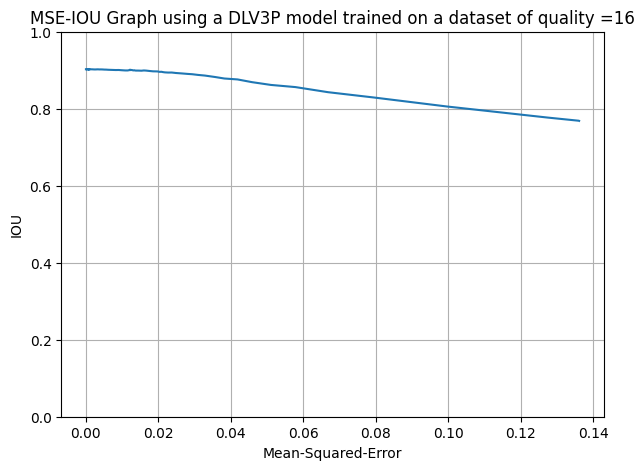

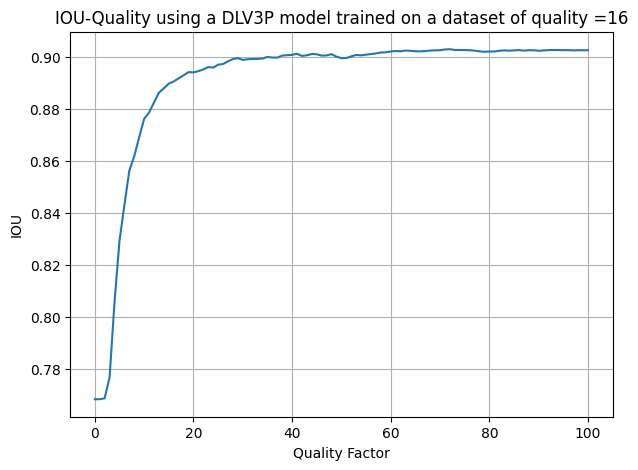

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.05367, iou_score - 0.9025]
DLV3P model trained on dataset of quality= 16 
test on uncompressed dataset
Evaluation Loss: 0.053673343331206075
Evaluation IoU: 0.9024690459756288
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.137, iou_score - 0.7734] 
Evaluation Loss: 0.13704586145924583
Evaluation IoU: 0.773379223019469
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

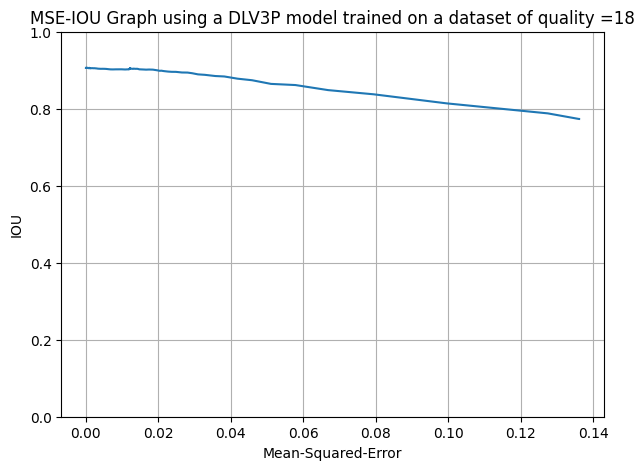

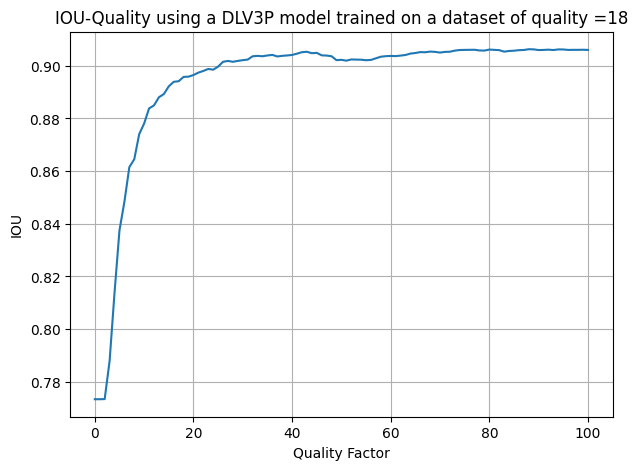

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.05154, iou_score - 0.906] 
DLV3P model trained on dataset of quality= 18 
test on uncompressed dataset
Evaluation Loss: 0.05154413802950989
Evaluation IoU: 0.9060111209457995
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.1446, iou_score - 0.7632]
Evaluation Loss: 0.14463976785248409
Evaluation IoU: 0.7632067110024249
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

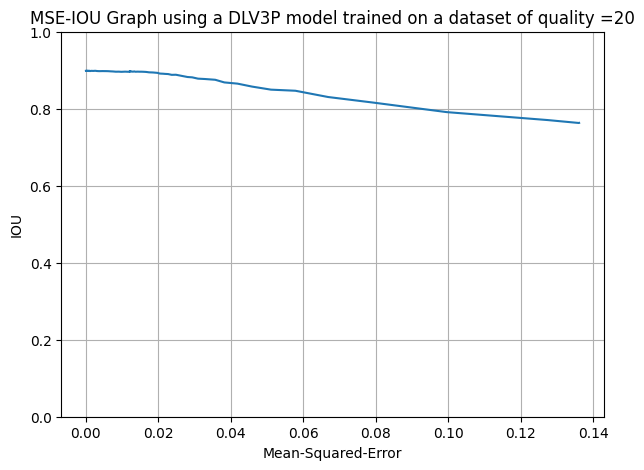

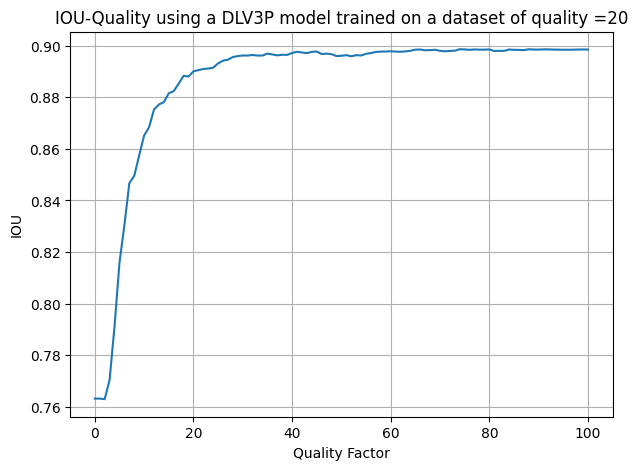

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.05589, iou_score - 0.8985]
DLV3P model trained on dataset of quality= 20 
test on uncompressed dataset
Evaluation Loss: 0.05588786157907224
Evaluation IoU: 0.8985158543960721
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.76it/s, dice_loss - 0.1424, iou_score - 0.7667]
Evaluation Loss: 0.14244167126861274
Evaluation IoU: 0.7667257300778935
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

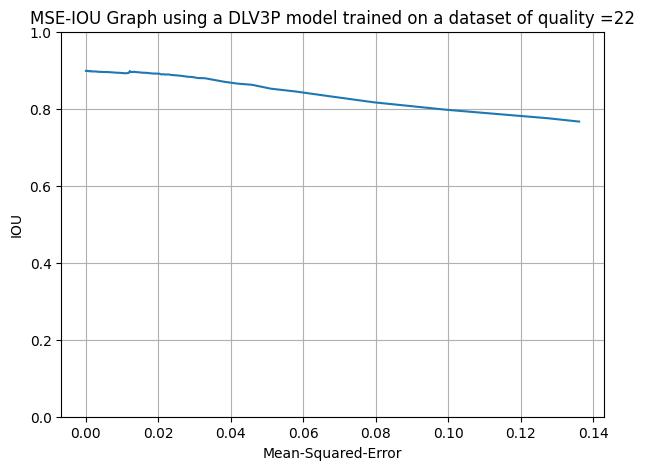

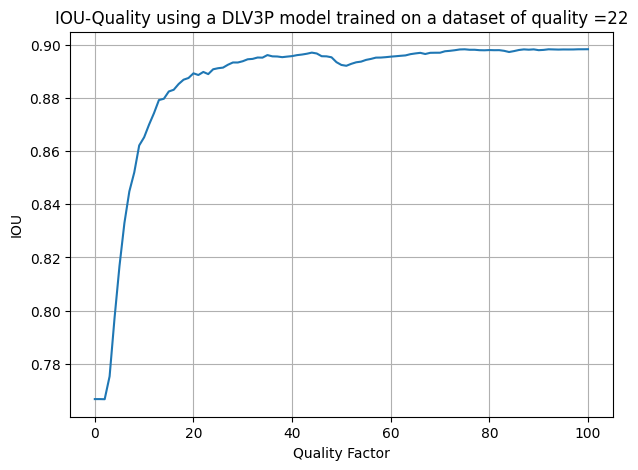

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.05596, iou_score - 0.8983]
DLV3P model trained on dataset of quality= 22 
test on uncompressed dataset
Evaluation Loss: 0.055956456006741984
Evaluation IoU: 0.8983350851956535
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.1451, iou_score - 0.7627]
Evaluation Loss: 0.1450896263122559
Evaluation IoU: 0.7627458502264585
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

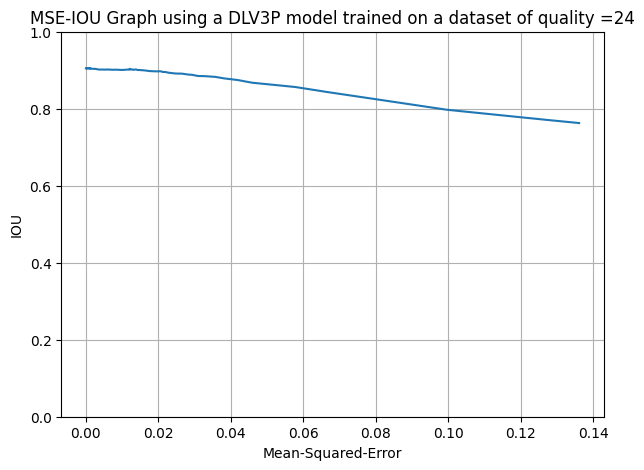

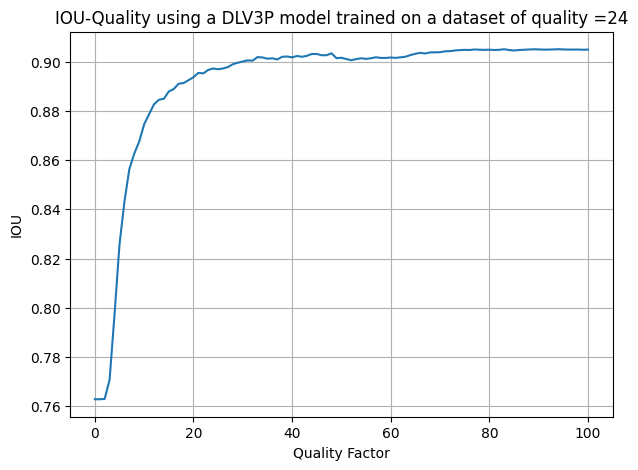

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.74it/s, dice_loss - 0.05228, iou_score - 0.9049]
DLV3P model trained on dataset of quality= 24 
test on uncompressed dataset
Evaluation Loss: 0.05228203067592545
Evaluation IoU: 0.9048900043263153
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.1375, iou_score - 0.7734]
Evaluation Loss: 0.13751448836981084
Evaluation IoU: 0.7733762620710858
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

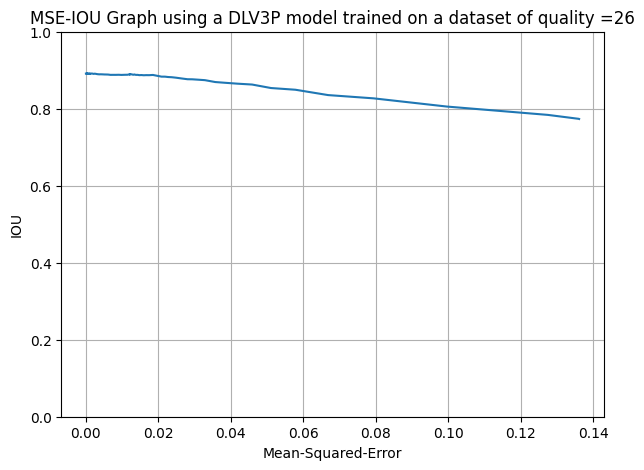

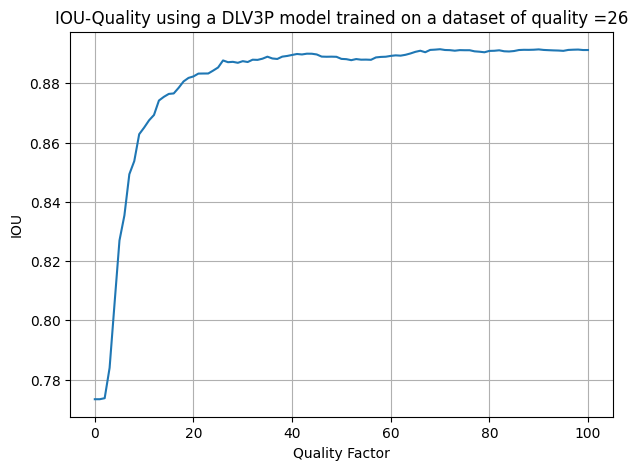

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.06013, iou_score - 0.8911]
DLV3P model trained on dataset of quality= 26 
test on uncompressed dataset
Evaluation Loss: 0.06013203602211148
Evaluation IoU: 0.8911388119061787
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.1405, iou_score - 0.7696]
Evaluation Loss: 0.1405044630462048
Evaluation IoU: 0.7695705242016737
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

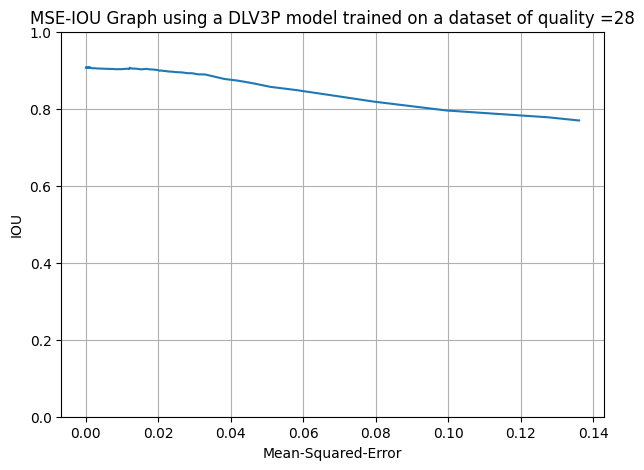

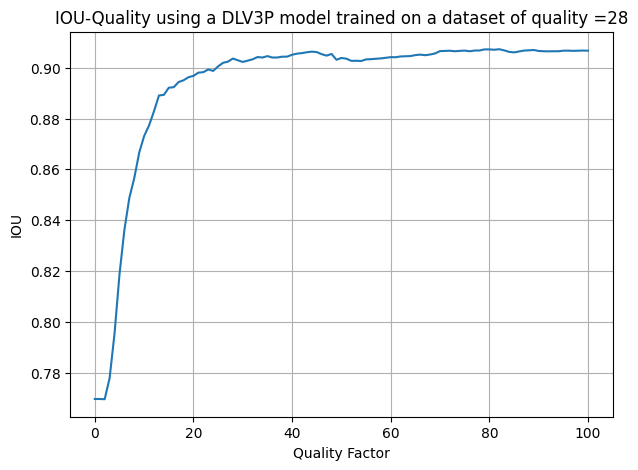

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05129, iou_score - 0.9067]
DLV3P model trained on dataset of quality= 28 
test on uncompressed dataset
Evaluation Loss: 0.051286027711980466
Evaluation IoU: 0.906701752952501
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.1504, iou_score - 0.7548]
Evaluation Loss: 0.1504384957107843
Evaluation IoU: 0.7547825107387468
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

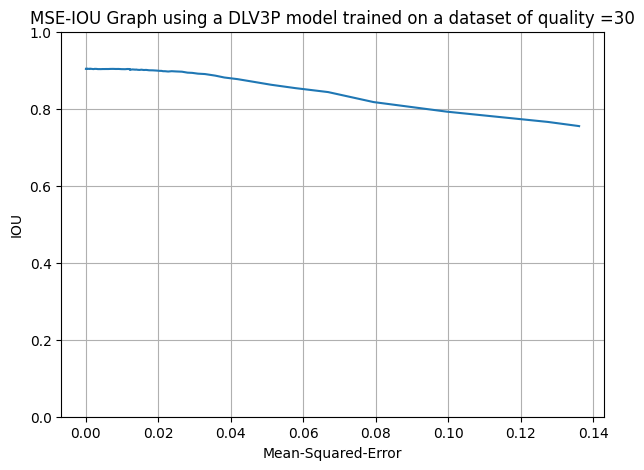

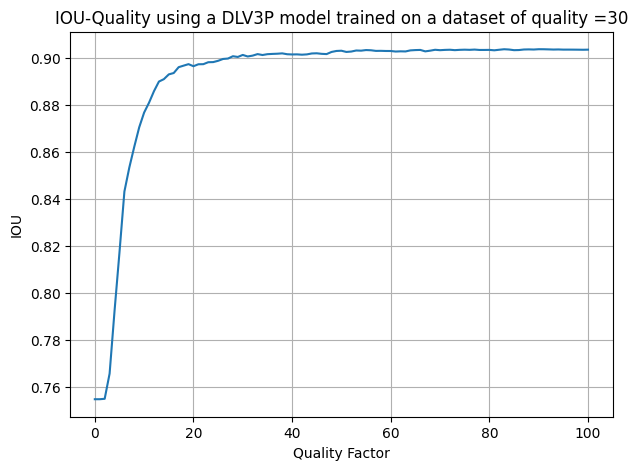

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.05322, iou_score - 0.9036]
DLV3P model trained on dataset of quality= 30 
test on uncompressed dataset
Evaluation Loss: 0.053224174415363985
Evaluation IoU: 0.9035720205774493
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.78it/s, dice_loss - 0.1376, iou_score - 0.7737]
Evaluation Loss: 0.137552770913816
Evaluation IoU: 0.7737085264103083
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

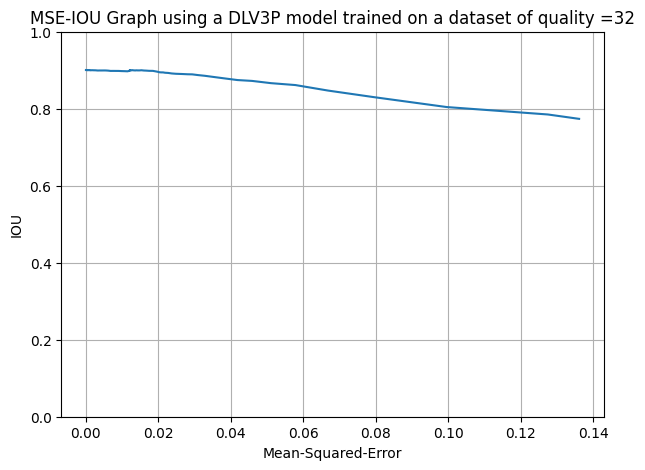

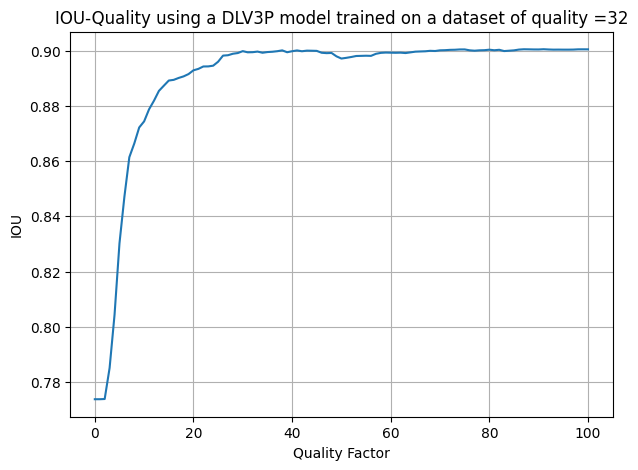

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.68it/s, dice_loss - 0.05468, iou_score - 0.9006]
DLV3P model trained on dataset of quality= 32 
test on uncompressed dataset
Evaluation Loss: 0.05468268020480286
Evaluation IoU: 0.9005814019371482
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.78it/s, dice_loss - 0.1477, iou_score - 0.7588]
Evaluation Loss: 0.14773942208757584
Evaluation IoU: 0.758802583988975
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

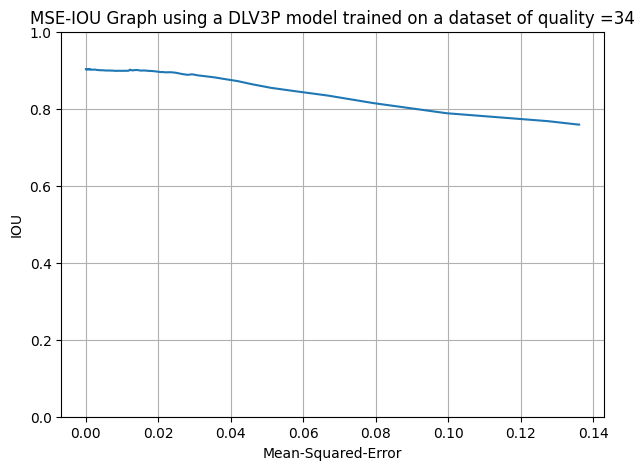

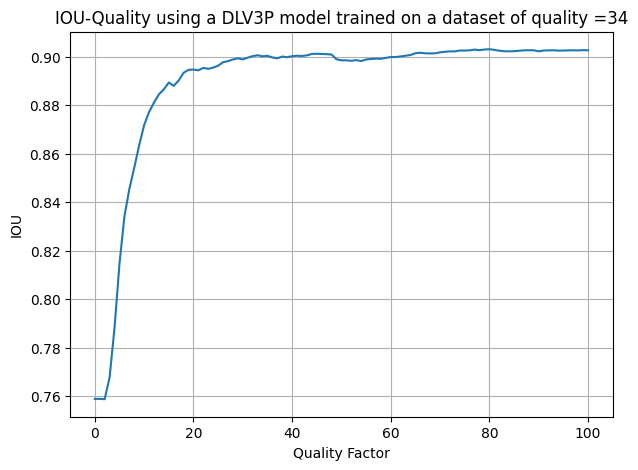

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.05342, iou_score - 0.9026]
DLV3P model trained on dataset of quality= 34 
test on uncompressed dataset
Evaluation Loss: 0.053424969607708504
Evaluation IoU: 0.9026407260520783
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.1353, iou_score - 0.7756]
Evaluation Loss: 0.13528337665632661
Evaluation IoU: 0.7756200596397997
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:

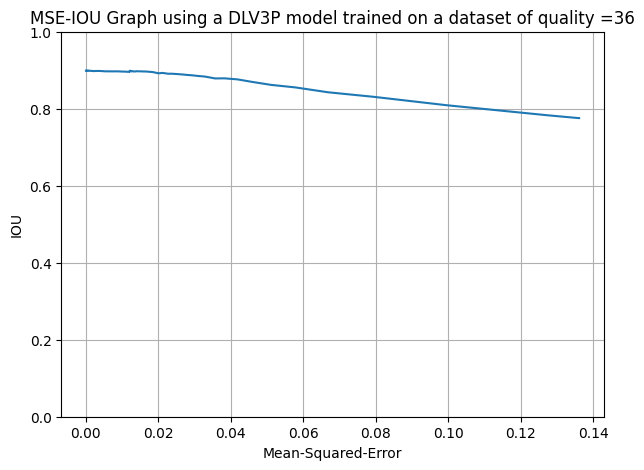

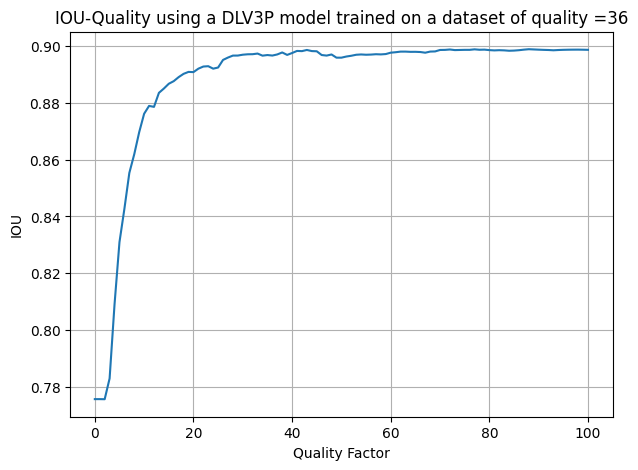

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.51it/s, dice_loss - 0.05569, iou_score - 0.8987]
DLV3P model trained on dataset of quality= 36 
test on uncompressed dataset
Evaluation Loss: 0.05569142336938896
Evaluation IoU: 0.8986882894646887
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.59it/s, dice_loss - 0.1499, iou_score - 0.756] 
Evaluation Loss: 0.14985823748158472
Evaluation IoU: 0.7559584087016533
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

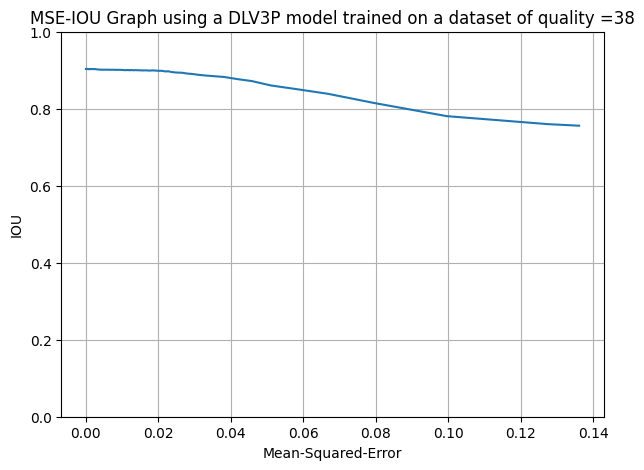

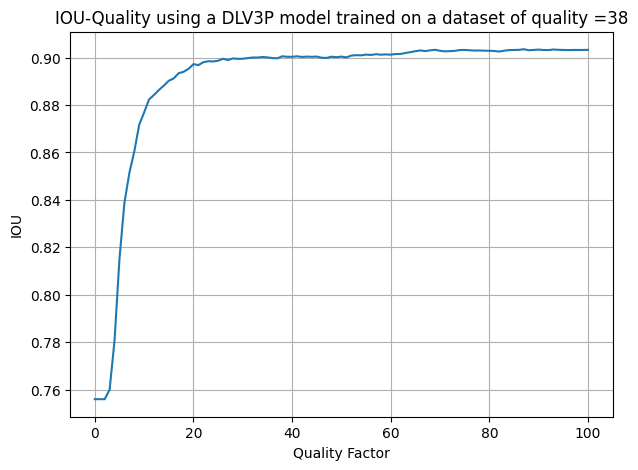

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.05326, iou_score - 0.9032]
DLV3P model trained on dataset of quality= 38 
test on uncompressed dataset
Evaluation Loss: 0.05325713929008035
Evaluation IoU: 0.9032471916254831
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.1435, iou_score - 0.7649]
Evaluation Loss: 0.14350826950634224
Evaluation IoU: 0.7649052084660998
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

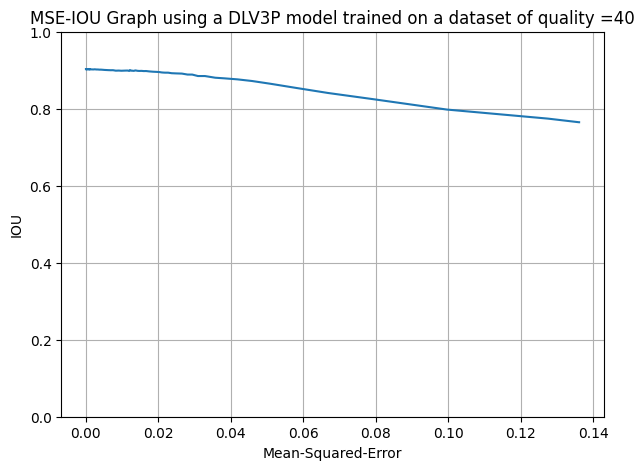

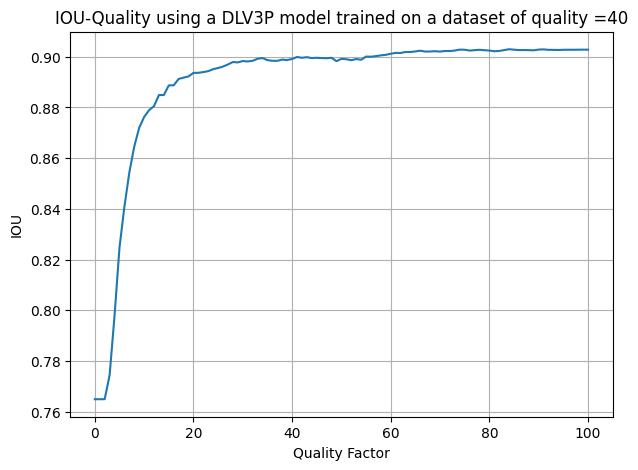

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.70it/s, dice_loss - 0.05351, iou_score - 0.9028]
DLV3P model trained on dataset of quality= 40 
test on uncompressed dataset
Evaluation Loss: 0.053507157400542606
Evaluation IoU: 0.9027803037680832
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.77it/s, dice_loss - 0.1416, iou_score - 0.7679]
Evaluation Loss: 0.14157761195126706
Evaluation IoU: 0.7679329292446961
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:

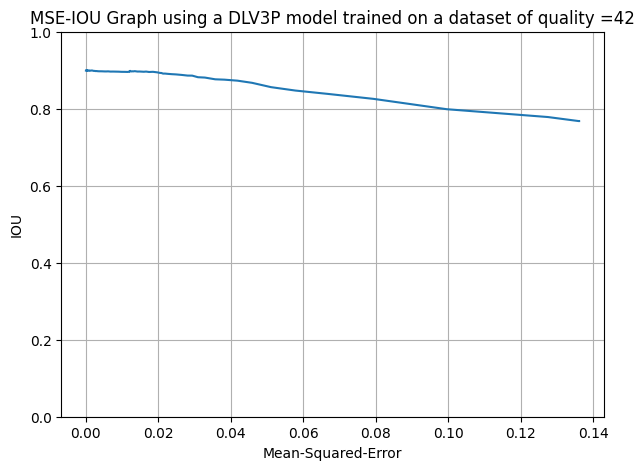

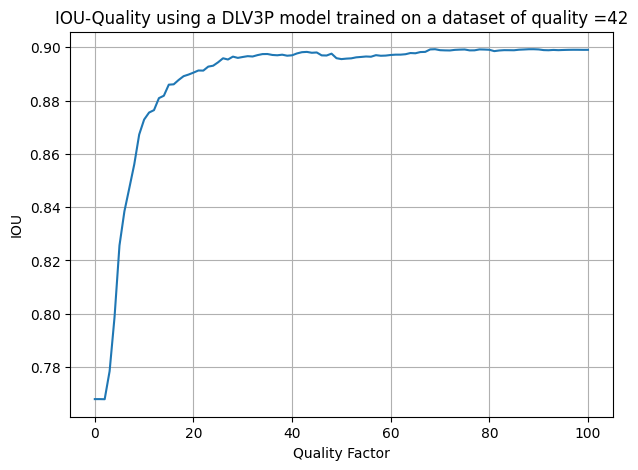

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.64it/s, dice_loss - 0.05581, iou_score - 0.8992]
DLV3P model trained on dataset of quality= 42 
test on uncompressed dataset
Evaluation Loss: 0.05581083250980751
Evaluation IoU: 0.8991886973381045
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.66it/s, dice_loss - 0.1387, iou_score - 0.7725]
Evaluation Loss: 0.1386948531749201
Evaluation IoU: 0.7724613997281767
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

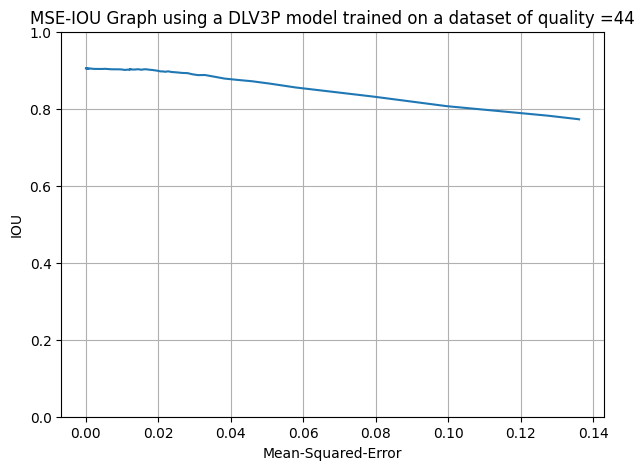

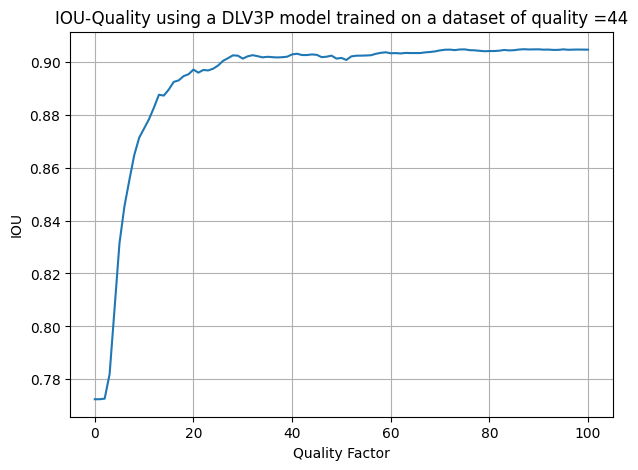

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.60it/s, dice_loss - 0.05225, iou_score - 0.9048]
DLV3P model trained on dataset of quality= 44 
test on uncompressed dataset
Evaluation Loss: 0.05225142076903697
Evaluation IoU: 0.9047563391573291
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.1465, iou_score - 0.7599]
Evaluation Loss: 0.14649930771659406
Evaluation IoU: 0.7598891217334599
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

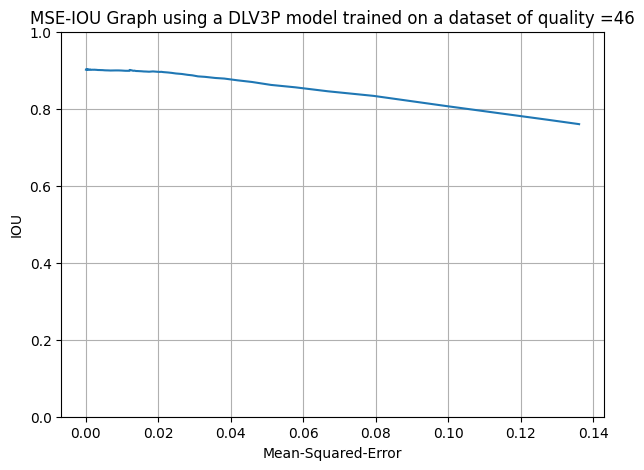

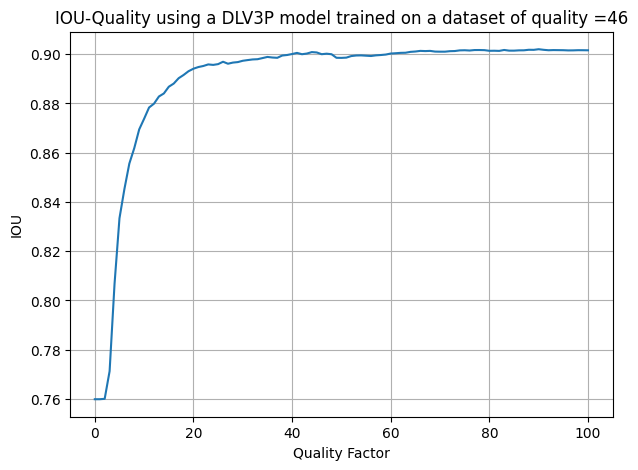

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:14<00:00,  3.44it/s, dice_loss - 0.05414, iou_score - 0.9016]
DLV3P model trained on dataset of quality= 46 
test on uncompressed dataset
Evaluation Loss: 0.05414005704954559
Evaluation IoU: 0.9015889845642387
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.57it/s, dice_loss - 0.144, iou_score - 0.7642] 
Evaluation Loss: 0.14401263232324635
Evaluation IoU: 0.7641924198936014
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:0

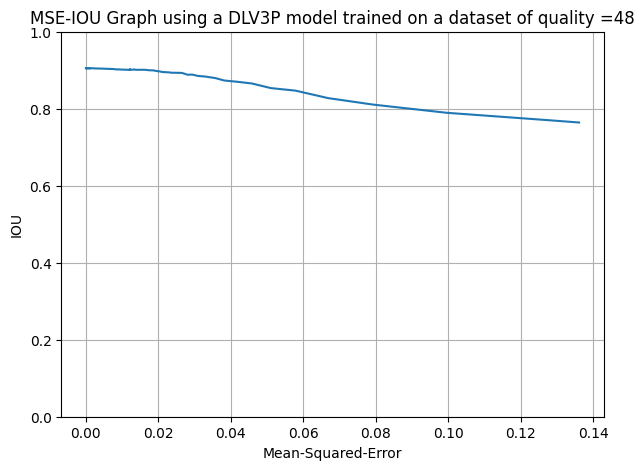

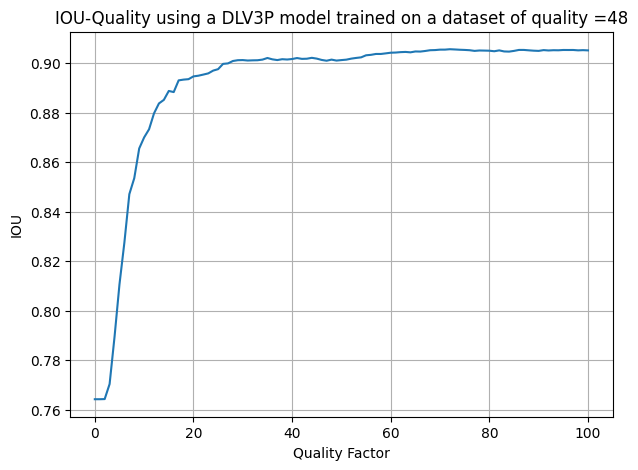

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:18<00:00,  2.79it/s, dice_loss - 0.0521, iou_score - 0.9053] 
DLV3P model trained on dataset of quality= 48 
test on uncompressed dataset
Evaluation Loss: 0.05209711603089875
Evaluation IoU: 0.9053379682933584
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,  2.97it/s, dice_loss - 0.1383, iou_score - 0.7722]
Evaluation Loss: 0.13832917400434905
Evaluation IoU: 0.7722415053376964
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:0

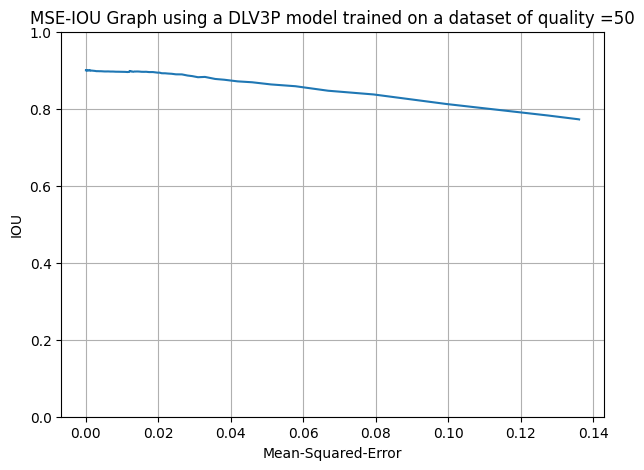

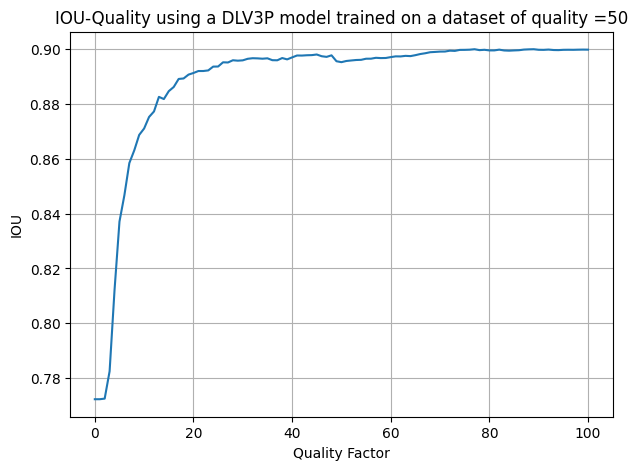

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.74it/s, dice_loss - 0.05522, iou_score - 0.8998]
DLV3P model trained on dataset of quality= 50 
test on uncompressed dataset
Evaluation Loss: 0.055222590764363616
Evaluation IoU: 0.8997725867757613
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.87it/s, dice_loss - 0.1437, iou_score - 0.7645]
Evaluation Loss: 0.14368108440847963
Evaluation IoU: 0.764500542598612
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

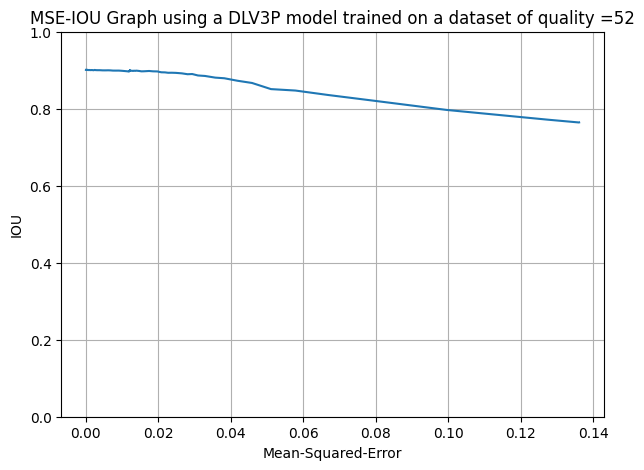

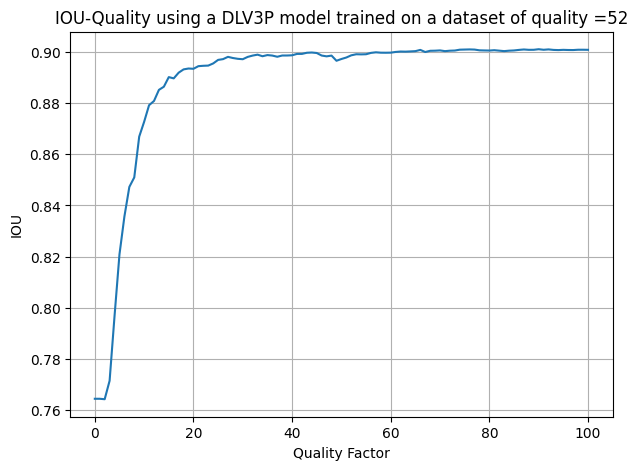

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.74it/s, dice_loss - 0.05475, iou_score - 0.9009]
DLV3P model trained on dataset of quality= 52 
test on uncompressed dataset
Evaluation Loss: 0.05474515755971272
Evaluation IoU: 0.9008799522530802
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.88it/s, dice_loss - 0.1424, iou_score - 0.7663]
Evaluation Loss: 0.14241245564292462
Evaluation IoU: 0.7662727108188703
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

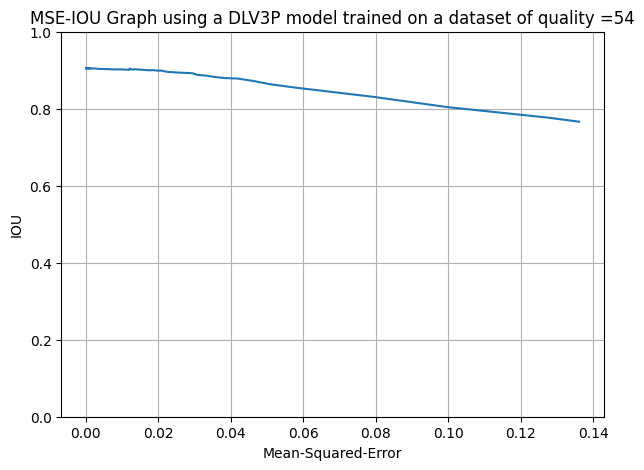

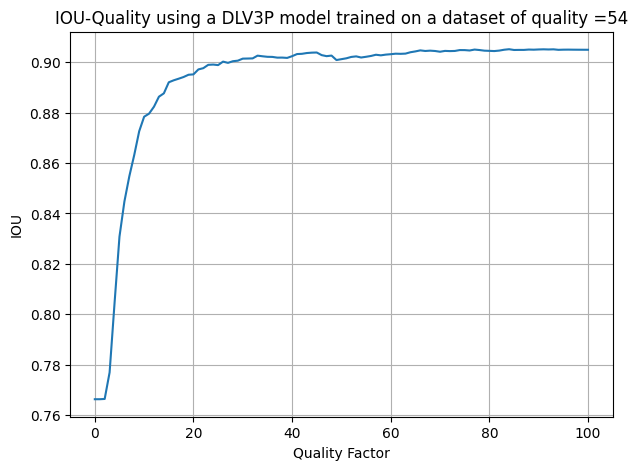

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.05213, iou_score - 0.9049]
DLV3P model trained on dataset of quality= 54 
test on uncompressed dataset
Evaluation Loss: 0.052127791386024636
Evaluation IoU: 0.904885271016289
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.142, iou_score - 0.767]  
Evaluation Loss: 0.14203145457249067
Evaluation IoU: 0.7669867522576277
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

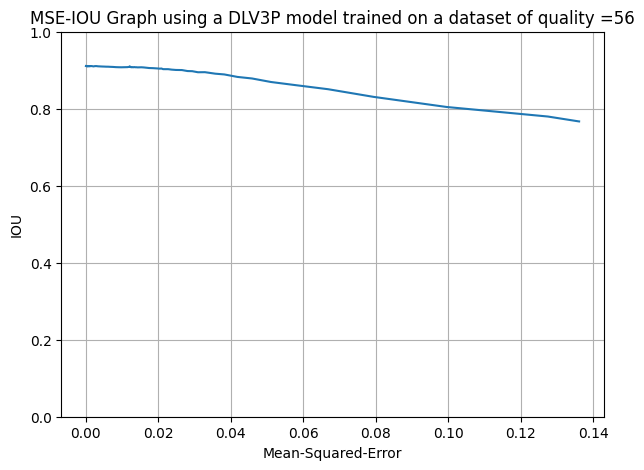

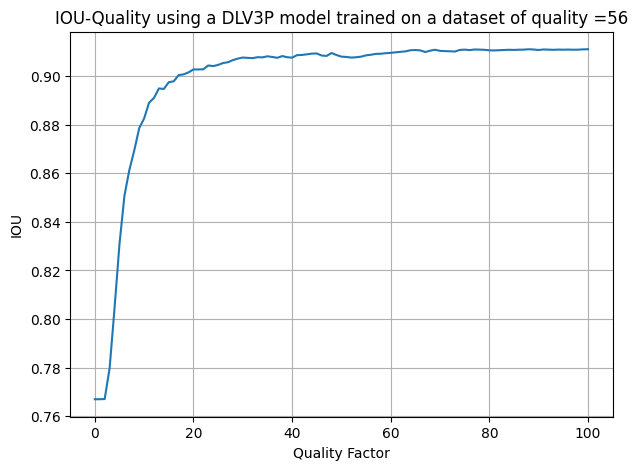

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.04892, iou_score - 0.9109]
DLV3P model trained on dataset of quality= 56 
test on uncompressed dataset
Evaluation Loss: 0.04892436078950471
Evaluation IoU: 0.9109214065121668
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.71it/s, dice_loss - 0.1438, iou_score - 0.7647]
Evaluation Loss: 0.14383315105064243
Evaluation IoU: 0.7646636559682737
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

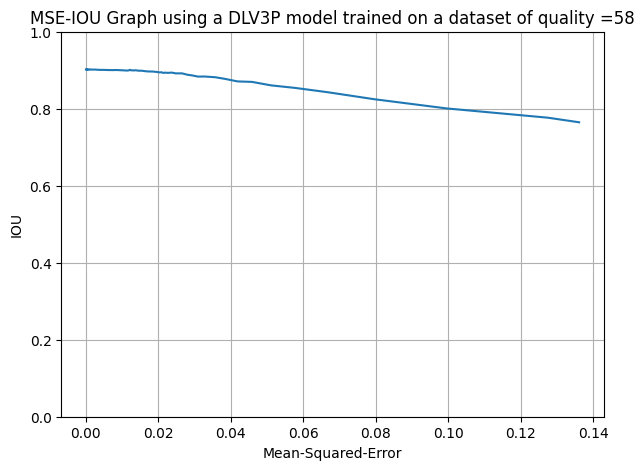

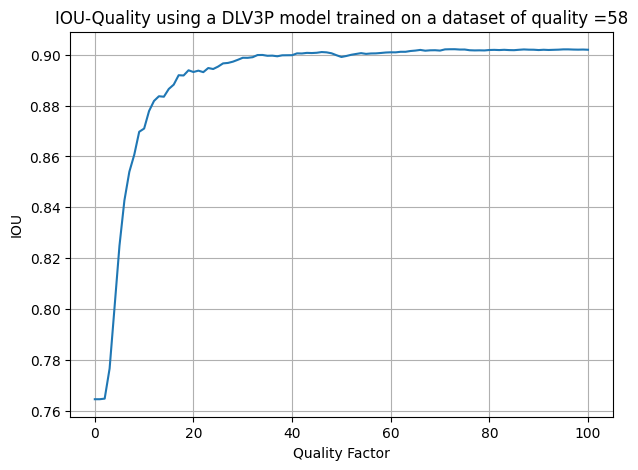

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:17<00:00,  2.89it/s, dice_loss - 0.05412, iou_score - 0.902] 
DLV3P model trained on dataset of quality= 58 
test on uncompressed dataset
Evaluation Loss: 0.05411640803019206
Evaluation IoU: 0.9020056572614932
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:00,  2.89it/s, dice_loss - 0.1423, iou_score - 0.7678]
Evaluation Loss: 0.14233769856247241
Evaluation IoU: 0.7678369786225112
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:17<00:0

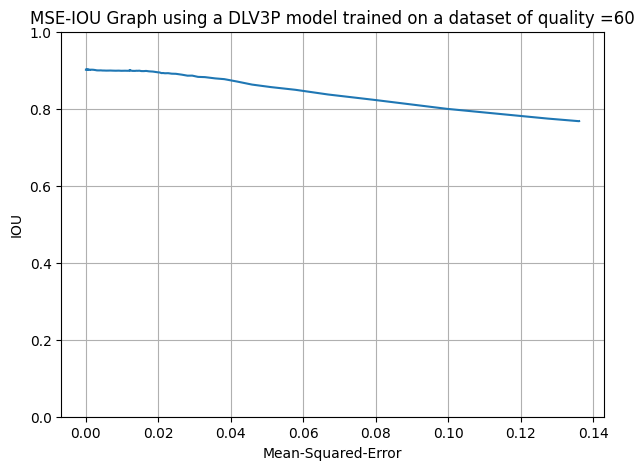

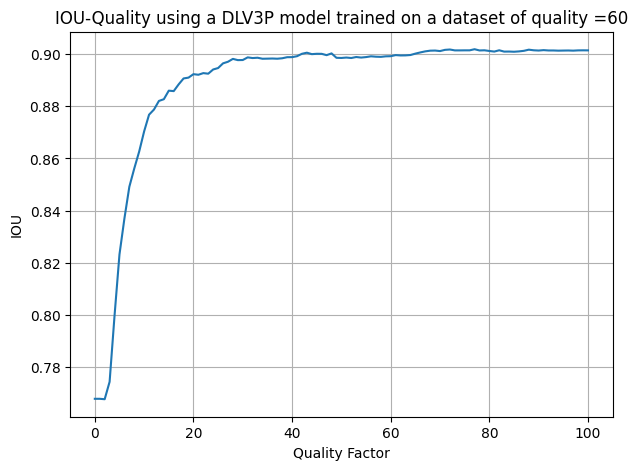

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:18<00:00,  2.74it/s, dice_loss - 0.05551, iou_score - 0.9014]
DLV3P model trained on dataset of quality= 60 
test on uncompressed dataset
Evaluation Loss: 0.055510541971992025
Evaluation IoU: 0.9014455711140354
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:18<00:00,  2.73it/s, dice_loss - 0.1447, iou_score - 0.7634]
Evaluation Loss: 0.14474102562549065
Evaluation IoU: 0.7633746611137016
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:

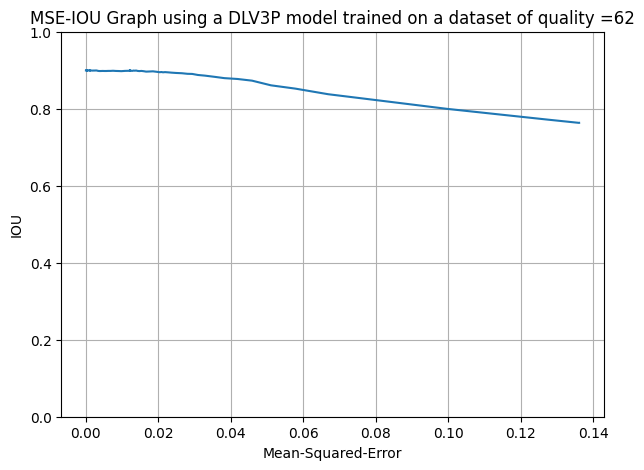

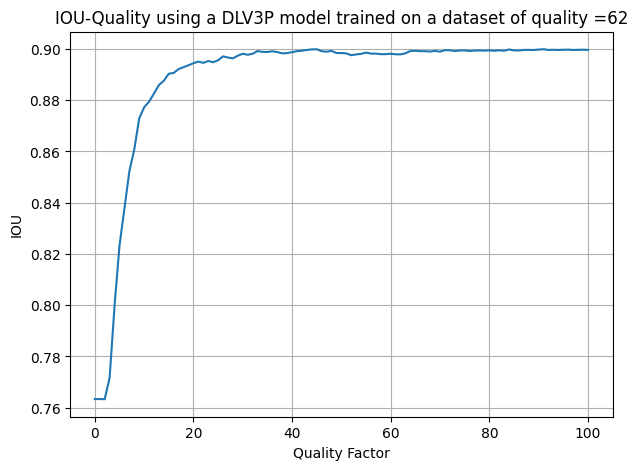

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:15<00:00,  3.35it/s, dice_loss - 0.05559, iou_score - 0.8994]
DLV3P model trained on dataset of quality= 62 
test on uncompressed dataset
Evaluation Loss: 0.05558928204517736
Evaluation IoU: 0.899443469795526
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00,  3.35it/s, dice_loss - 0.1399, iou_score - 0.77]  
Evaluation Loss: 0.13994559353473138
Evaluation IoU: 0.7699892117696648
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:15<00:00

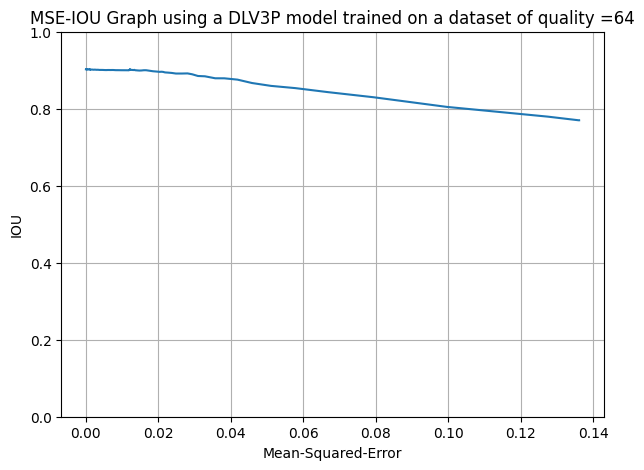

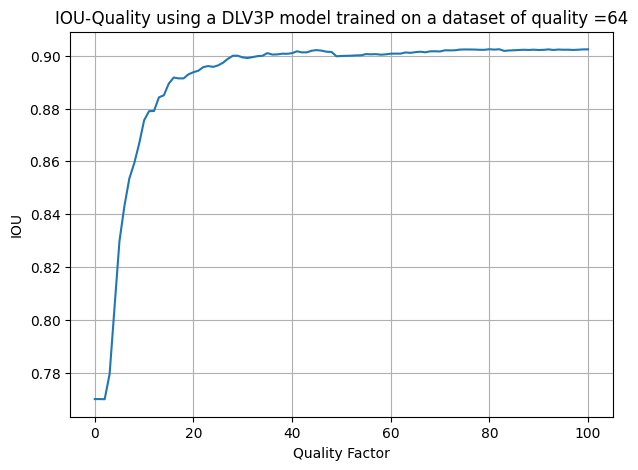

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.05381, iou_score - 0.9023]
DLV3P model trained on dataset of quality= 64 
test on uncompressed dataset
Evaluation Loss: 0.05380610624949137
Evaluation IoU: 0.9023377825232113
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.82it/s, dice_loss - 0.1434, iou_score - 0.7649]
Evaluation Loss: 0.14344510260750268
Evaluation IoU: 0.764898445676355
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

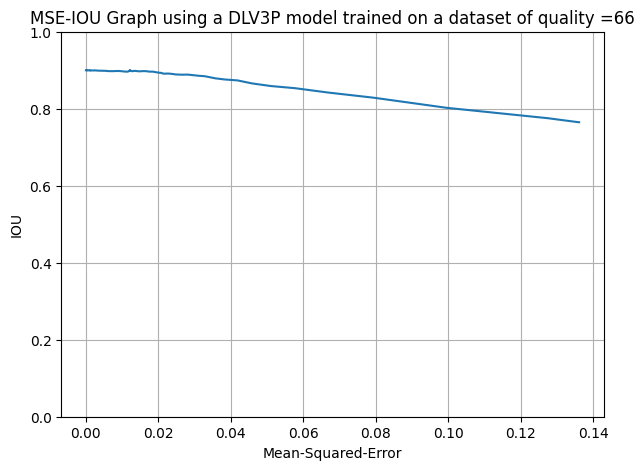

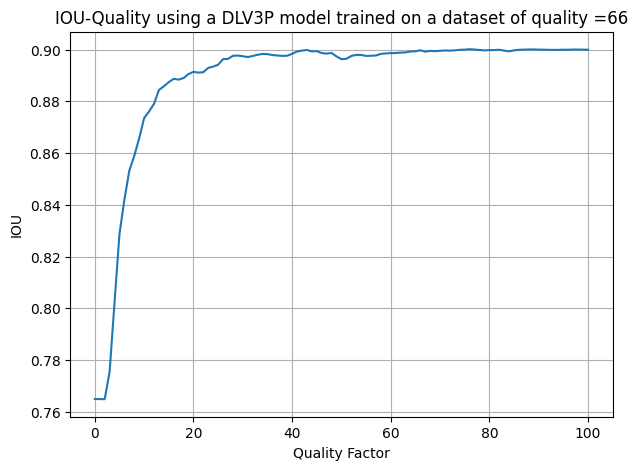

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.05533, iou_score - 0.9]   
DLV3P model trained on dataset of quality= 66 
test on uncompressed dataset
Evaluation Loss: 0.05533134703542672
Evaluation IoU: 0.9000241172079946
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.87it/s, dice_loss - 0.1441, iou_score - 0.7637]
Evaluation Loss: 0.14412172635396317
Evaluation IoU: 0.763654853783402
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

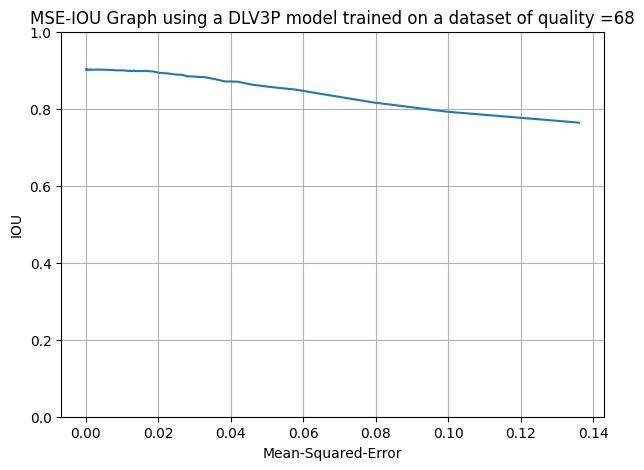

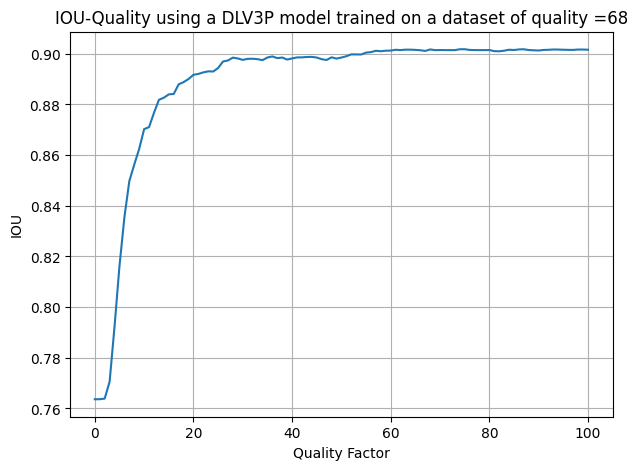

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.05415, iou_score - 0.9018]
DLV3P model trained on dataset of quality= 68 
test on uncompressed dataset
Evaluation Loss: 0.05414946523367191
Evaluation IoU: 0.9017908841955896
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.74it/s, dice_loss - 0.1375, iou_score - 0.773] 
Evaluation Loss: 0.137455261221119
Evaluation IoU: 0.7729547596445271
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

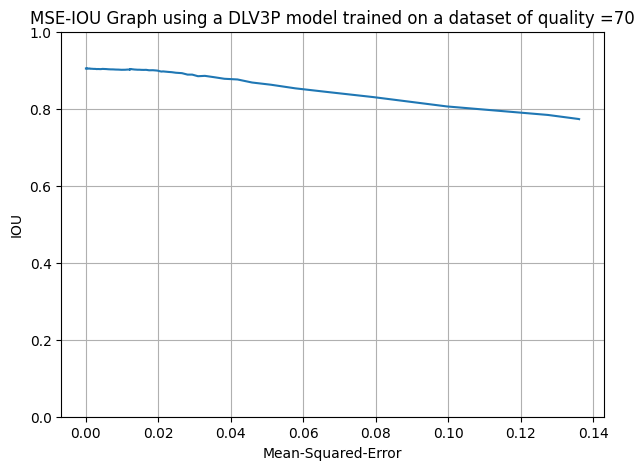

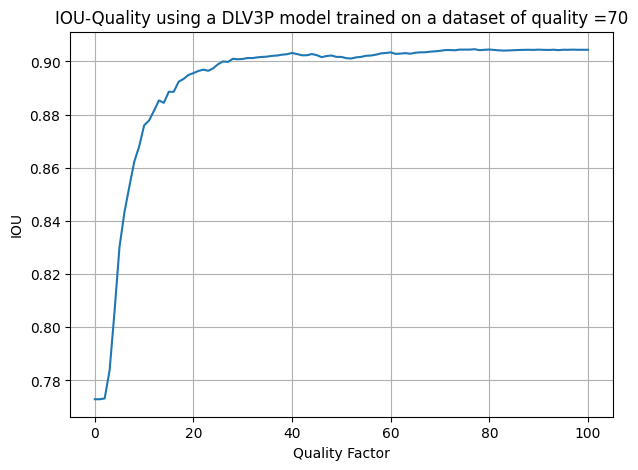

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.79it/s, dice_loss - 0.05212, iou_score - 0.9045]
DLV3P model trained on dataset of quality= 70 
test on uncompressed dataset
Evaluation Loss: 0.05211988734264
Evaluation IoU: 0.9044849650532593
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.77it/s, dice_loss - 0.1383, iou_score - 0.7724]
Evaluation Loss: 0.13831825116101434
Evaluation IoU: 0.7723714259325288
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00, 

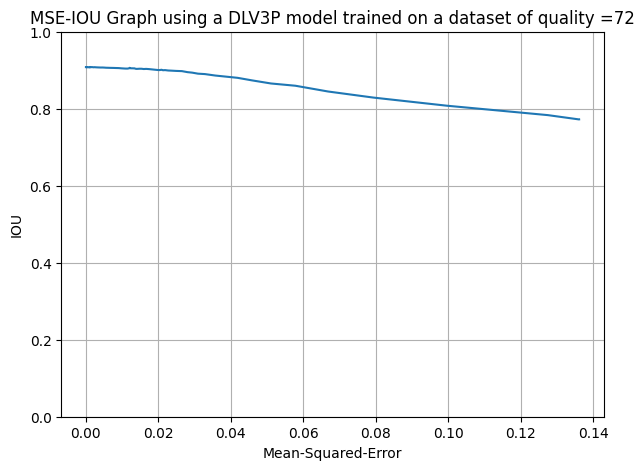

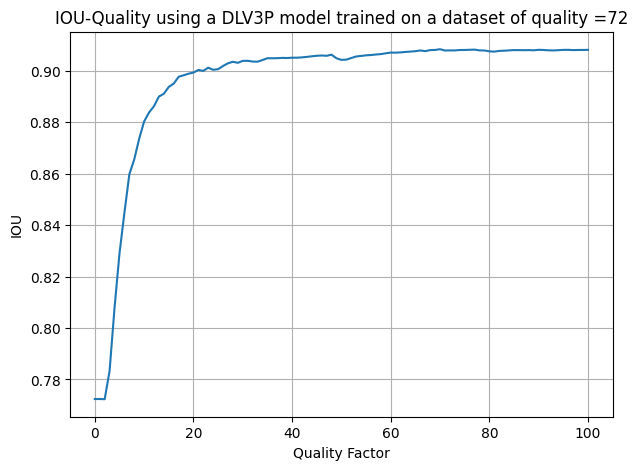

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.05023, iou_score - 0.9081]
DLV3P model trained on dataset of quality= 72 
test on uncompressed dataset
Evaluation Loss: 0.05023386197931626
Evaluation IoU: 0.9081083968573924
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.83it/s, dice_loss - 0.1454, iou_score - 0.7621]
Evaluation Loss: 0.14536640340206666
Evaluation IoU: 0.7621173058070388
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

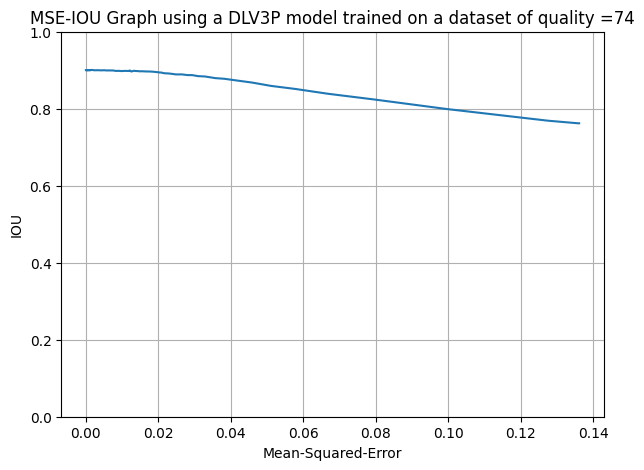

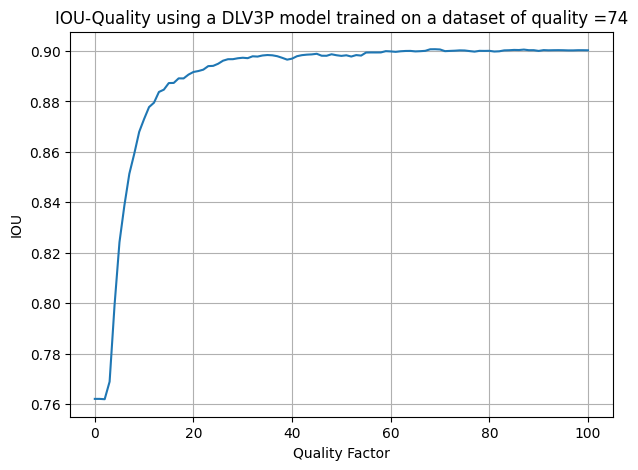

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.71it/s, dice_loss - 0.05502, iou_score - 0.9002]
DLV3P model trained on dataset of quality= 74 
test on uncompressed dataset
Evaluation Loss: 0.05501830694722195
Evaluation IoU: 0.9002292834076228
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.1383, iou_score - 0.7725]
Evaluation Loss: 0.1383085227480122
Evaluation IoU: 0.7724793342983022
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

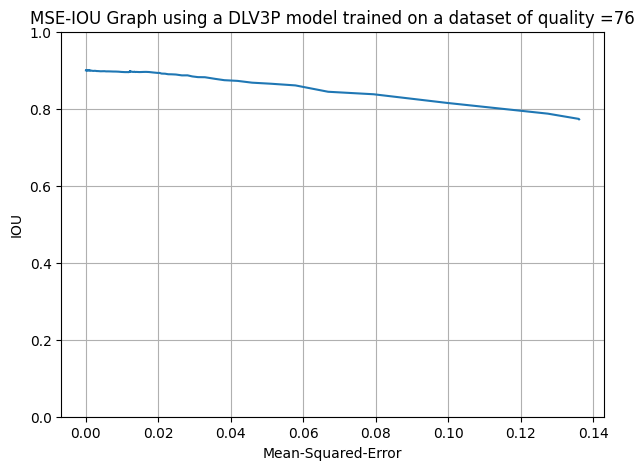

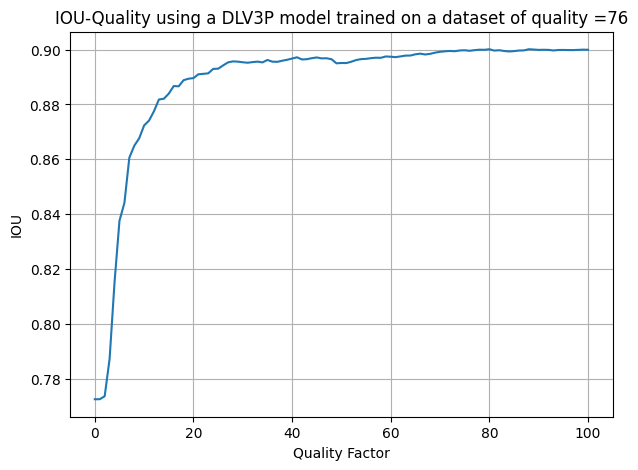

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.05527, iou_score - 0.8997]
DLV3P model trained on dataset of quality= 76 
test on uncompressed dataset
Evaluation Loss: 0.05527135437610103
Evaluation IoU: 0.899736254822974
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.1401, iou_score - 0.7697]
Evaluation Loss: 0.14005468639672974
Evaluation IoU: 0.7697042203417012
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

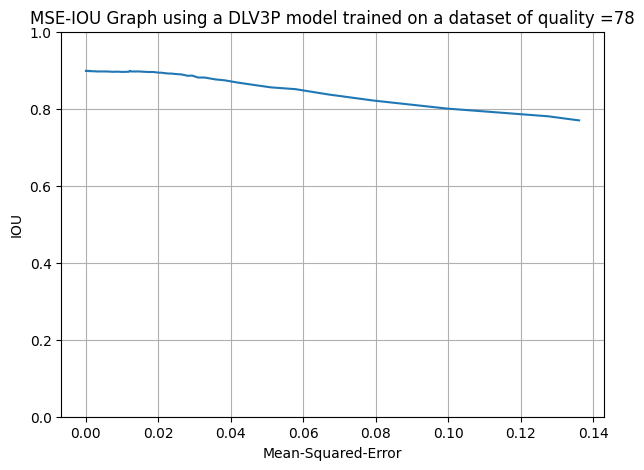

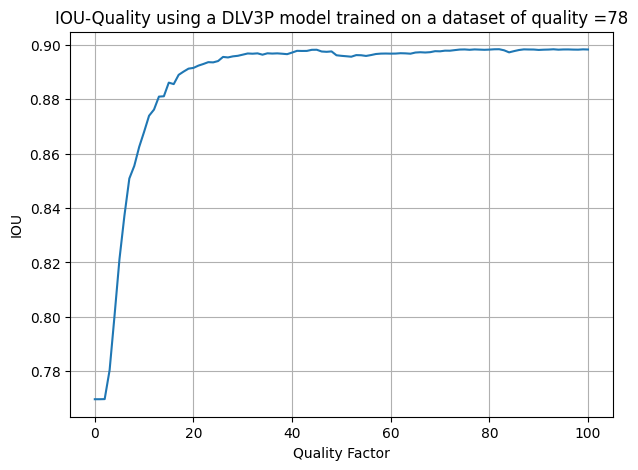

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.05629, iou_score - 0.8983]
DLV3P model trained on dataset of quality= 78 
test on uncompressed dataset
Evaluation Loss: 0.0562936873996959
Evaluation IoU: 0.8983000551953032
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.1455, iou_score - 0.7621]
Evaluation Loss: 0.14547319155113372
Evaluation IoU: 0.7621105307457493
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

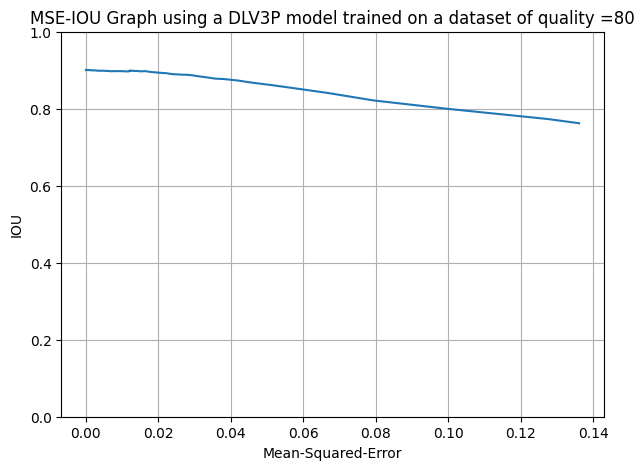

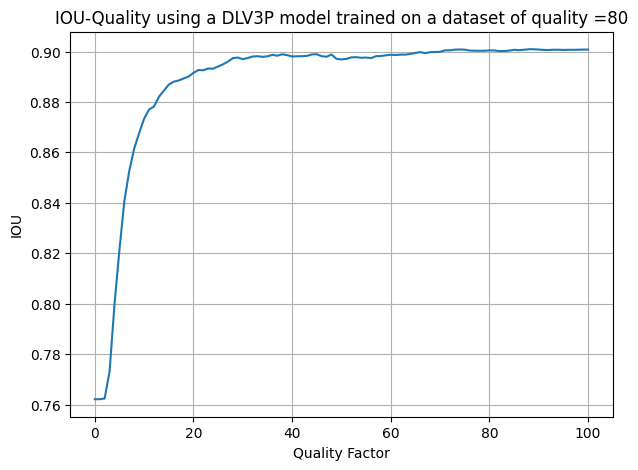

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.73it/s, dice_loss - 0.05443, iou_score - 0.9008]
DLV3P model trained on dataset of quality= 80 
test on uncompressed dataset
Evaluation Loss: 0.05443265508202945
Evaluation IoU: 0.9007526788057064
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.77it/s, dice_loss - 0.1384, iou_score - 0.772] 
Evaluation Loss: 0.13838516029657094
Evaluation IoU: 0.7720414376726338
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

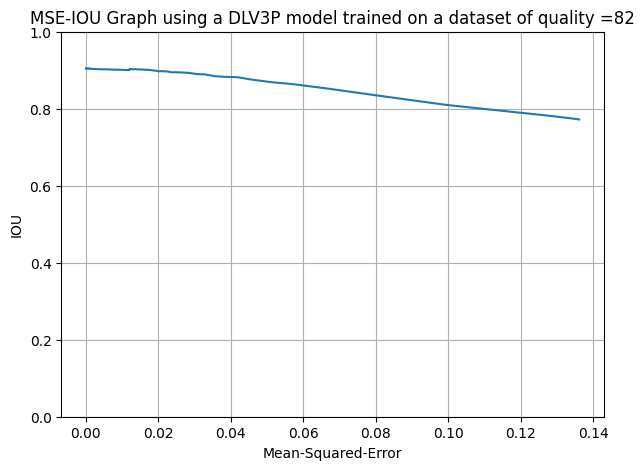

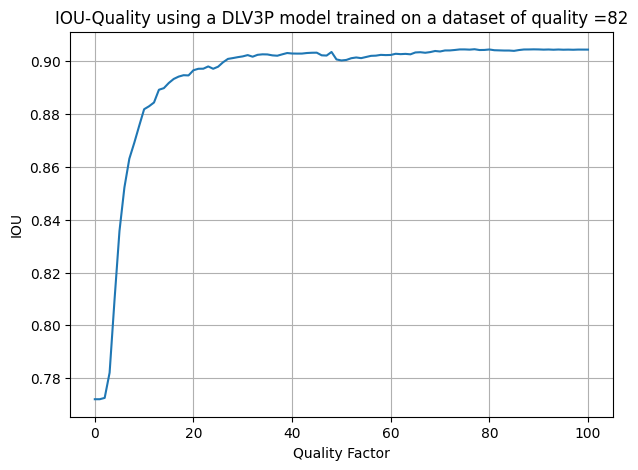

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.76it/s, dice_loss - 0.05234, iou_score - 0.9044]
DLV3P model trained on dataset of quality= 82 
test on uncompressed dataset
Evaluation Loss: 0.05234142612008486
Evaluation IoU: 0.9043920671238618
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.75it/s, dice_loss - 0.1429, iou_score - 0.7658]
Evaluation Loss: 0.1428624192873637
Evaluation IoU: 0.7658345284415227
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

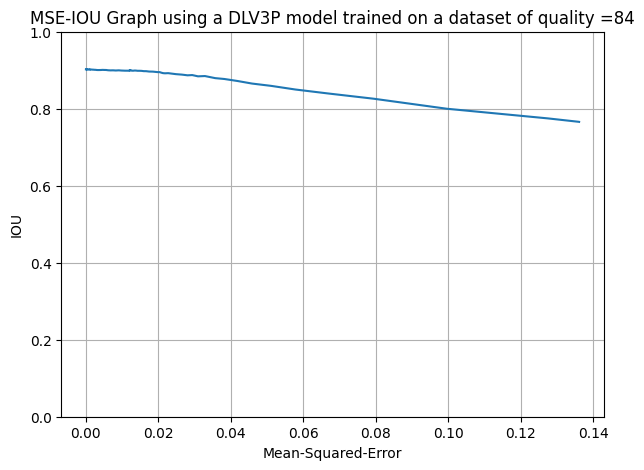

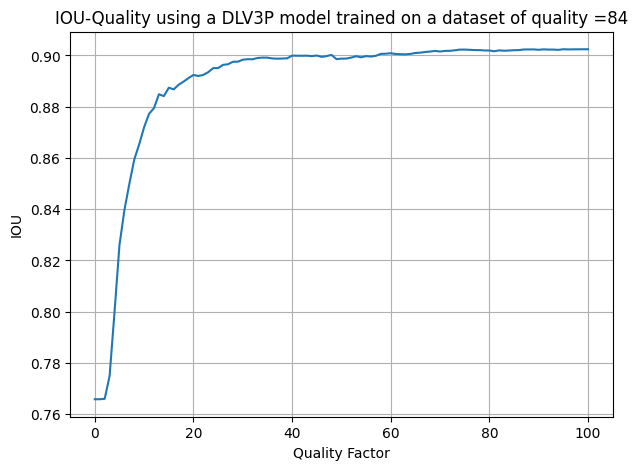

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.05391, iou_score - 0.9023]
DLV3P model trained on dataset of quality= 84 
test on uncompressed dataset
Evaluation Loss: 0.05391297737757363
Evaluation IoU: 0.902342118468939
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.1386, iou_score - 0.7719]
Evaluation Loss: 0.1386144207973106
Evaluation IoU: 0.7718678058362474
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,

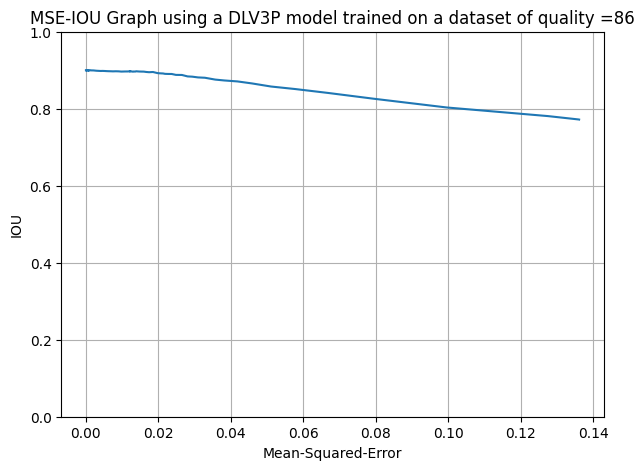

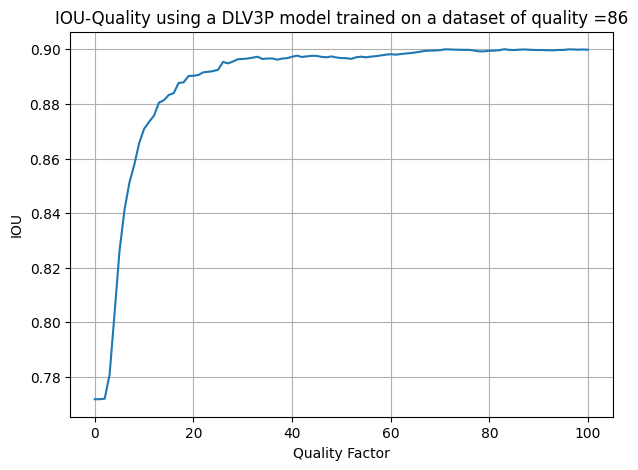

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.65it/s, dice_loss - 0.05513, iou_score - 0.8998]
DLV3P model trained on dataset of quality= 86 
test on uncompressed dataset
Evaluation Loss: 0.055127210476819205
Evaluation IoU: 0.8997604835267162
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.1426, iou_score - 0.7662]
Evaluation Loss: 0.14264741832134775
Evaluation IoU: 0.7662065864778032
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:

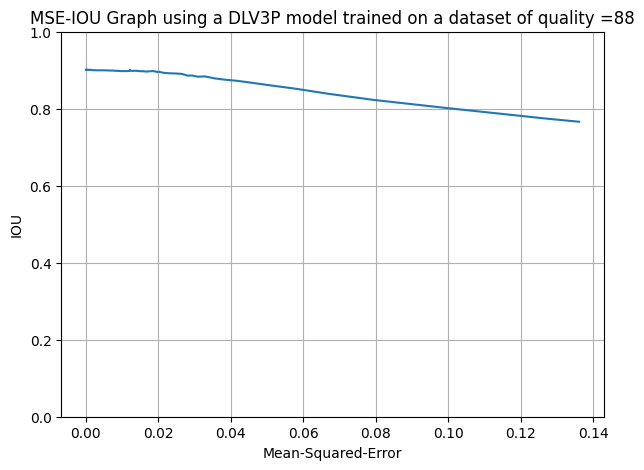

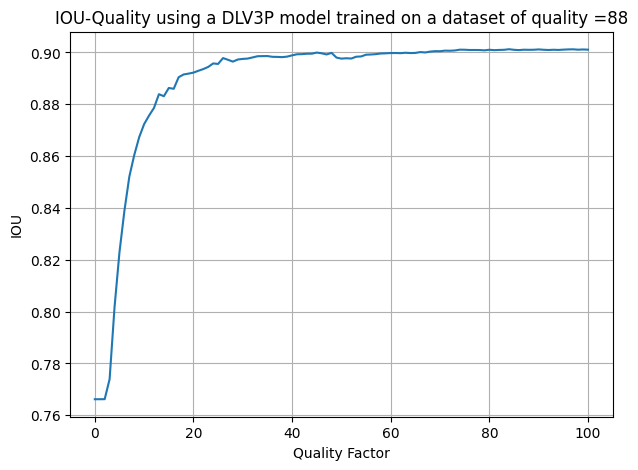

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.72it/s, dice_loss - 0.05426, iou_score - 0.9011]
DLV3P model trained on dataset of quality= 88 
test on uncompressed dataset
Evaluation Loss: 0.054264457786784445
Evaluation IoU: 0.9010541252061433
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.80it/s, dice_loss - 0.1427, iou_score - 0.7662]
Evaluation Loss: 0.14265945962831084
Evaluation IoU: 0.7661722968606391
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:

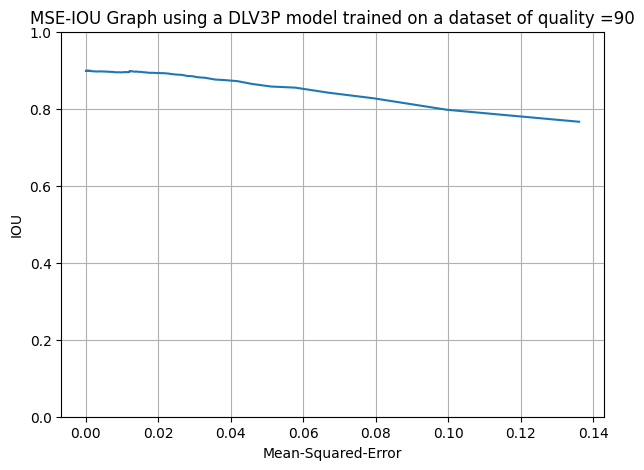

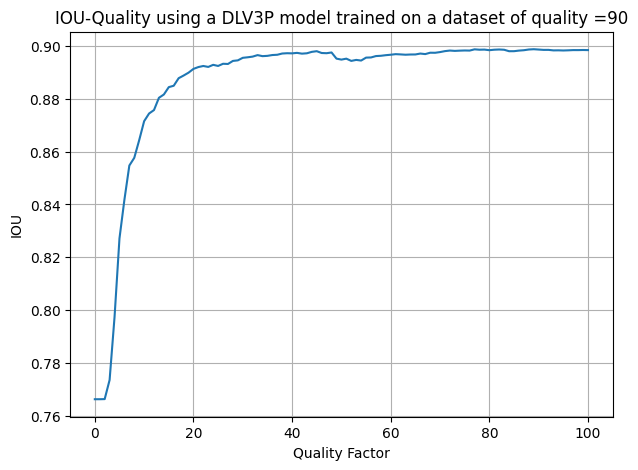

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.67it/s, dice_loss - 0.05599, iou_score - 0.8984]
DLV3P model trained on dataset of quality= 90 
test on uncompressed dataset
Evaluation Loss: 0.05599470699534697
Evaluation IoU: 0.8984014637330001
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:14<00:00,  3.56it/s, dice_loss - 0.1357, iou_score - 0.7754]
Evaluation Loss: 0.13573919324313902
Evaluation IoU: 0.7754497913753287
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:0

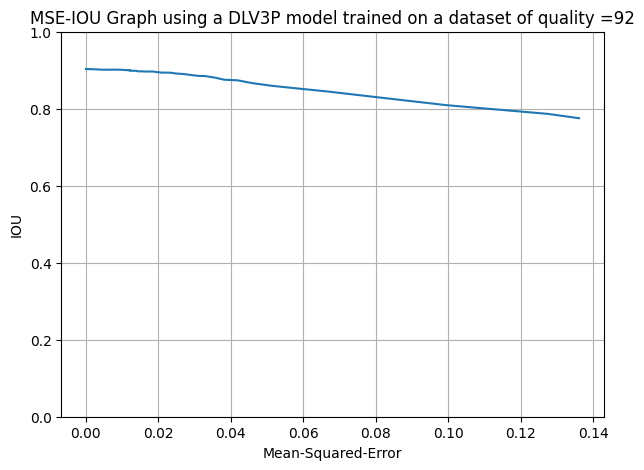

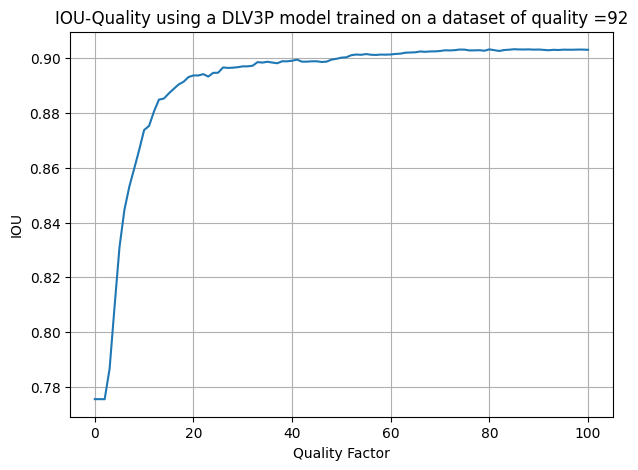

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.69it/s, dice_loss - 0.05326, iou_score - 0.9032]
DLV3P model trained on dataset of quality= 92 
test on uncompressed dataset
Evaluation Loss: 0.053262373980353855
Evaluation IoU: 0.903195855664272
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.1378, iou_score - 0.7732]
Evaluation Loss: 0.1377720154967963
Evaluation IoU: 0.7732439146322362
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

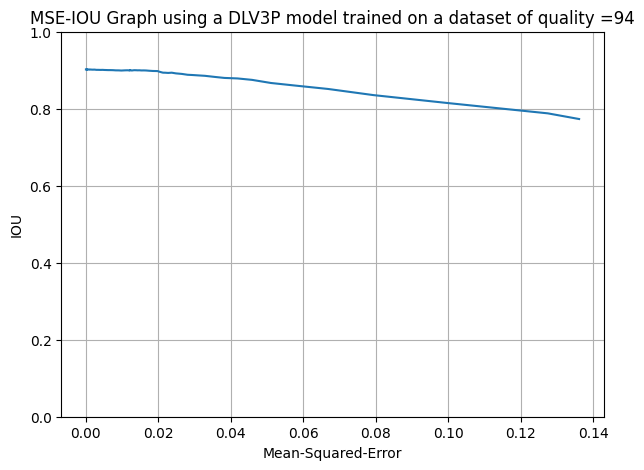

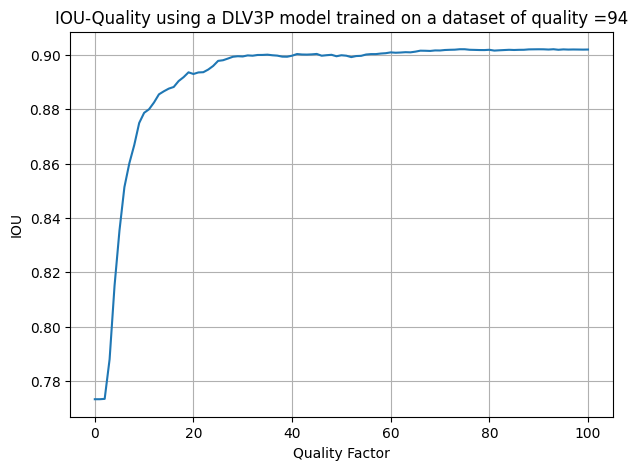

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:20<00:00,  2.50it/s, dice_loss - 0.05386, iou_score - 0.9021]
DLV3P model trained on dataset of quality= 94 
test on uncompressed dataset
Evaluation Loss: 0.05385839939117432
Evaluation IoU: 0.9020753315850798
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:19<00:00,  2.68it/s, dice_loss - 0.1386, iou_score - 0.7718]
Evaluation Loss: 0.1386077976694294
Evaluation IoU: 0.7717600792062048
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:18<00:00

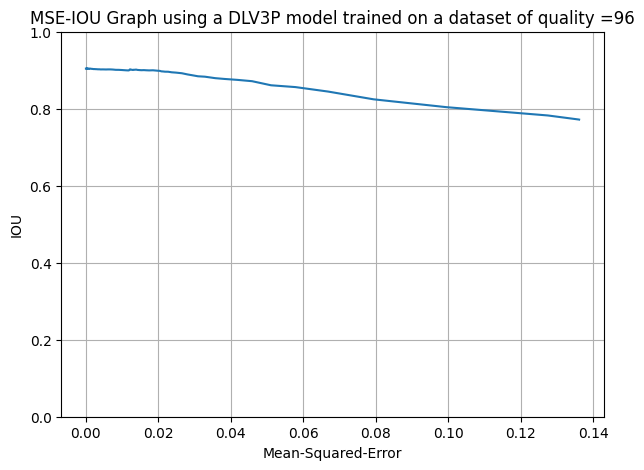

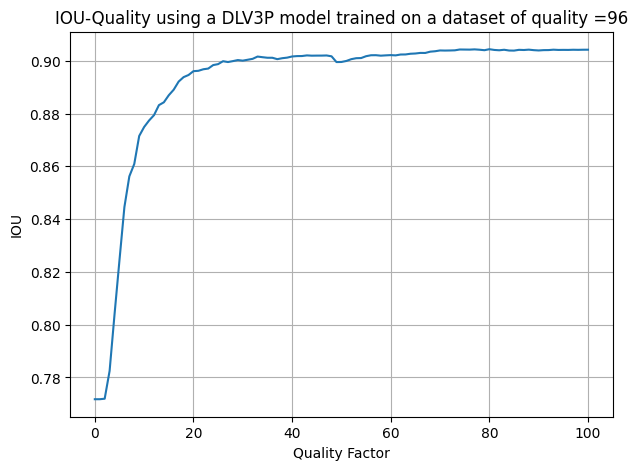

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:18<00:00,  2.71it/s, dice_loss - 0.05255, iou_score - 0.9043]
DLV3P model trained on dataset of quality= 96 
test on uncompressed dataset
Evaluation Loss: 0.05254586537679036
Evaluation IoU: 0.904272031550314
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:18<00:00,  2.82it/s, dice_loss - 0.1483, iou_score - 0.759] 
Evaluation Loss: 0.14834036312851248
Evaluation IoU: 0.7590051375183406
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:20<00:00

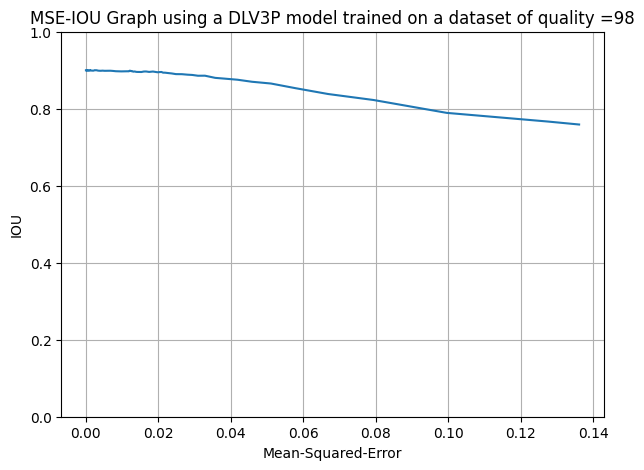

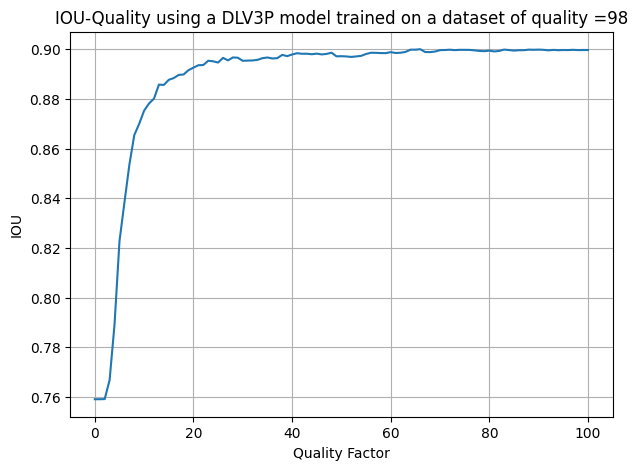

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:13<00:00,  3.81it/s, dice_loss - 0.05682, iou_score - 0.8998]
DLV3P model trained on dataset of quality= 98 
test on uncompressed dataset
Evaluation Loss: 0.05682028274910124
Evaluation IoU: 0.8997918519319273
excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\0
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00,  3.80it/s, dice_loss - 0.1404, iou_score - 0.7688]
Evaluation Loss: 0.14044640344731954
Evaluation IoU: 0.768756625699062
excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 images from excavator_dataset_w_masks2\dataset\TestCompressed\1
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
MSE:  0.1360763
valid: 100%|██████████| 51/51 [00:13<00:00

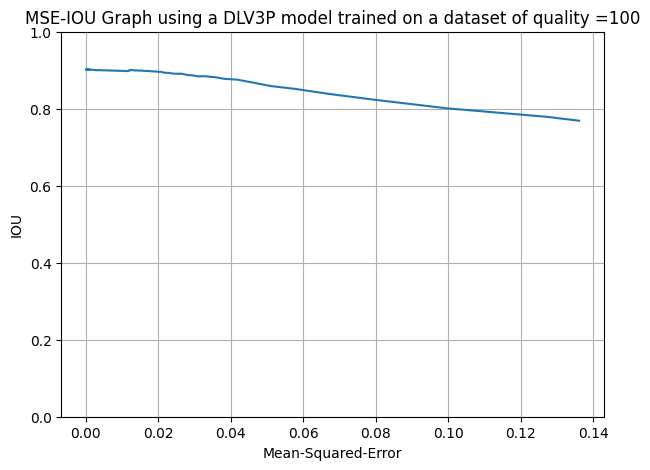

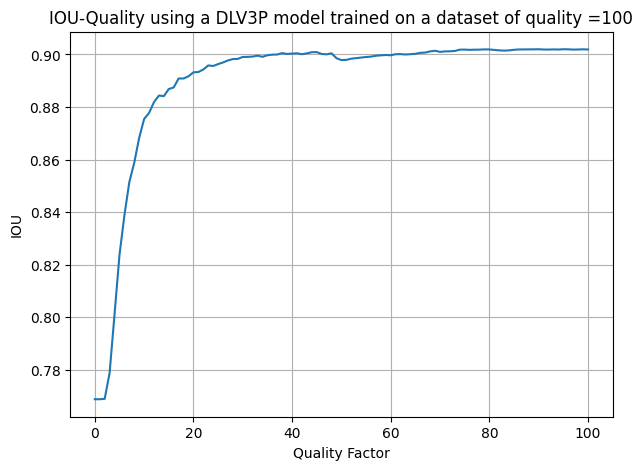

Loaded 51 images from excavator_dataset_w_masks2\dataset\Test\
Loaded 51 masks from excavator_dataset_w_masks2\dataset\Testannot\
valid: 100%|██████████| 51/51 [00:23<00:00,  2.19it/s, dice_loss - 0.05422, iou_score - 0.9018]
DLV3P model trained on dataset of quality= 100 
test on uncompressed dataset
Evaluation Loss: 0.054215112153221584
Evaluation IoU: 0.9017971929381875


In [30]:
test_DLV3P()

**Further Processing**

*DLV3*

In [3]:
import statistics
q = []
for i in range(0,101,2):
    q.append(i)
DLV3_uncomp_res = [0.8300894492981482, 0.8762721524519079, 0.8811113927878584, 0.898972159507228, 0.8897402602083542, 0.9003049964998281, 0.9022508310336693, 0.9038624716740027, 0.8970502100738822, 0.897736421987122, 0.9048560320162304, 0.9054151679955278, 0.9072354833285013, 0.9013614993469388, 0.9017656936365017, 0.9120122439721052, 0.9066827472518472, 0.9017927623262592, 0.904326535907446, 0.9076081561107262, 0.9049851298332214, 0.9035382165628321, 0.9106030113556804, 0.9050103577913023,0.8978629392736099, 0.9048914804178124, 0.9031434140953364, 0.9100766742930693, 0.9079617425507189, 0.9081633067598525, 0.9094225320161557, 0.9020944483139939, 0.9029726830183291, 0.903540945520588, 0.905523459116618, 0.9005972333982876, 0.8990189666841542, 0.8970590479233684, 0.9009653329849244,0.9047652716730155,0.9038800947806415,0.9049816295212391, 0.9010394180522246, 0.9026547167815413,0.9064837051372904, 0.8985048181870403, 0.9002438059040144, 0.9028246145622402, 0.9046074935034208, 0.9072107532445122, 0.9026266254630744]
DLV3_q_crit = [0,8,7,10,8,10,10,10,14,10,10,9,8,14,10,10,15,16,17,15,18,10,14,14,17,18,18,18,14,15,20,19,18,14,12,21,18,18,18,15,17,18,18,17,17,16,19,17,20,22,17]
DLV3_IOU_pre = [0, 0.015, 0.02, 0.055, 0.06, 0.065, 0.105, 0.1, 0.1, 0.11, 0.1, 0.11, 0.12, 0.11, 0.105, 0.13,0.13, 0.12, 0.12, 0.115, 0.12, 0.1, 0.135, 0.12, 0.115, 0.11, 0.13, 0.12, 0.11, 0.13,0.125, 0.13, 0.135, 0.12, 0.13, 0.13,0.13, 0.13, 0.13, 0.13, 0.13, 0.13, 0.135, 0.13, 0.135, 0.13, 0.125, 0.135, 0.135, 0.14, 0.13]
DLV3_IOU_post = [0, 0, 0, 0.005, 0.01, 0.005, 0.01, 0.02, 0, 0.01, 0.02, 0.02, 0.015, 0.01, 0.015, 0.015, 0.01, 0.005, 0.015, 0.015, 0.01, 0.02, 0.015, 0.01, 0.01, 0.005, 0.005, 0.01, 0.02, 0.02, 0.005, 0.01,0.01, 0.02, 0.015, 0.01, 0.01, 0.0075, 0.01, 0.015, 0.02, 0.01, 0.005, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.005, 0.01]
print(statistics.stdev(DLV3_uncomp_res))
print(statistics.mean(DLV3_q_crit), statistics.stdev(DLV3_q_crit), statistics.mean(DLV3_uncomp_res), statistics.mean(DLV3_IOU_pre), statistics.mean(DLV3_IOU_post))

0.011904469302419176
14.470588235294118 4.437805499011739 0.9009353046300822 0.11225490196078432 0.010735294117647058


plot results

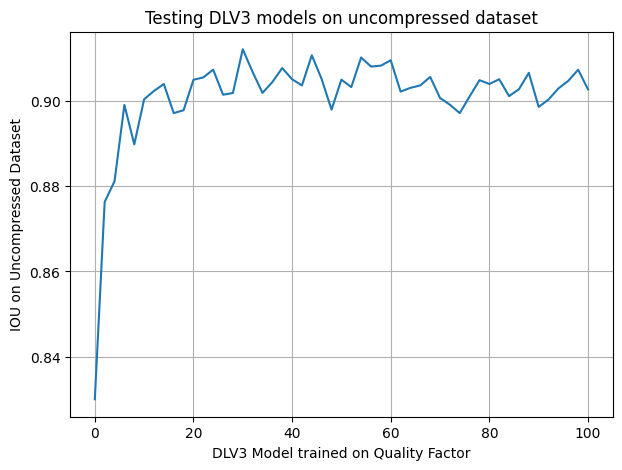

In [30]:
# plot quality over IOU
base_save_dir = "{}{}{}".format("Results", os.sep, "DLV3")
x1 = q # quality VALUES
y1 = DLV3_uncomp_res # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x1,  y1)  
plt.xlabel('DLV3 Model trained on Quality Factor')
plt.ylabel('IOU on Uncompressed Dataset')
plt.title(f'Testing DLV3 models on uncompressed dataset')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3_IOU_on_uncomp_dataset.png'))
plt.show()

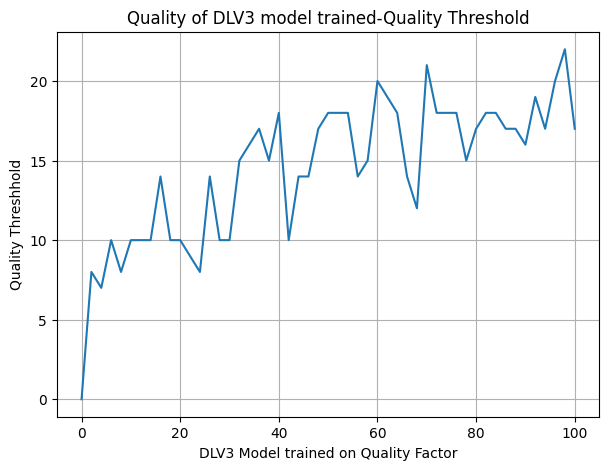

In [31]:
x0 = q # quality VALUES
y0 = DLV3_q_crit # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x0,  y0)  
plt.xlabel('DLV3 Model trained on Quality Factor')
plt.ylabel('Quality Threshhold')
plt.title(f'Quality of DLV3 model trained-Quality Threshold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3_q_threshhold.png'))
plt.show()

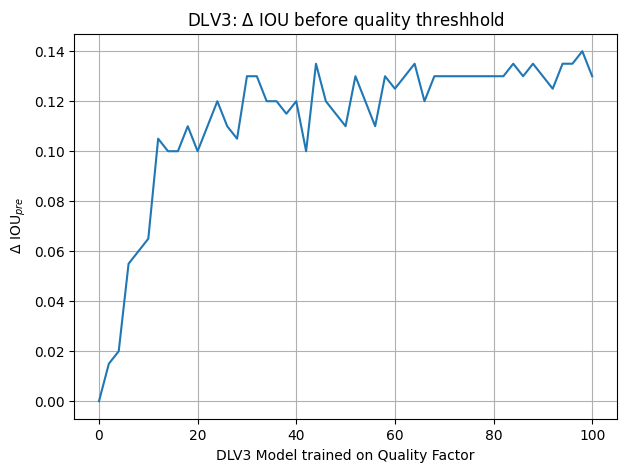

In [32]:
x2 = q # quality VALUES
y2 = DLV3_IOU_pre # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x2,  y2)  
plt.xlabel('DLV3 Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{pre}$')
plt.title(f'DLV3: $\Delta$ IOU before quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3_delta_IOU_pre.png'))
plt.show()

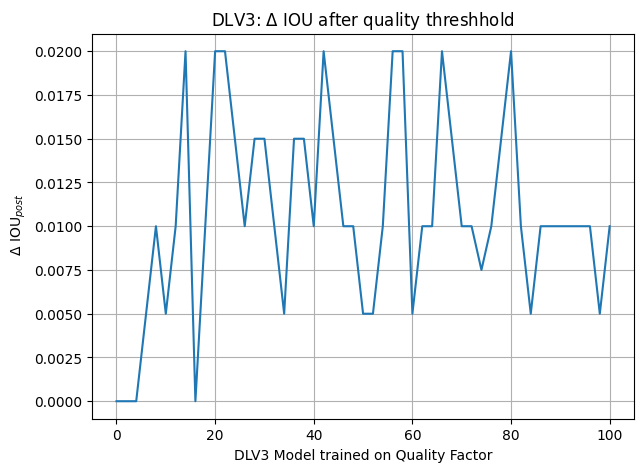

In [33]:
x3 = q # quality VALUES
y3 = DLV3_IOU_post # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x3,  y3)  
plt.xlabel('DLV3 Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{post}$')
plt.title(f'DLV3: $\Delta$ IOU after quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3_delta_IOU_post.png'))
plt.show()

In [5]:
def create_normal_distribution (mean,std):
    x = np.linspace(mean - 4*std, mean + 4*std, 1000)

    # Calculate the Gaussian (Normal) distribution for each x value
    y = (1 / (std * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mean) / std) ** 2)
    return x,y

DLV3: 
std:  4.437805499011739 
mean:  14.470588235294118


NameError: name 'base_save_dir' is not defined

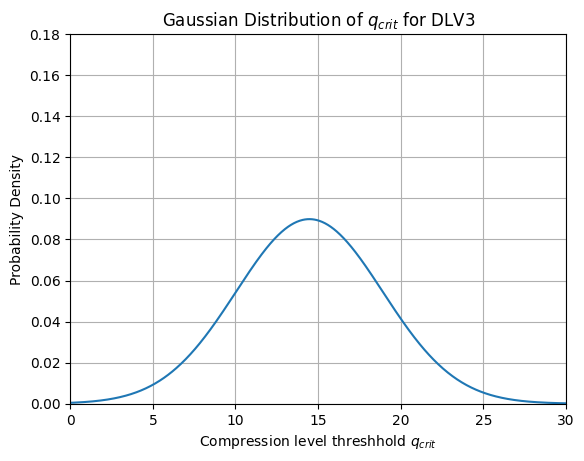

In [8]:
DLV3_mean = statistics.mean(DLV3_q_crit)
DLV3_std = statistics.stdev(DLV3_q_crit)
print("DLV3: \nstd: ", DLV3_std, "\nmean: ", DLV3_mean)
x4, y4 = create_normal_distribution(DLV3_mean, DLV3_std)
# Plot the Gaussian curve
plt.plot(x4, y4)
plt.title('Gaussian Distribution of $q_{crit}$ for DLV3')
plt.xlabel('Compression level threshhold $q_{crit}$')
plt.ylabel('Probability Density')
plt.grid(True)
plt.xlim(0,30)
plt.ylim(0, 0.18)
plt.savefig(os.path.join(base_save_dir, 'DLV3_q_threshhold_gaussian.png'))
plt.show()

*UNET*

In [9]:
q = []
for i in range (0,101, 2):
    q.append(i)
print(q)

[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66, 68, 70, 72, 74, 76, 78, 80, 82, 84, 86, 88, 90, 92, 94, 96, 98, 100]


In [10]:
UNET_uncomp_res = [0.8736871001767181, 0.8983676468624789, 0.8974945954248017, 0.9043271822087906, 0.9011958755698857, 0.8981674640786413, 0.9014403364237615, 0.9000985365287929, 0.9028996310982048, 0.8932734342182385, 0.898876548982134, 0.9040203924272576, 0.8983956084531897, 0.8994515842082453, 0.9043489332292592, 0.9005005020721285, 0.898041508945764, 0.8996372117715721, 0.9030175910276523, 0.9003541598133015, 0.9042480587959291, 0.9034553649378757, 0.9016782536226161, 0.9077377892008014, 0.9007156175725605, 0.9023752656637452, 0.9017038532331876, 0.909419212855545, 0.9005033549140483, 0.8979952417167963, 0.9015808993694828, 0.9070355693499245, 0.9054896702953413, 0.9066613678838692, 0.9045337684014265, 0.9025671774265811, 0.8996609274078821,0.9026069582677356, 0.9064389268557231, 0.9005831772205877, 0.8984245073561573, 0.8908108916937136, 0.9057059849009794, 0.9034075211076174, 0.899950407299341, 0.9060406754998599, 0.9012392899569345, 0.8991376839432064, 0.8986253761777692, 0.9039348504122564, 0.8962427646506068]
UNET_q_crit = [22, 16, 15, 18, 17, 16, 20, 19, 15, 19, 17, 17, 25, 18, 16, 14, 18, 20, 17, 22, 16, 18,17, 22, 17, 13, 17, 18, 16, 15, 18, 16, 17, 16, 20, 17, 20, 18, 22, 18, 17, 18, 21, 19, 16, 18, 16, 18, 17, 18, 20]
UNET_IOU_pre = [0.1, 0.13, 0.125, 0.135, 0.13, 0.12, 0.12, 0.13, 0.12, 0.125, 0.13, 0.13, 0.14, 0.13, 0.13, 0.125, 0.12, 0.13, 0.12, 0.12, 0.12, 0.13, 0.13, 0.135, 0.13, 0.115, 0.125, 0.14, 0.13, 0.12, 0.13, 0.135, 0.13, 0.14, 0.115, 0.13, 0.125, 0.13, 0.13, 0.12, 0.12, 0.1175, 0.135, 0.125, 0.13, 0.14, 0.13, 0.13, 0.13, 0.125, 0.13]
UNET_IOU_post = [0.005, 0.01, 0.015, 0.005, 0.01, 0.01, 0.01, 0.01, 0.01, 0, 0.01, 0.01, 0, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.005, 0.01, 0.01, 0.02, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.015, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.0075, 0.005, 0.01, 0.01, 0.0075, 0.01, 0.01, 0.01, 0.01, 0.01]
print(statistics.stdev(UNET_uncomp_res))
print(statistics.mean(UNET_q_crit), statistics.stdev(UNET_q_crit), statistics.mean(UNET_uncomp_res), statistics.mean(UNET_IOU_pre), statistics.mean(UNET_IOU_post))

0.0052655340663666835
17.84313725490196 2.274841084731923 0.9009432598335474 0.1271078431372549 0.009509803921568628


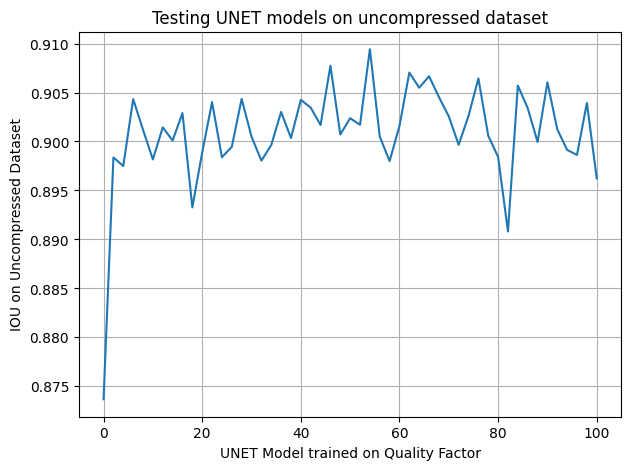

In [38]:
# plot quality over IOU
base_save_dir = "{}{}{}".format("Results", os.sep, "UNET")
x1 = q # quality VALUES
y1 = UNET_uncomp_res # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x1,  y1)  
plt.xlabel('UNET Model trained on Quality Factor')
plt.ylabel('IOU on Uncompressed Dataset')
plt.title(f'Testing UNET models on uncompressed dataset')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'UNET_IOU_on_uncomp_dataset.png'))
plt.show()

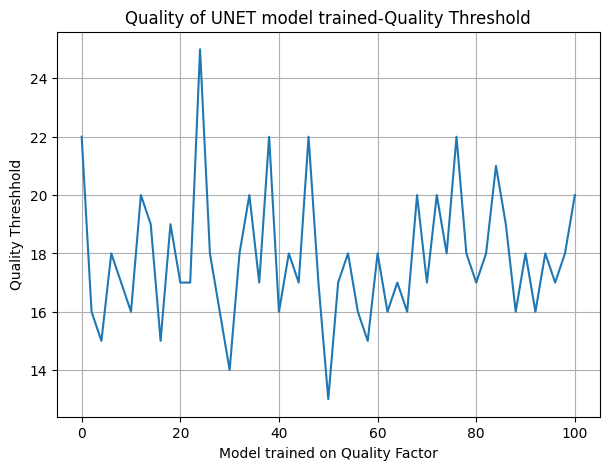

In [39]:
x0 = q # quality VALUES
y0 = UNET_q_crit # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x0,  y0)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel('Quality Threshhold')
plt.title(f'Quality of UNET model trained-Quality Threshold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'UNET_q_threshhold.png'))
plt.show()

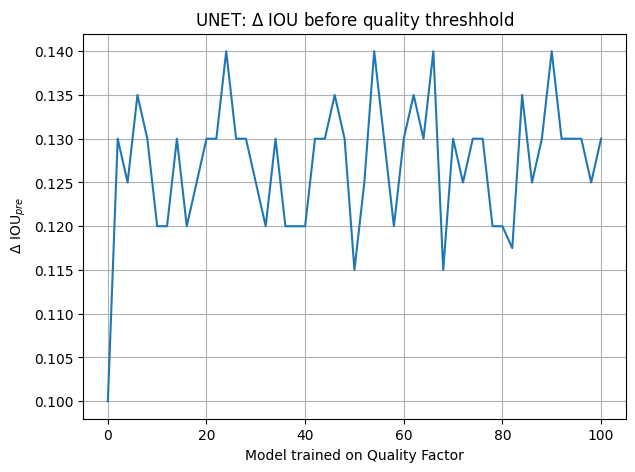

In [40]:
x2 = q # quality VALUES
y2 = UNET_IOU_pre # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x2,  y2)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{pre}$')
plt.title(f'UNET: $\Delta$ IOU before quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'UNET_delta_IOU_pre.png'))
plt.show()

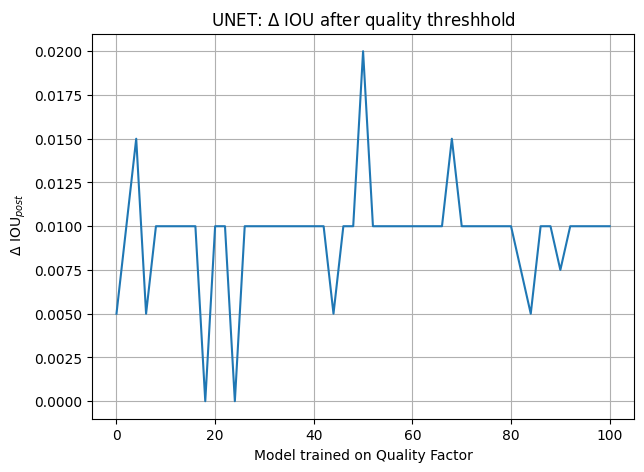

In [41]:
x3 = q # quality VALUES
y3 = UNET_IOU_post # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x3,  y3)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{post}$')
plt.title(f'UNET: $\Delta$ IOU after quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'UNET_delta_IOU_post.png'))
plt.show()

UNET: 
std:  2.274841084731923 
mean:  17.84313725490196


NameError: name 'base_save_dir' is not defined

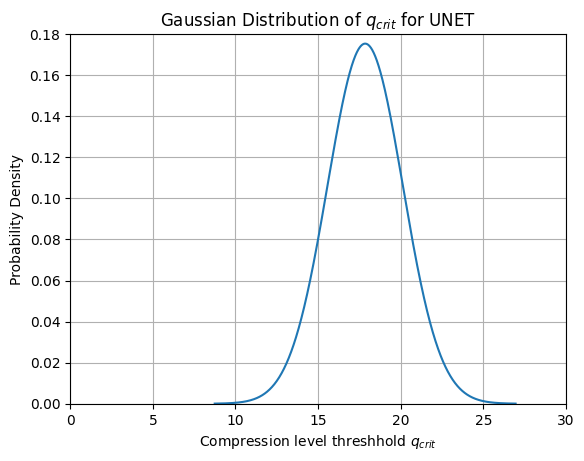

In [11]:
UNET_mean = statistics.mean(UNET_q_crit)
UNET_std = statistics.stdev(UNET_q_crit)
print("UNET: \nstd: ", UNET_std, "\nmean: ", UNET_mean)
x4, y4 = create_normal_distribution(UNET_mean, UNET_std)
# Plot the Gaussian curve
plt.plot(x4, y4)
plt.title('Gaussian Distribution of $q_{crit}$ for UNET')
plt.xlabel('Compression level threshhold $q_{crit}$')
plt.ylabel('Probability Density')
plt.xlim(0,30)
plt.ylim(0, 0.18)
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'UNET_q_threshhold_gaussian.png'))
plt.show()

*DLV3P*

In [12]:
import statistics
DLV3P_uncomp_res = [0.88679812001247, 0.906424387997272, 0.9046180517065757, 0.9019142798348968, 0.9058979399064008, 0.9054951656098459, 0.9032995373594996, 0.9020976646273743, 0.9024690459756288, 0.9060111209457995, 0.8985158543960721, 0.8983350851956535, 0.9048900043263153, 0.8911388119061787, 0.906701752952501, 0.903572020577449, 0.9005814019371482, 0.9026407260520783, 0.8986882894646887, 0.9032471916254831, 0.9027803037680832, 0.8991886973381045, 0.9047563391573291, 0.9015889845642387, 0.9053379682933584, 0.8997725867757613, 0.9008799522530802, 0.904885271016289, 0.9109214065121668, 0.9020056572614932, 0.9014455711140354, 0.899443469795526, 0.9023377825232113, 0.9000241172079946, 0.9017908841955896, 0.9044849650532593, 0.9081083968573924, 0.9002292834076228, 0.899736254822974, 0.8983000551953032, 0.9007526788057064, 0.9043920671238618, 0.902342118468939, 0.8997604835267162, 0.9010541252061433, 0.8984014637330001, 0.903195855664272, 0.9020753315850798, 0.904272031550314, 0.8997918519319273, 0.9017971929381875]
DLV3P_q_crit = [10, 14, 10 ,12, 15, 14, 12, 12, 14, 15, 18, 14, 12, 14, 13, 12, 15, 16, 10 ,12, 14, 15, 14, 20, 17, 17, 15, 14, 12, 17, 18, 15, 16, 15, 20, 17, 17, 19, 18, 17, 18, 15, 16, 19, 17, 17, 19, 19, 20, 13, 17]
DLV3P_IOU_pre = [0.12, 0.13, 0.13, 0.12, 0.12, 0.13, 0.13, 0.13, 0.12, 0.12, 0.13, 0.11, 0.12, 0.1, 0.13, 0.14, 0.12, 0.13, 0.1, 0.12, 0.125, 0.12, 0.11, 0.13, 0.125, 0.12, 0.125, 0.12, 0.125, 0.125, 0.12, 0.13, 0.12, 0.125, 0.1275, 0.115, 0.13, 0.1275, 0.115, 0.12, 0.125, 0.12, 0.12, 0.115, 0.12, 0.12, 0.1175, 0.12, 0.125, 0.13, 0.12]
DLV3P_IOU_post =  [0.02, 0.02, 0.02, 0.01, 0.01, 0.02, 0.01, 0.01, 0.01, 0.02, 0.01, 0.02, 0.02, 0.02, 0.02, 0.02, 0.01, 0.01, 0.02, 0.02, 0.015, 0.01, 0.015, 0.01, 0.01, 0.01, 0.01, 0.015, 0.015, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.015, 0.01, 0.01, 0.01, 0.01, 0.01, 0.015, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01, 0.0125, 0.01]
print(statistics.mean(DLV3P_q_crit), statistics.stdev(DLV3P_q_crit), statistics.mean(DLV3P_uncomp_res), statistics.mean(DLV3P_IOU_pre), statistics.mean(DLV3P_IOU_post))
print(statistics.stdev(DLV3P_uncomp_res ))

15.313725490196079 2.6943659445474837 0.9019448941187508 0.12230392156862745 0.012990196078431373
0.003820662489917921


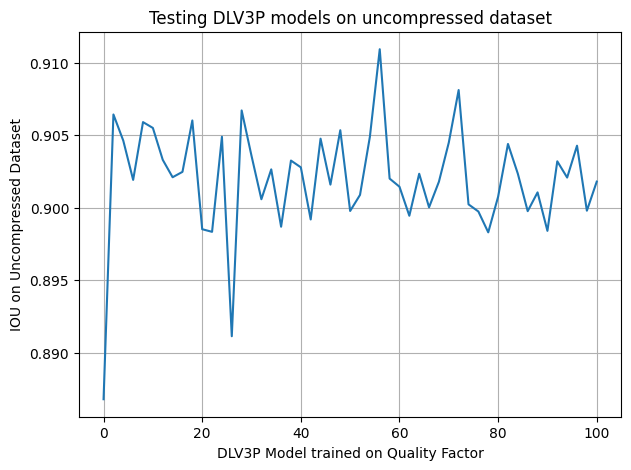

In [44]:
# plot quality over IOU
base_save_dir = "{}{}{}".format("Results", os.sep, "DLV3P")
x1 = q # quality VALUES
y1 = DLV3P_uncomp_res # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x1,  y1)  
plt.xlabel('DLV3P Model trained on Quality Factor')
plt.ylabel('IOU on Uncompressed Dataset')
plt.title(f'Testing DLV3P models on uncompressed dataset')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3P_IOU_on_uncomp_dataset.png'))
plt.show()

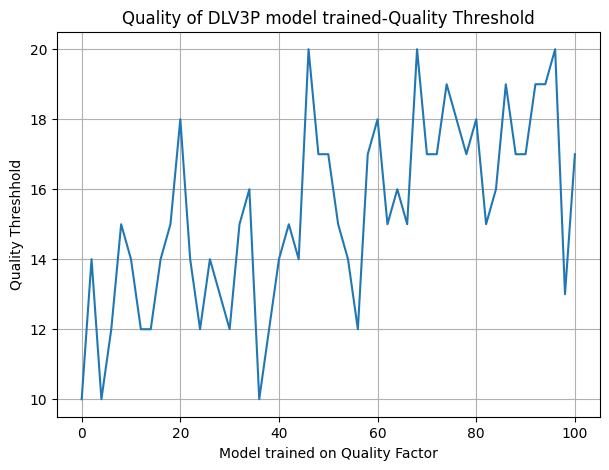

In [45]:
x0 = q # quality VALUES
y0 = DLV3P_q_crit # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x0,  y0)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel('Quality Threshhold')
plt.title(f'Quality of DLV3P model trained-Quality Threshold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3P_q_threshhold.png'))
plt.show()

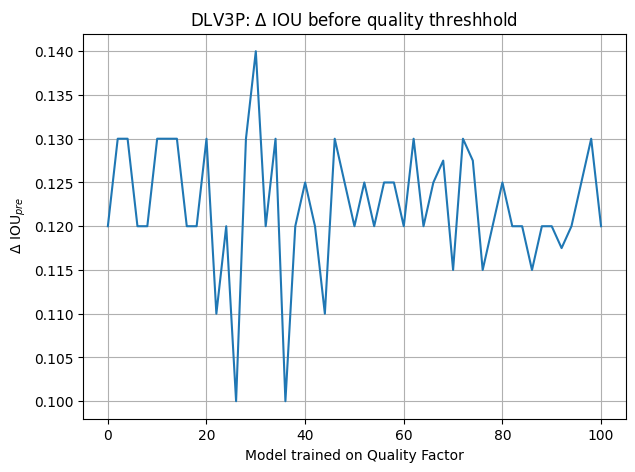

In [46]:
x2 = q # quality VALUES
y2 = DLV3P_IOU_pre # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x2,  y2)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{pre}$')
plt.title(f'DLV3P: $\Delta$ IOU before quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3P_delta_IOU_pre.png'))
plt.show()

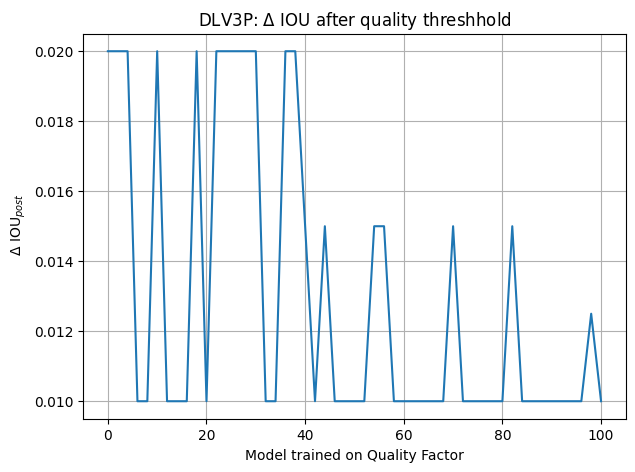

In [47]:
x3 = q # quality VALUES
y3 = DLV3P_IOU_post # IOU VALUES
plt.figure(figsize=(7, 5)) # Set the figure size
plt.plot(x3,  y3)  
plt.xlabel('Model trained on Quality Factor')
plt.ylabel(' $\Delta$ IOU$_{post}$')
plt.title(f'DLV3P: $\Delta$ IOU after quality threshhold')
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3P_delta_IOU_post.png'))
plt.show()

DLV3P: 
std:  2.6943659445474837 
mean:  15.313725490196079


NameError: name 'base_save_dir' is not defined

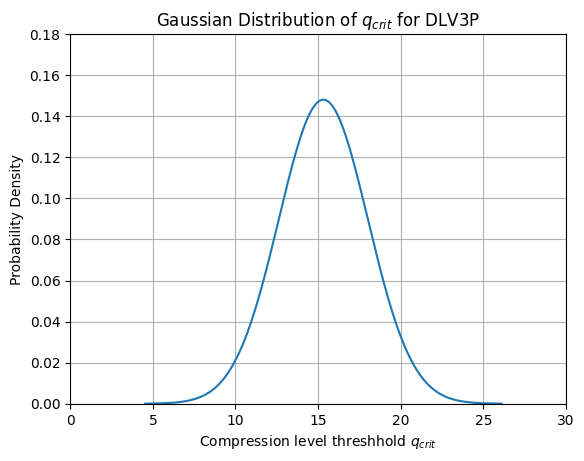

In [13]:
DLV3P_mean = statistics.mean(DLV3P_q_crit)
DLV3P_std = statistics.stdev(DLV3P_q_crit)
print("DLV3P: \nstd: ", DLV3P_std, "\nmean: ", DLV3P_mean)
x4, y4 = create_normal_distribution(DLV3P_mean, DLV3P_std)
# Plot the Gaussian curve
plt.plot(x4, y4)
plt.title('Gaussian Distribution of $q_{crit}$ for DLV3P')
plt.xlabel('Compression level threshhold $q_{crit}$')
plt.ylabel('Probability Density')
plt.xlim(0,30)
plt.ylim(0, 0.18)
plt.grid(True)
plt.savefig(os.path.join(base_save_dir, 'DLV3P_q_threshhold_gaussian.png'))
plt.show()

In [2]:
#Zip Results
# Define the paths
dataset_folder = 'Results'  
output_zip = 'Results.zip'  # The output zip file

# Create the zip file
shutil.make_archive(output_zip.replace('.zip', ''), 'zip', dataset_folder)

print(f"Dataset folder '{dataset_folder}' has been zipped successfully into '{output_zip}'.")

Dataset folder 'Results' has been zipped successfully into 'Results.zip'.
